# Master File

This notebook runs the GP backtest, NN-IV training and backtesting, SSVI backtesting and trinomial tree backtesting. Finally all results are compared.

#### Help on Importing files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from the "code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use the neural network while avoiding the training step.
- csv files in "Results" folder if you want to load Results presented in our paper.


In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import sklearn as skl

import sys
formerPath = sys.path
sys.path.append('./code/')
sys.path.append('./BS/')

import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import neuralNetwork


import importlib

# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

#### DAX Data

For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.
- "8_8_2001__filterdax.dat" for tikohnov local volatility.

In [ ]:
#Read csv files as dataFrames
workingFolder = "./data/09082001/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromCSV(workingFolder,
                                                                  "9_8_2001__filterdax")

#### From Dat files (DAX data)
For a day x you must load :
- "x.dat.modelparam.dat"
- "x.dat.impliedvol.dat"
- "x.dat.calibr.out.dat"
- "x.dat"

In [ ]:
workingFolder = "./data/09082001/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromDat(workingFolder,
                                                                  "9_8_2001__filterdax")

#### SPX Data

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

In [ ]:
importlib.reload(loadData)

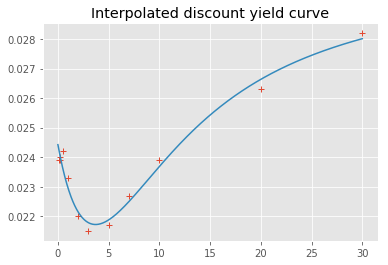

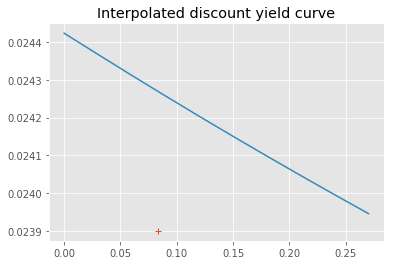

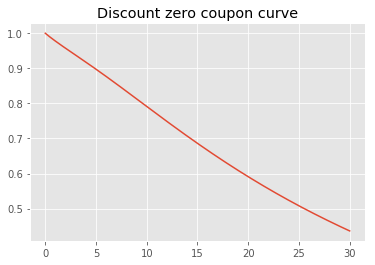

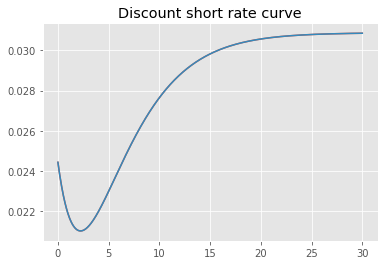

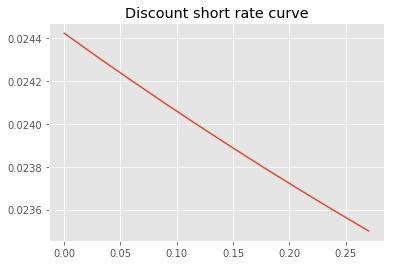

...

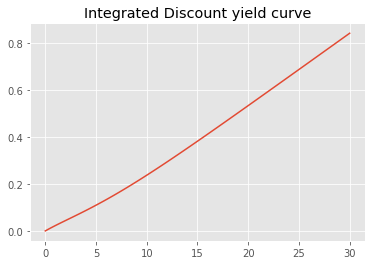

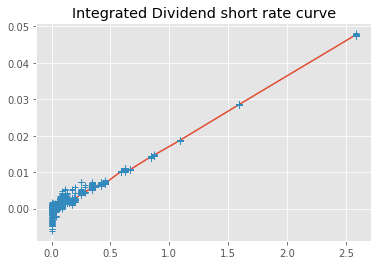

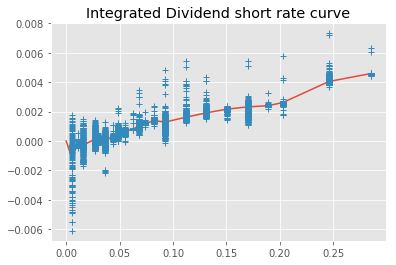

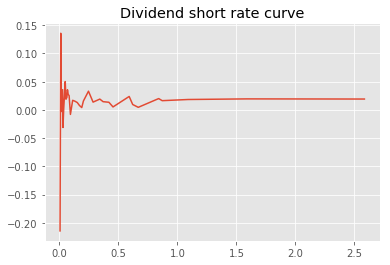

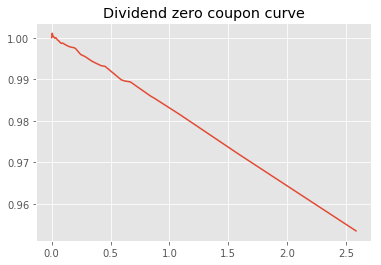

./code/bootstrapping.py:273: RuntimeWarning: invalid value encountered in double_scalars
  return (1 / x - 1) / float(t)


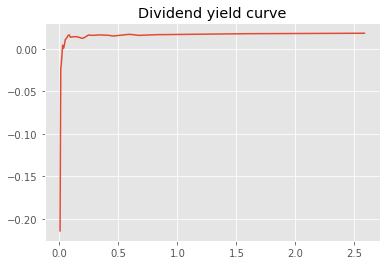

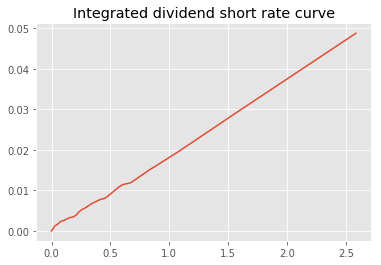

In [2]:
workingFolder = "./data/" #"./"
fileName = "Option_SPX_18_Mai_2019Feuille2.xlsm"
asOfDate = "2019-05-18"
trainingSet, testingSet, bootstrap, S0 = loadData.loadCBOTData(workingFolder, fileName, asOfDate)

In [3]:
trainingSet.shape

(652, 22)

In [4]:
testingSet.shape

(693, 22)

####  Eurostoxx data

File required : Data_EuroStoxx50_20190110_all_for_Marc.xlsx

In [ ]:
workingFolder = "./data/"
asOfDate = "2019-01-10"
filename = "Data_EuroStoxx50_20190110_all_for_Marc.xlsx"
trainingSet, testingSet, bootstrap, S0 = loadData.loadESXData(workingFolder, filename, asOfDate)

#### Load preformatted data

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

In [ ]:
workingFolder = "./"#"./data/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadFormattedData(workingFolder)

# Formatting data

### Boostsrapping Rate Curve

We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [5]:
dataSet = trainingSet #Training set
dataSetTest = testingSet #Testing set
dfCurve = dataSetConstruction.savingData(bootstrap, 
                                         dataSet, 
                                         dataSetTest, 
                                         workingFolder)
KMin, KMax, midS0, scaler, scaledDataSet, scaledDataSetTest = dataSetConstruction.minMaxScaling(dataSet, 
                                                                                                dataSetTest,
                                                                                                S0)
volLocaleGridDf = dataSetConstruction.generateOuterRectangleGrid(dataSet, dataSetTest, bootstrap, S0)
dataSet.head()

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


Price     Delta      Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                          
1000.0 0.170     0.050 -0.000211  0.938402      0.000813     -0.000003   
       0.370     0.175 -0.000615  3.745701      0.002435     -0.000007   
1100.0 0.170     0.050 -0.000224  0.992618      0.000780     -0.000003   
       0.285     0.125 -0.000502  2.725195      0.001783     -0.000006   
       0.370     0.250 -0.000912  5.381919      0.003289     -0.000009   

                    Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                              
1000.0 0.170     1.239901     999.299824        0.996616  1000.0     0.170   
       0.370     2.157528     998.376191        0.992868  1000.0     0.370   
1100.0 0.170     1.258404    1099.229807        0.996616  1100.0     0.170   
       0.285     2.010857    1098.737282        0.994362  1100.0     0.285   
       0.370     3.103638    1098.213810        0.992868  1100.0     0.370   

                 ...  OptionType  logMoneyness  impliedTotalVariance   Bid  \
Strike Maturity  ...                                                         
1000.0 0.170     ...        -1.0     -1.051358              0.097315  0.00   
       0.370     ...        -1.0     -1.052282              0.118281  0.10   
1100.0 0.170     ...        -1.0     -0.956048              0.080562  0.00   
       0.285     ...        -1.0     -0.956496              0.092987  0.05   
       0.370     ...        -1.0     -0.956972              0.104837  0.15   

                  Ask  ImpVolAsk  ImpVolBid  ImpVolCalibrated  locvol  \
Strike Maturity                                                         
1000.0 0.170     0.10   0.796031   0.200000          0.755993     1.0   
       0.370     0.25   0.582669   0.540193          0.565124     1.0   
1100.0 0.170     0.10   0.726428   0.200000          0.689701     1.0   
       0.285     0.20   0.594144   0.533003          0.571413     1.0   
       0.370     0.35   0.548453   0.509306          0.531997     1.0   

                 logMaturity  
Strike Maturity               
1000.0 0.170       -1.771957  
       0.370       -0.994252  
1100.0 0.170       -1.771957  
       0.285       -1.255266  
       0.370       -0.994252  

[5 rows x 22 columns]

## GP Backtesting
The purpose of this section is to load the GP local volatility surface and perform the Monte-Carlo backtest of the option prices uses the GP local volatility surface. Note that the GP local volatility is generated by running the Matlab code in the "code/GP" folder. See Section "GP Local Volatility Backtests" below for further details of the backtests.

### Load GP Results

This section loads result from the Matlab experiments.
See code/GP folder to access the matlab script.

In [ ]:
pathFolder = "./data/"
fileName = "GP_output_Put_Price_testing_set.xlsx"
putTestingGP, ImpVolPutTesting = loadData.loadGP(pathFolder, 
                                                 fileName, 
                                                 dataSetTest, 
                                                 S0, 
                                                 bootstrap)
fileName = "GP_output_Put_Price_training_set.xlsx"
putTrainingGP, ImpVolPutTraining = loadData.loadGP(pathFolder, 
                                                   fileName, 
                                                   dataSet, 
                                                   S0, 
                                                   bootstrap)
putTrainingGP.head()

#### Load GP local volatility

In [ ]:
workingFolder = "./data/volLocaleAresky/"
#filename = "local_vol_nx_10_nt_27.xlsx" RMSE :  10.073967351737087
#filename = "local_vol_nx_12_nt_27.xlsx" RMSE :  7.758802111118254
#filename = "local_vol_nx_15_nt_27.xlsx" RMSE :  6.252799135416868
#filename = "local_vol_nx_18_nt_27.xlsx" RMSE :  5.083806059940602
#filename = "local_vol_nx_20_nt_27.xlsx" RMSE :  5.050554384554841
#filename = "local_vol_nx_25_nt_27.xlsx" RMSE :  5.499835852015688
filename = "local_vol_nx_20_nt_27.xlsx"
locVolGP, volLocaleGridDf = loadData.loadGPLocVol(workingFolder, filename, bootstrap, S0, 
                                                  KMin, KMax, dataSet, dataSetTest)

plotTools.saveDataModel(plotTools.removeDuplicateIndex(putTrainingGP["GP_Put_price"]), 
                        plotTools.removeDuplicateIndex(nnGP(dataSet["Strike"], dataSet["Maturity"])), 
                        plotTools.removeDuplicateIndex(ImpVolPutTraining) , 
                        "./Results/GPTraining") 
plotTools.saveDataModel(plotTools.removeDuplicateIndex(putTestingGP["GP_Put_price"]), 
                        plotTools.removeDuplicateIndex(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"])), 
                        plotTools.removeDuplicateIndex(ImpVolPutTesting) , 
                        "./Results/GPTesting") 

locVolGP.head()

In [ ]:
nnGP = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolGP["LocalVolatility"], x, y)
plotTools.plotSerie(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]),
                    Title = 'Interpolated GP local volatility on testing nodes',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)
plotTools.plotSerie(nnGP(volLocaleGridDf["Strike"], volLocaleGridDf["Maturity"]),
                    Title = 'Interpolated GP local volatility on backtesting nodes',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

logMin = np.log(KMin/S0), 
logMax = 0.1 #np.log(KMax/S0),

plotTools.plotSerie(plotTools.convertToLogMoneyness(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]), S0),
                    Title = 'Interpolated GP local volatility on testing nodes',
                    az=30,
                    yMin=logMin,
                    yMax=logMax, 
                    zAsPercent=True)

 
plotTools.plot2Series(plotTools.convertToLogMoneyness(nnGP(dataSet["Strike"], dataSet["Maturity"]), S0), 
                      plotTools.convertToLogMoneyness(nnGP(dataSetTest["Strike"], dataSetTest["Maturity"]), S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'Interpolated Implied Vol Surface on testing nodes and training nodes')



#### GP Local Volatility Backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [ ]:
nbTimeStep = 100
nbPaths = 100000
nnGP = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolGP["LocalVolatility"], x, y)

In [ ]:
#MC Backtest
mcResGPTest = backtest.MonteCarloPricerVectorized(S0,
                                                  dataSetTest,
                                                  bootstrap,
                                                  nbPaths,
                                                  nbTimeStep,
                                                  nnGP)
mcResGPTest.to_csv(workingFolder + "mcResGPTest.csv")

plotTools.predictionDiagnosis(mcResGPTest["Price"], 
                              dataSetTest["Price"], 
                              " Monte Carlo Price ", 
                              yMin=KMin,
                              yMax=KMax)

plotTools.plotSerie(mcResGPTest["stdPrice"],
                    Title = 'GP backtested price std',
                    az=30,
                    yMin=KMin,
                    yMax=KMax, 
                    zAsPercent=True)

mcResGPTest.head()

In [ ]:
#PDE Backtest
pdeResSigmaGPTest = backtest.PDEPricerVectorized(dataSetTest, S0, nnGP, bootstrap)

plotTools.predictionDiagnosis(pdeResSigmaGPTest, 
                              dataSetTest["Price"], 
                              " PDE Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResSigmaGPTest.to_csv(workingFolder + "pdeResSigmaGPTest.csv")

pdeResSigmaGPTest.head()

# Neural Network

# Learning Implied volatility
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [6]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0#0.11#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 0#1.0#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 0#10.0#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.0#0.01
hyperparameters["lowerBoundGamma"] = 0.0#0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 200
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = True

In [7]:
importlib.reload(neuralNetwork)

<module 'neuralNetwork' from './code/neuralNetwork.py'>

In [8]:
scaledDataSet["logMaturity"].head()

Strike  Maturity
1000.0  0.170       0.564394
        0.370       0.688866
1100.0  0.170       0.564394
        0.285       0.647091
        0.370       0.688866
Name: logMaturity, dtype: float64

Iteration :  973 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 974): -4.61
Best Penalization :  [0.009902272, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Best loss (hidden nodes: 100, iterations: 10000): -5.40
Best Penalization :  [0.0045018406, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Training Time :  635.2466306686401


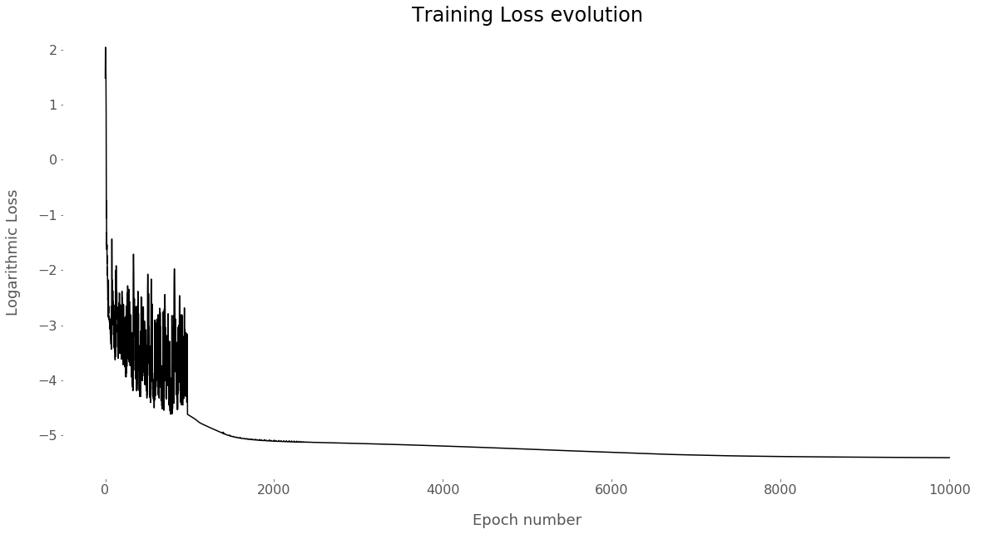

In [9]:
#Execute this cell if you want to fit neural network with implied volatilities
res = neuralNetwork.create_train_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                                dataSet,
                                                False,
                                                hyperparameters,
                                                scaler,
                                                modelName = "convexSoftGatheralVolModel")


y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

#Error plot
plotTools.plotEpochLoss(lossSerie4G)

Best loss (hidden nodes: 100, iterations: 0): -5.40
Best Penalization :  [0.0045018406, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[0.0, 0.0]]
Number of static arbitrage violations :  1
Arbitrable total variance :  Strike  Maturity
1875.0  0.036       0.017428
Name: Price, dtype: float32


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


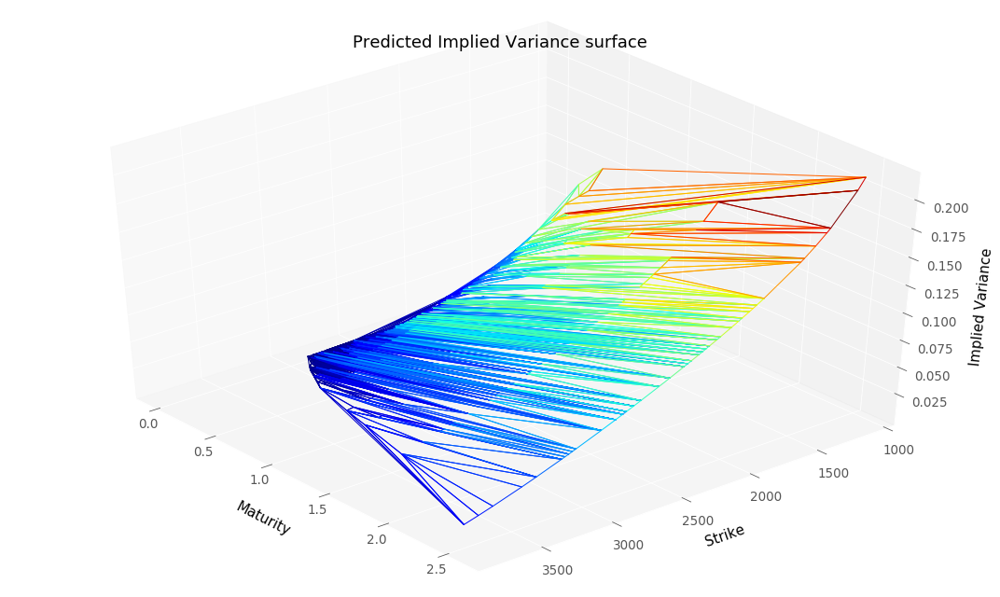

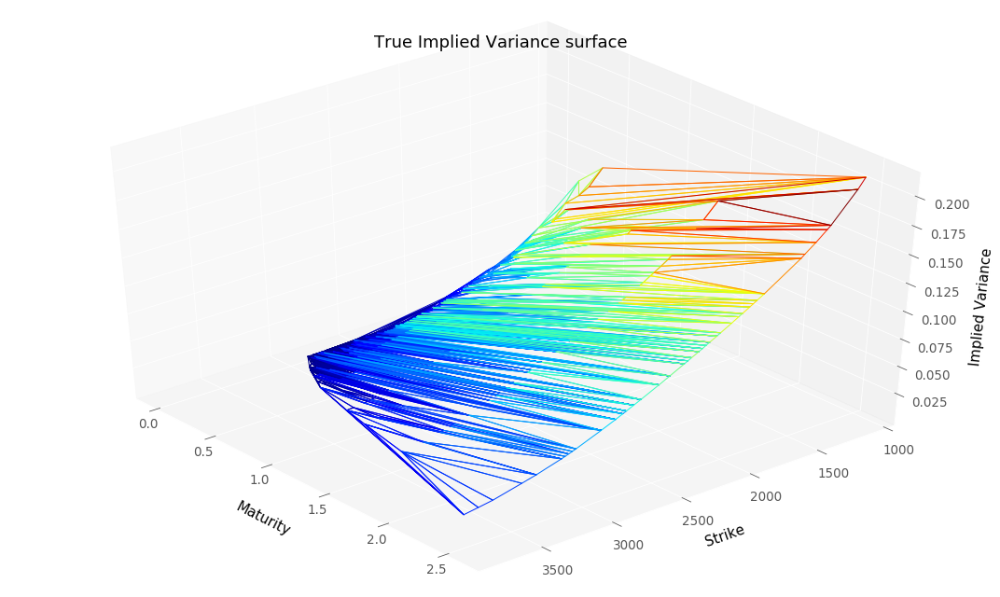

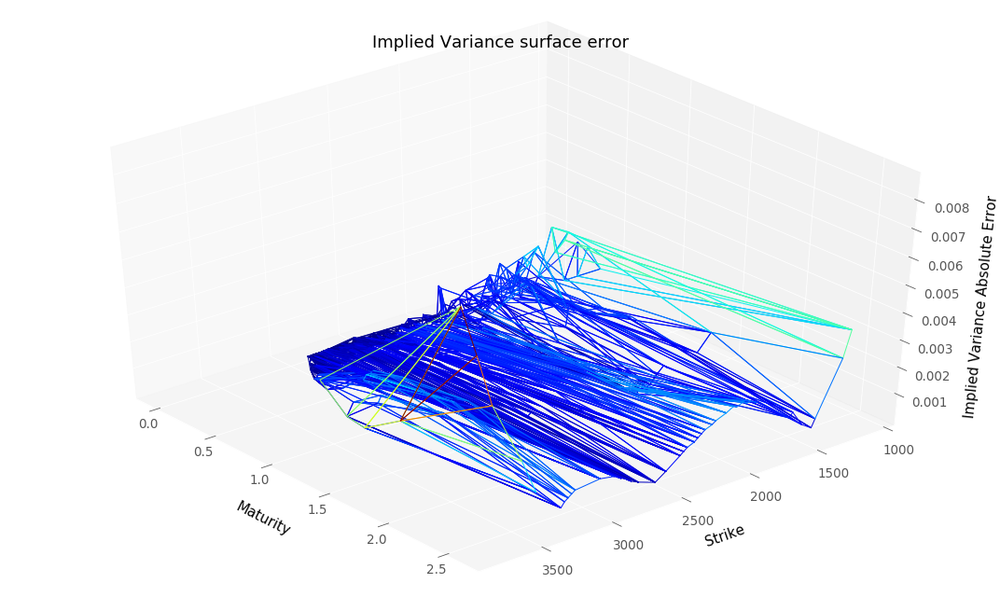

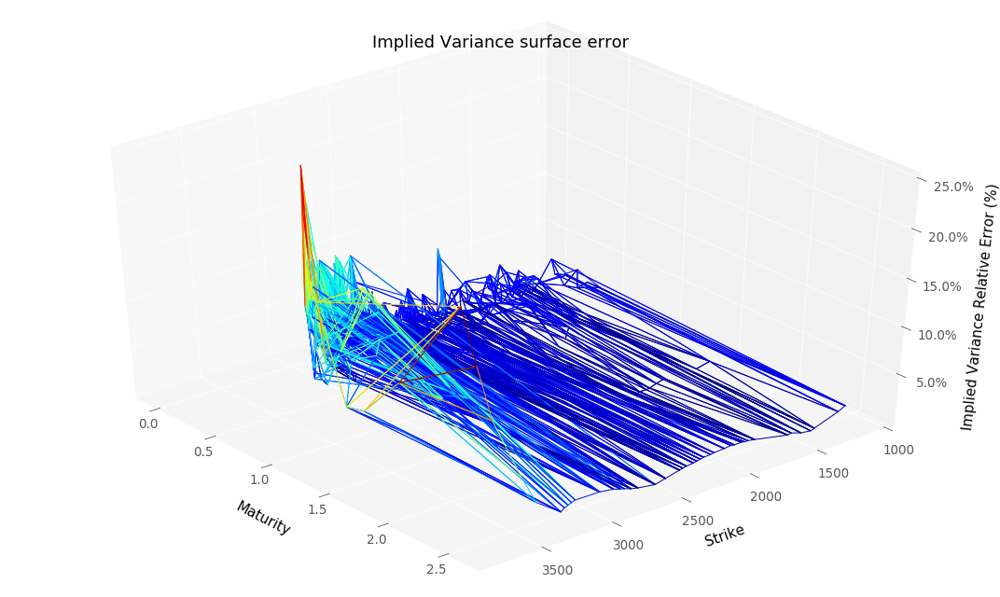

RMSE :  0.0008195914537520846
RMSE Relative:  0.04373054667759705


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


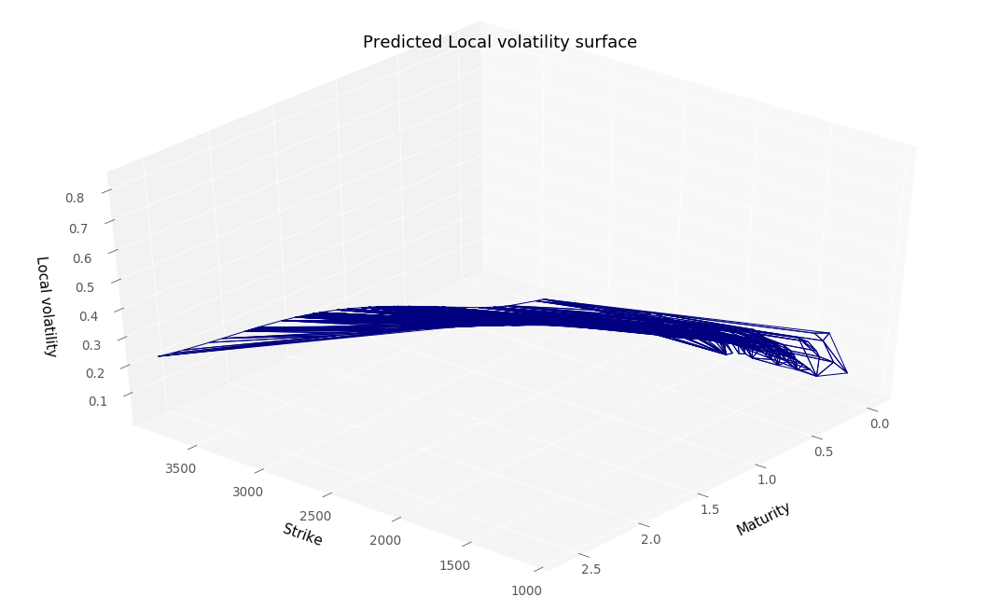

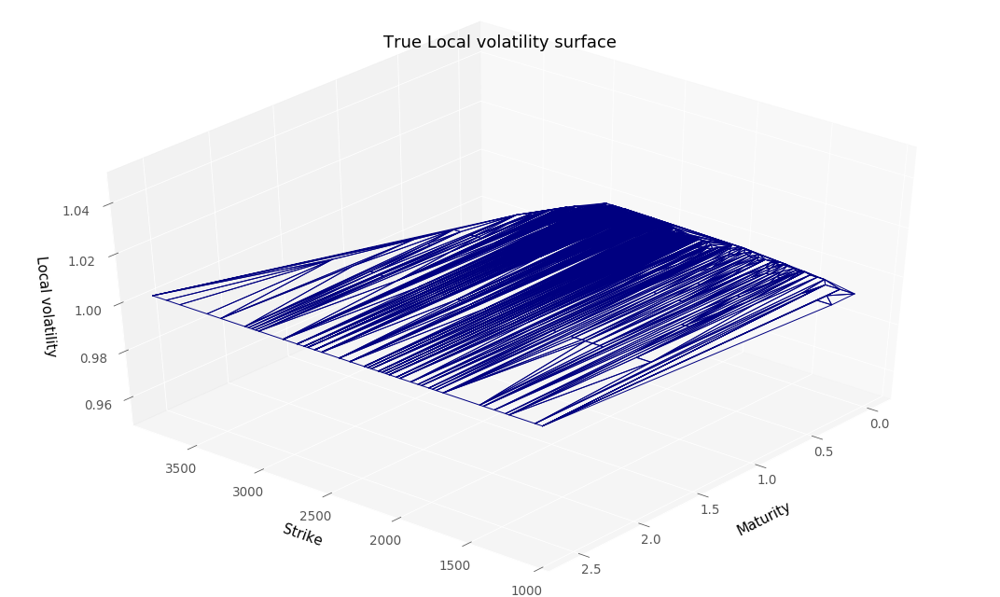

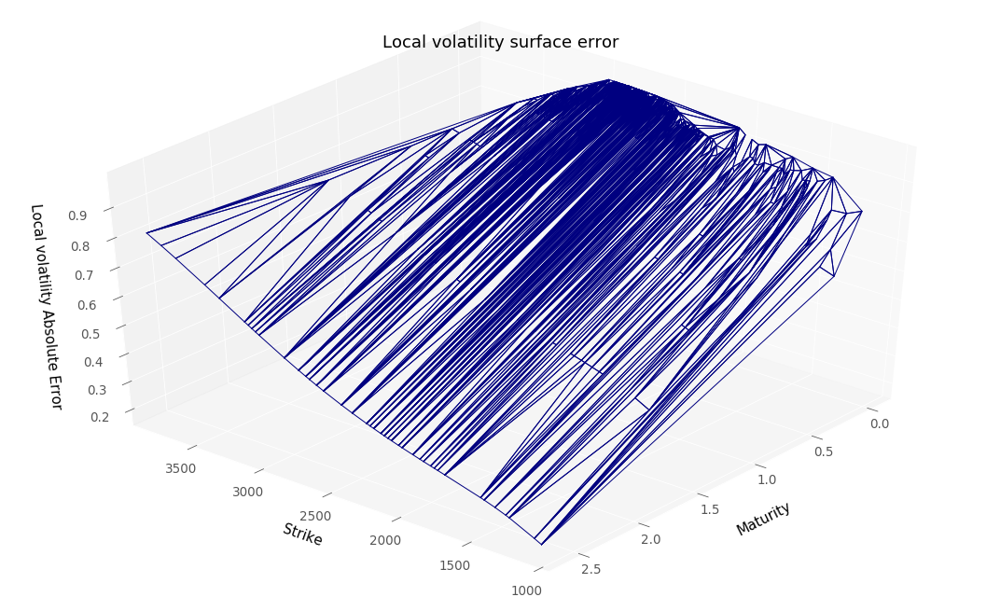

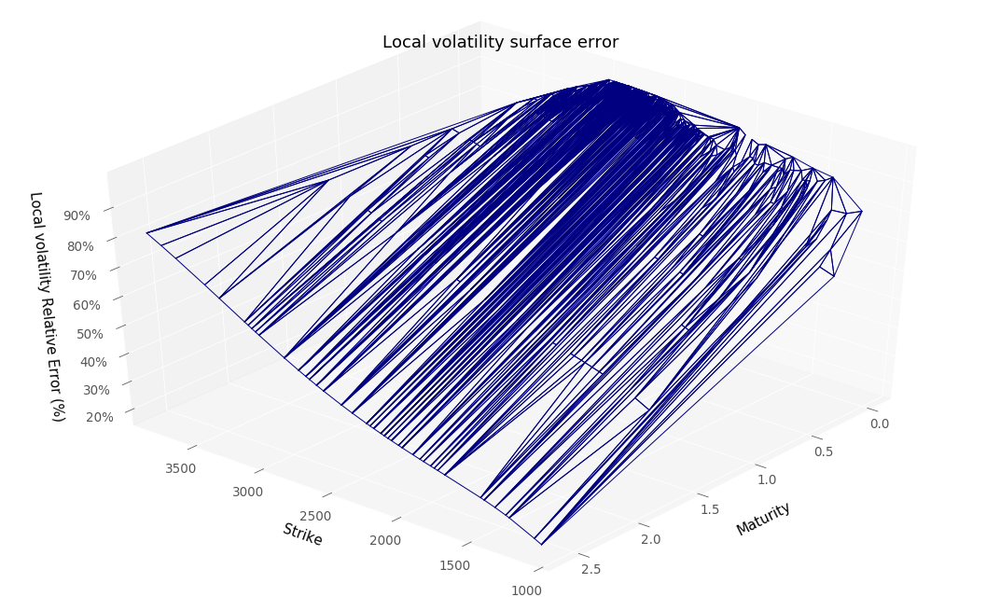

RMSE :  0.895748891880082
RMSE Relative:  0.895748891880082


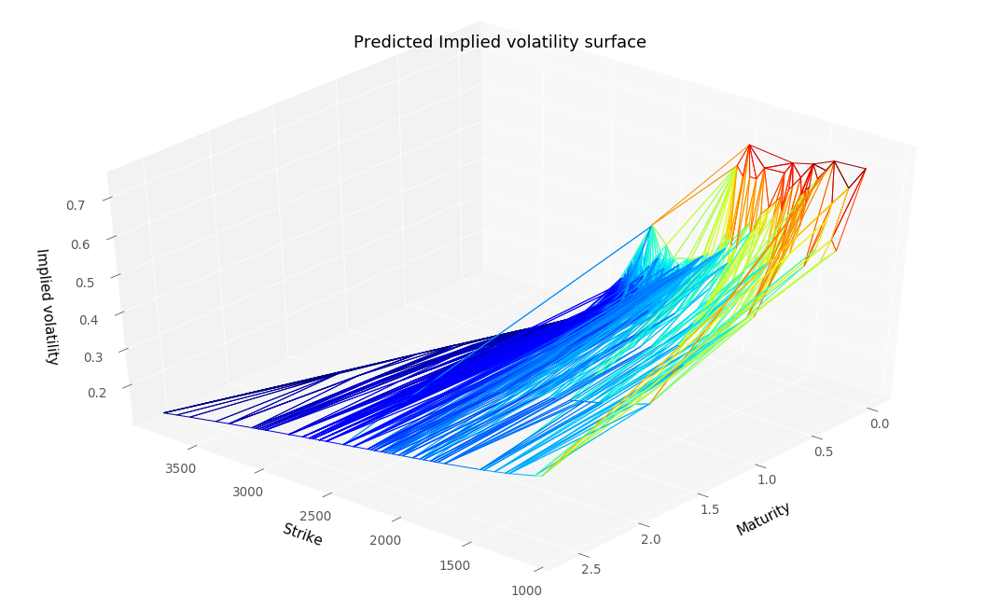

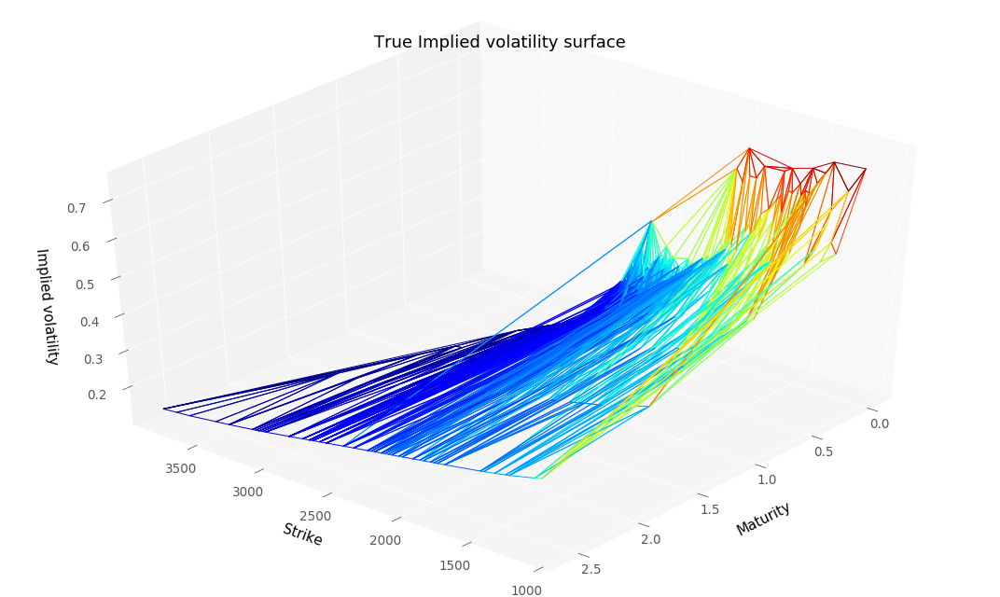

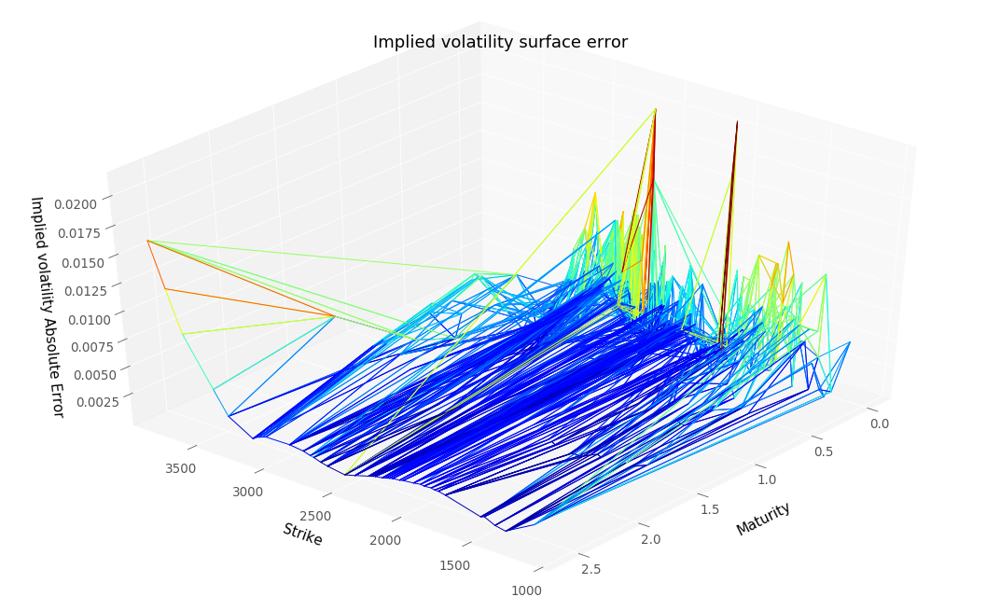

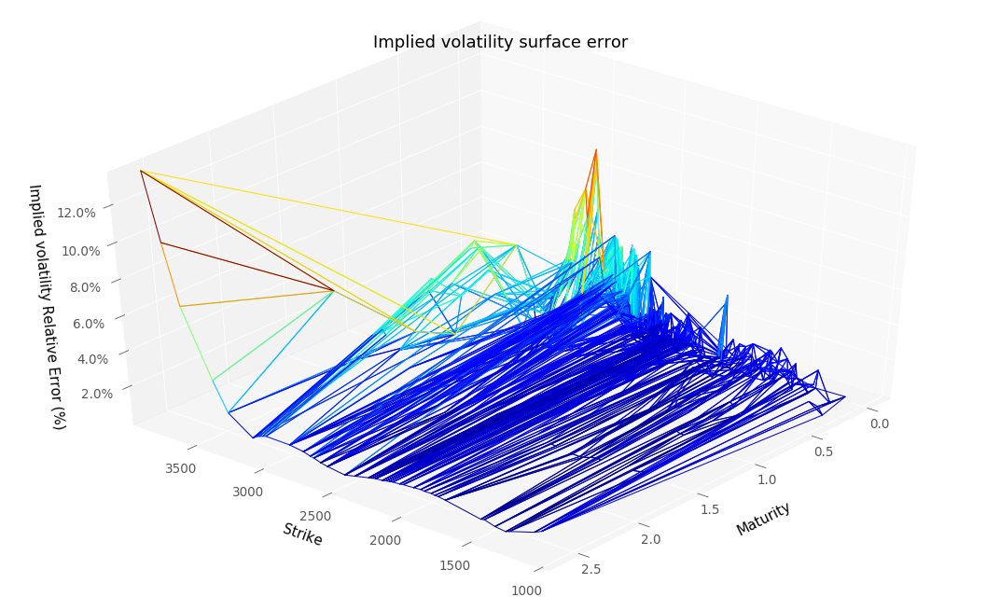

RMSE :  0.004501838644426452
RMSE Relative:  0.02188082413151984


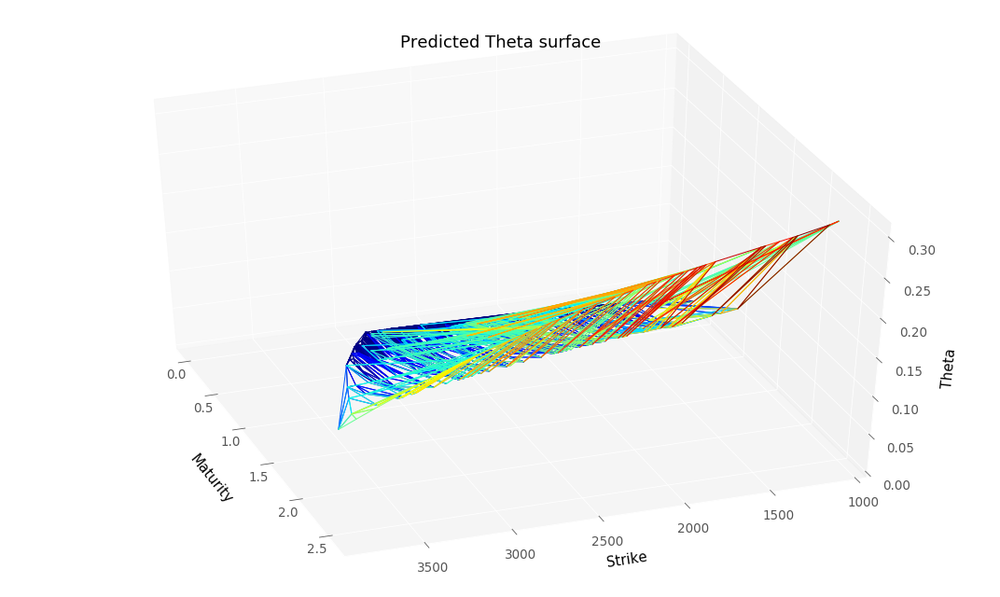

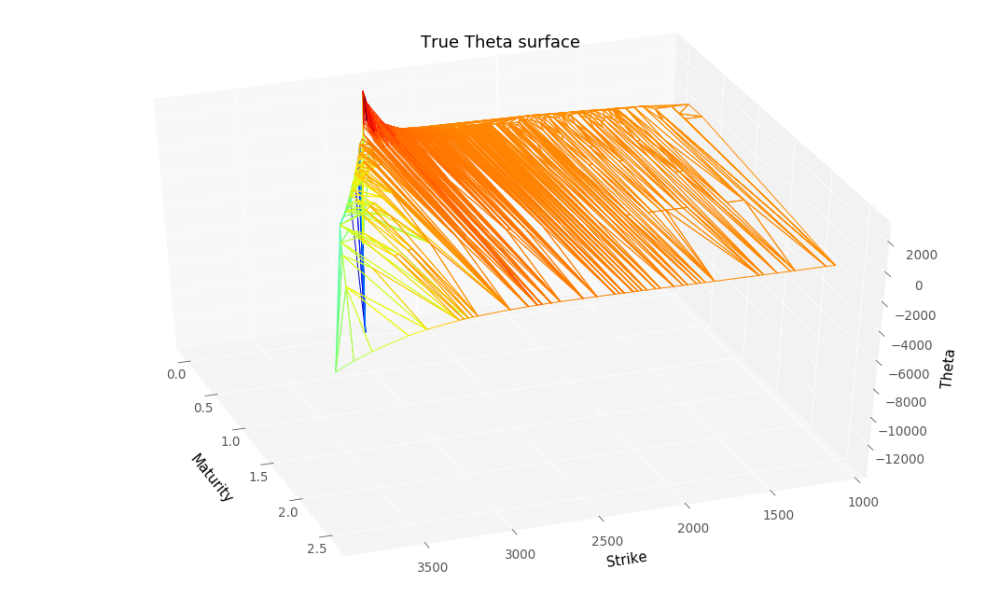

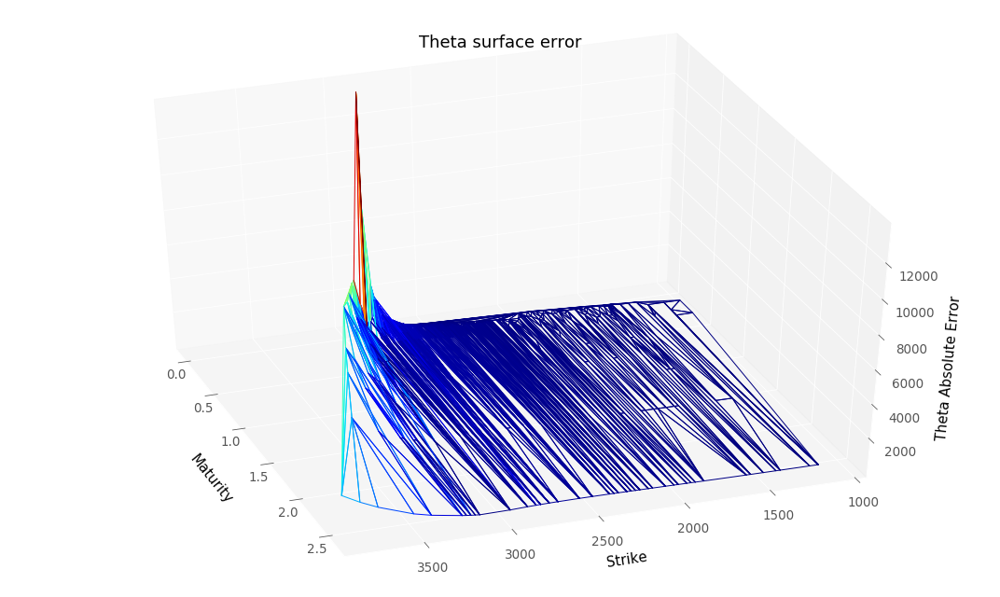

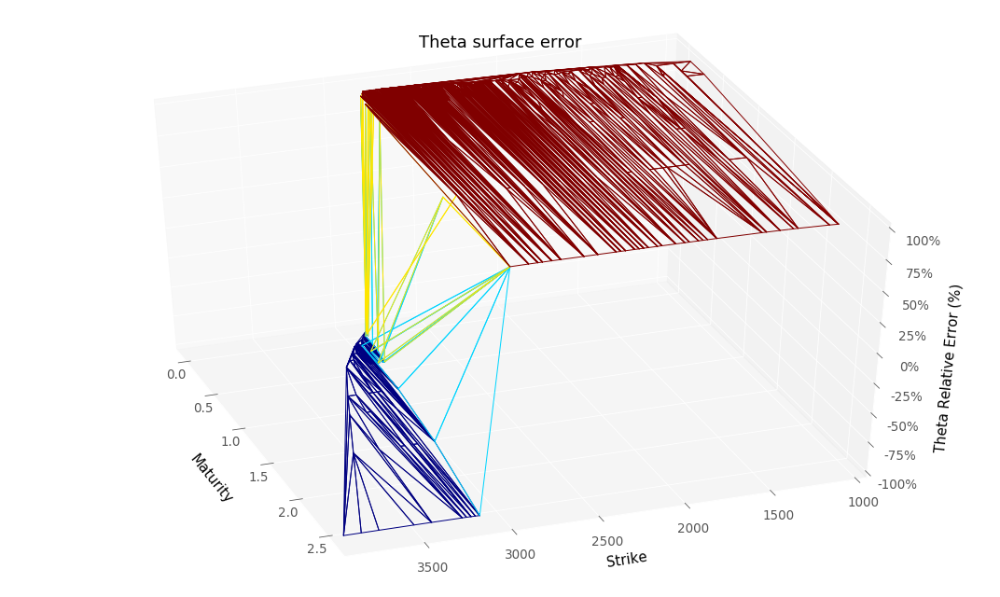

RMSE :  956.081722088642
RMSE Relative:  0.9995710679600706


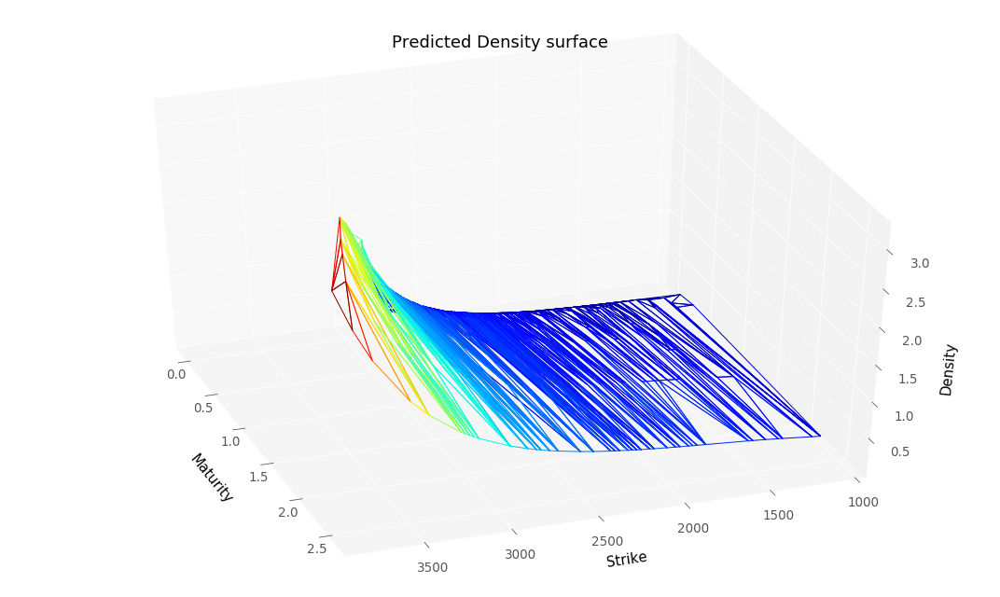

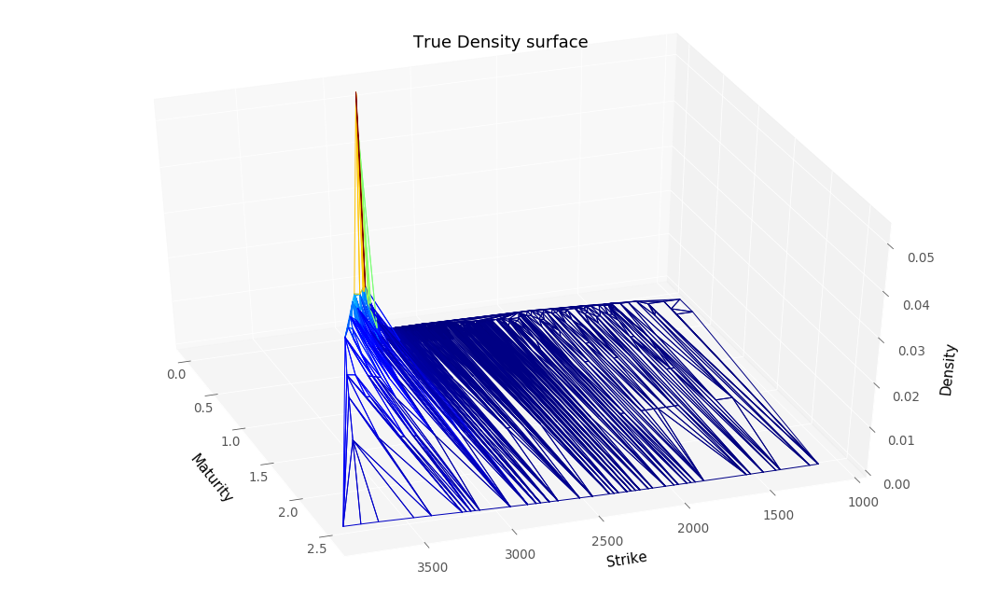

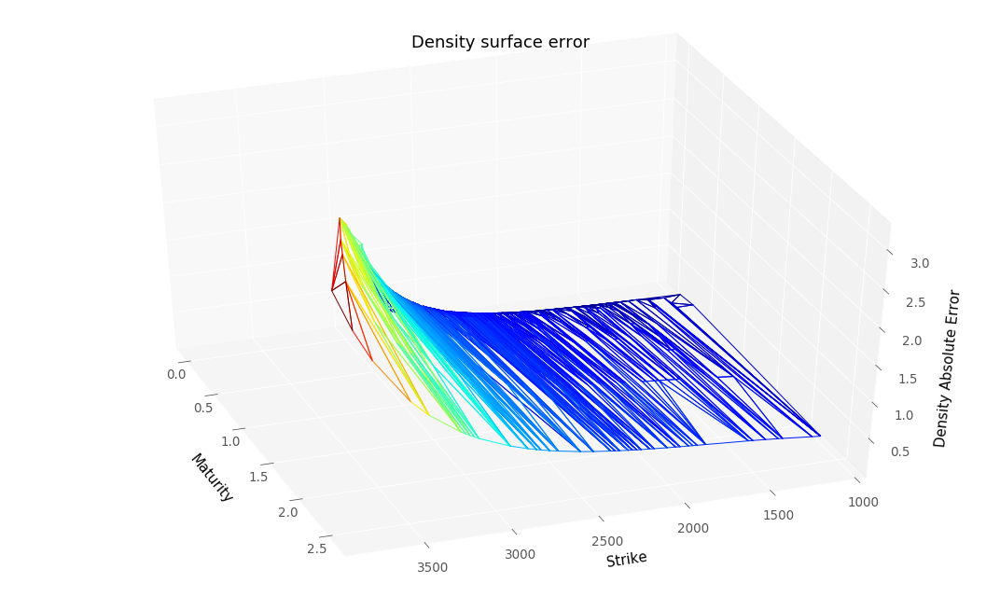

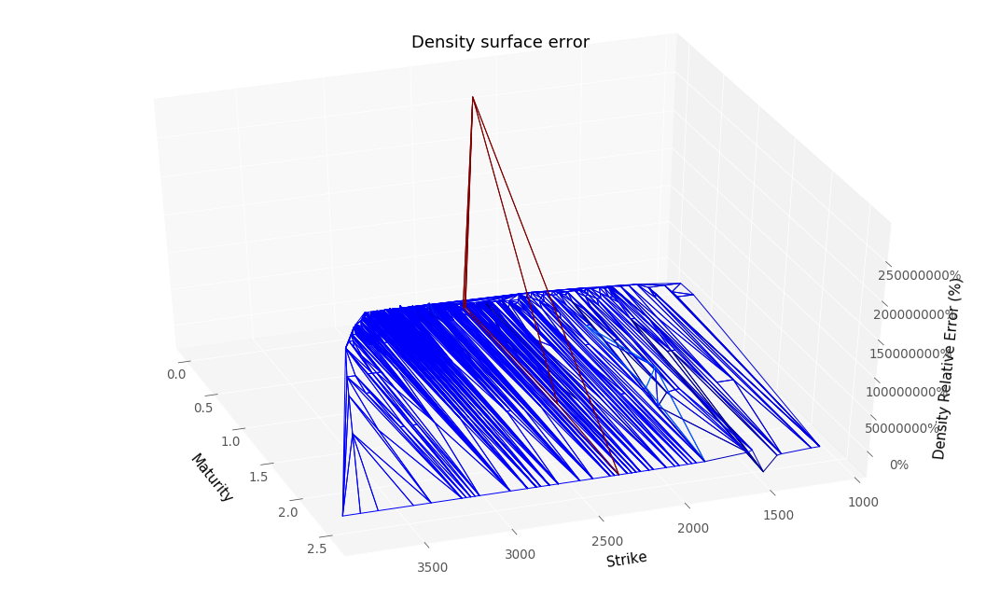

RMSE :  0.708884521855381
RMSE Relative:  118028.07942394428


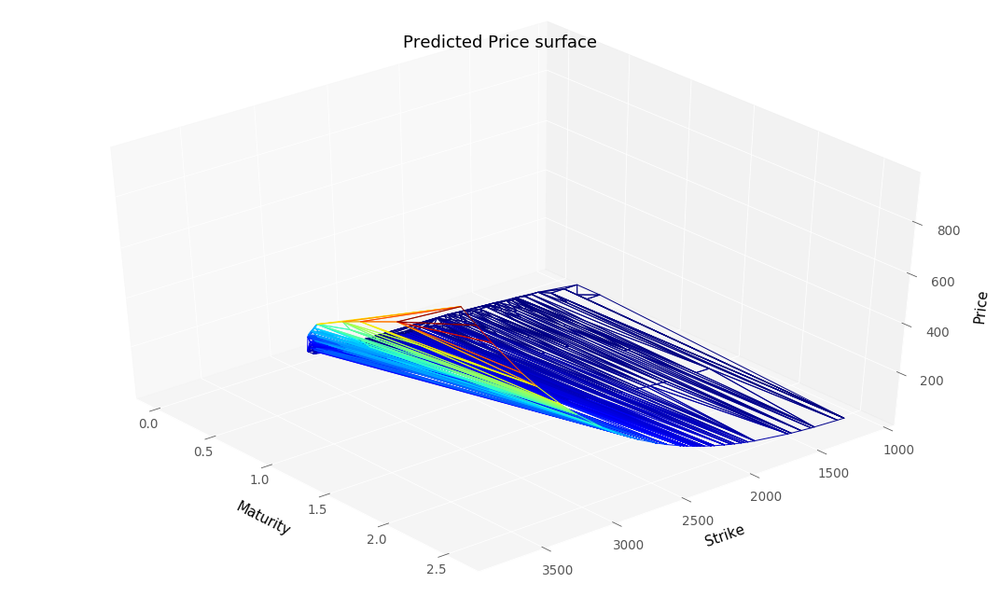

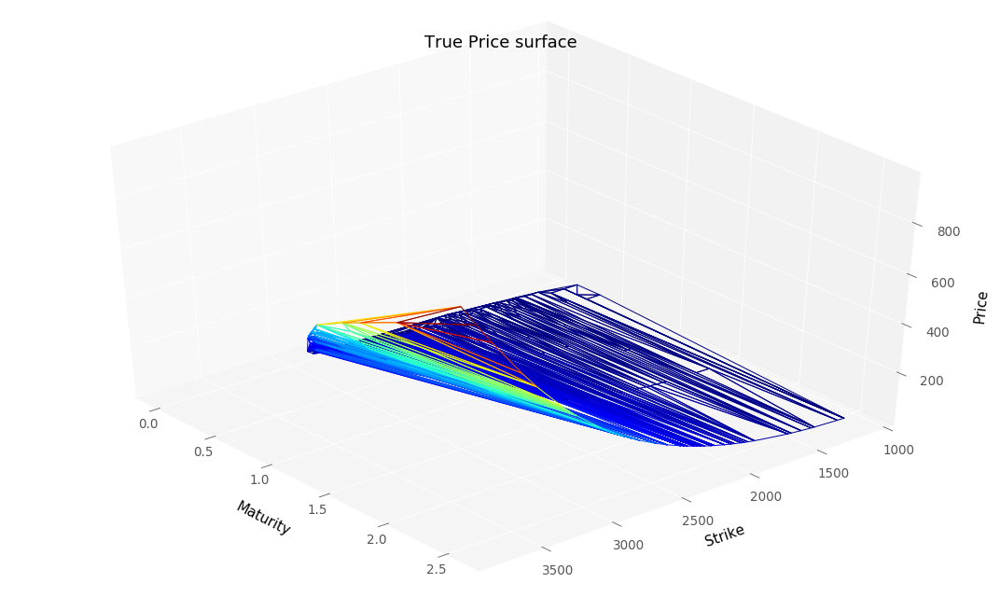

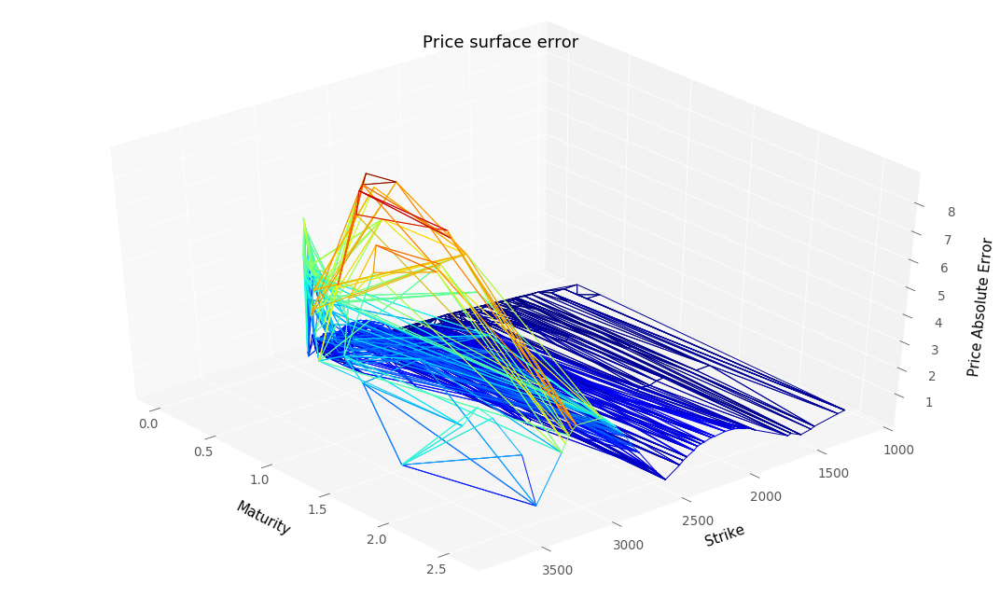

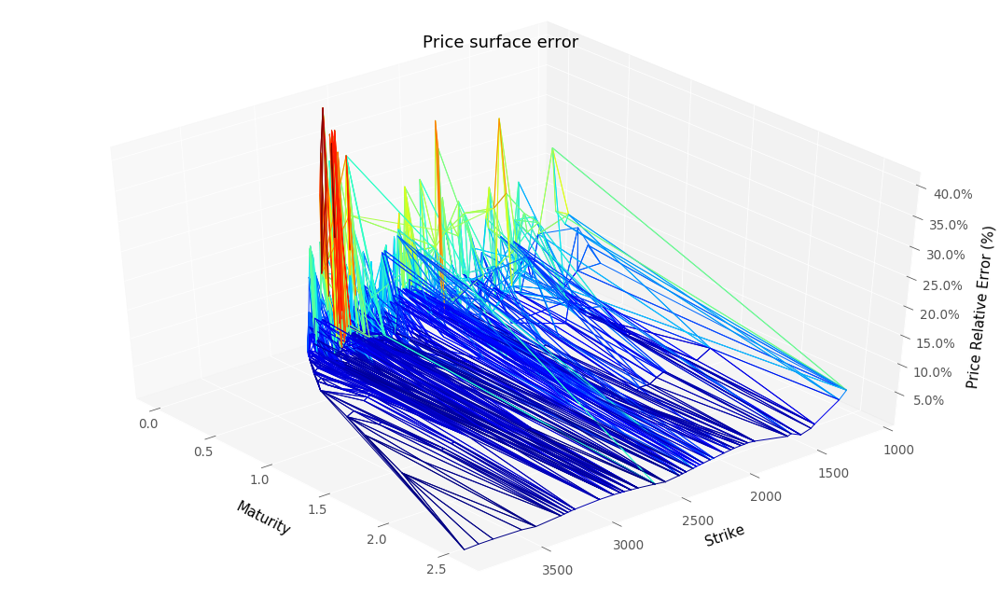

RMSE :  1.7560521899352273
RMSE Relative:  0.09298417162172049
ATM Local Volatility : 
Strike  Maturity
2865.0  0.068       0.009332
Name: Dupire, dtype: float32


In [10]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               dataSet,
                                               False,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               yMin = KMin,
                               yMax = KMax, 
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTrain")

print("ATM Local Volatility : ")
print(volLocale4G.loc[(midS0,slice(None))])

Best loss (hidden nodes: 100, iterations: 0): -5.38
Best Penalization :  [0.004621974, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[0.0, 0.0]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


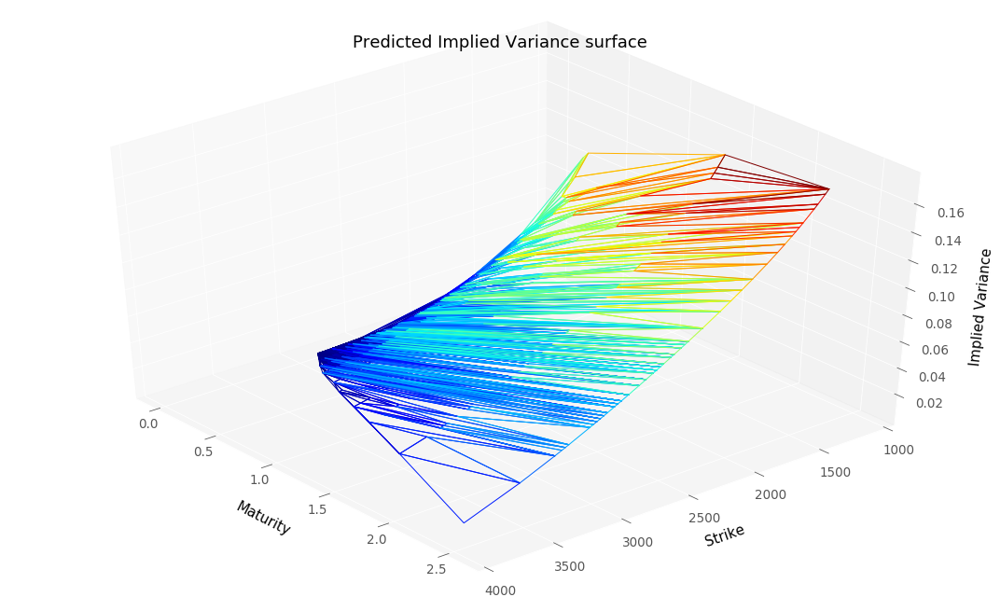

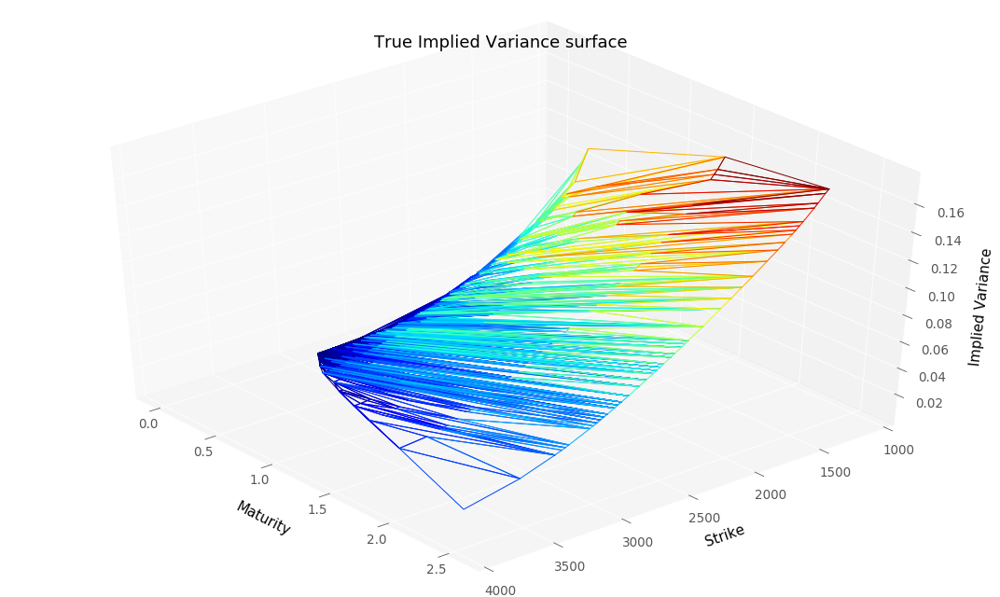

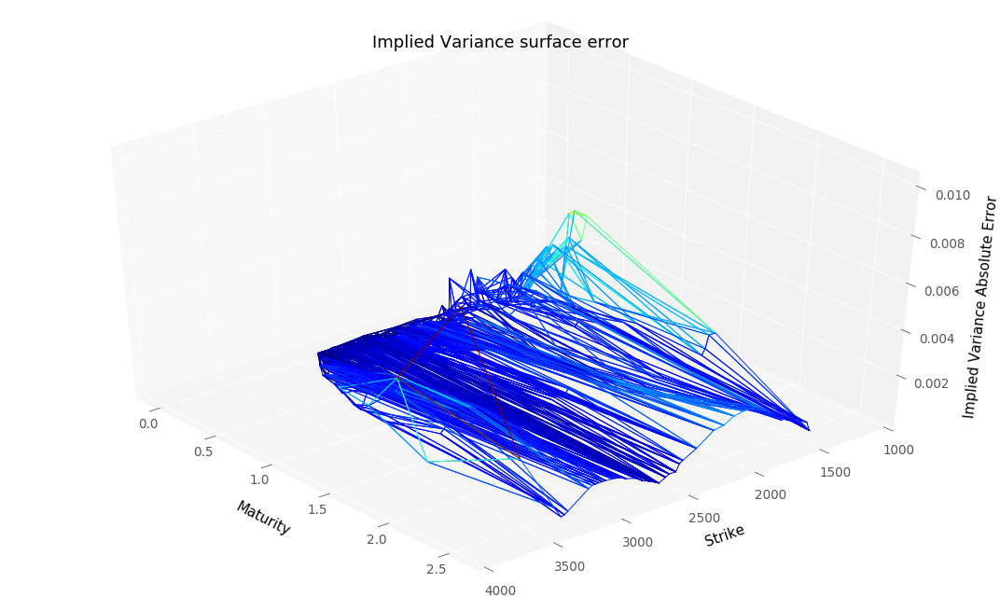

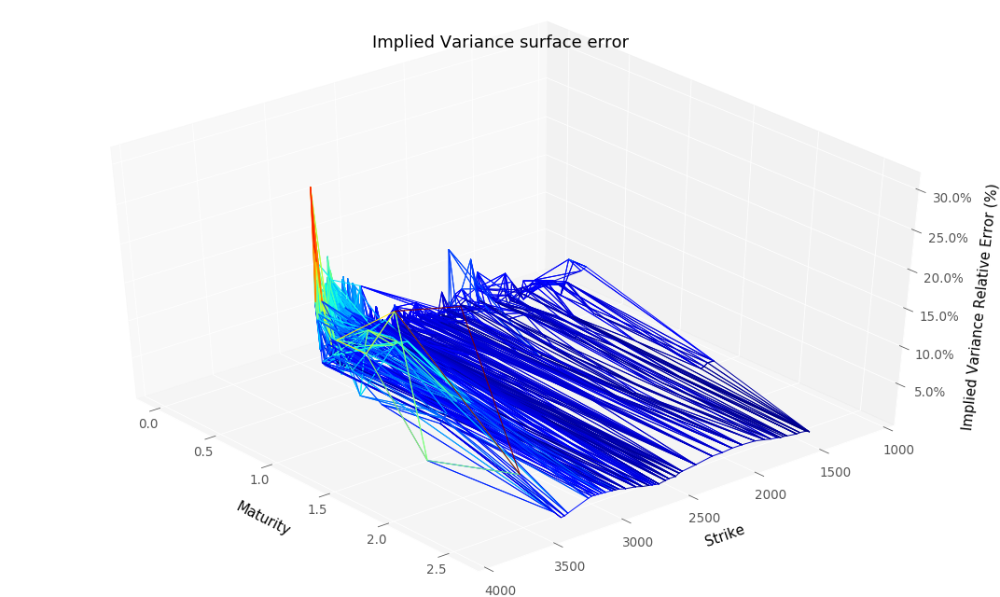

RMSE :  0.0008019517211258276
RMSE Relative:  0.04466581577779356


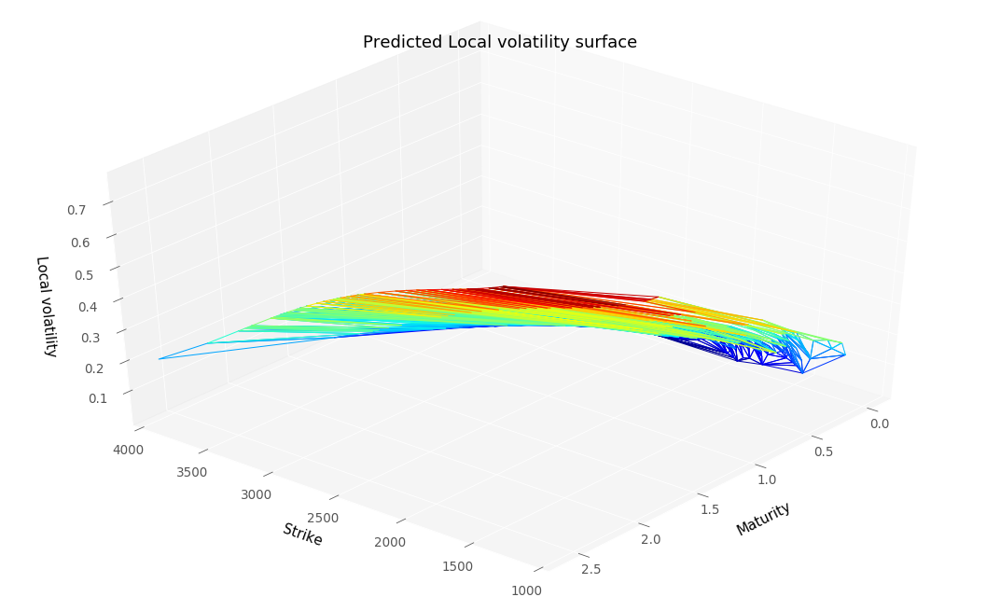

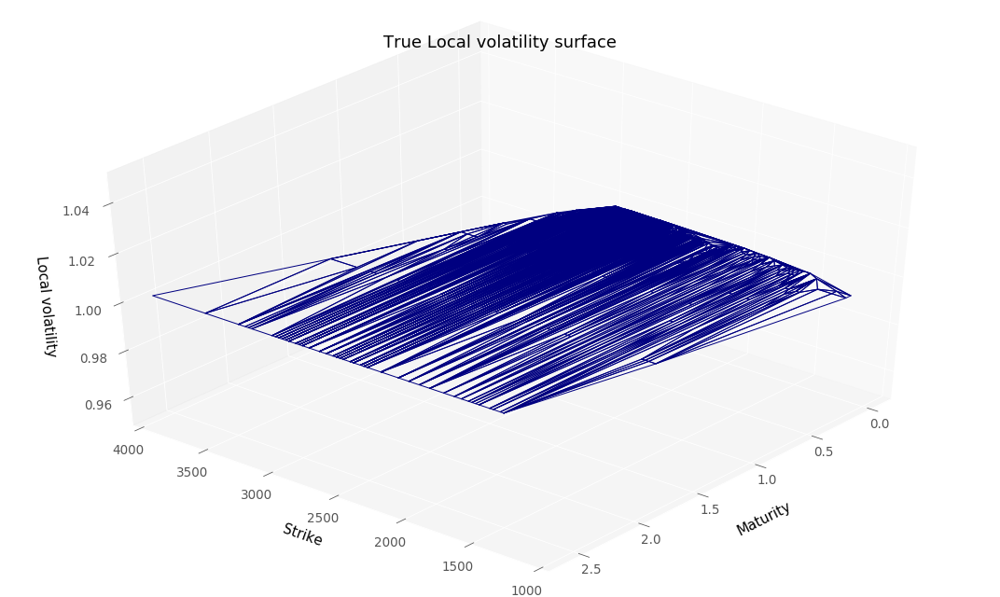

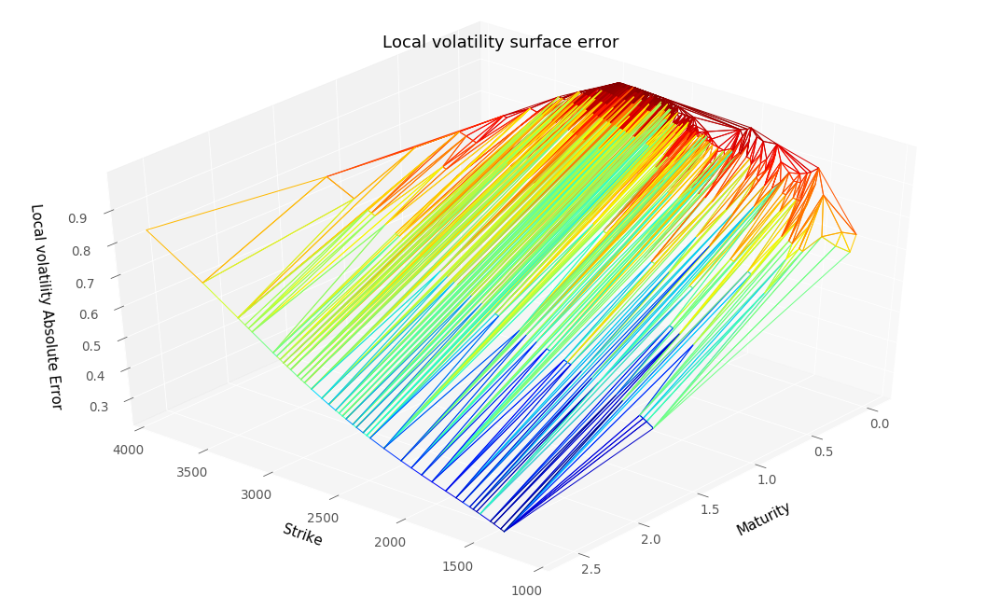

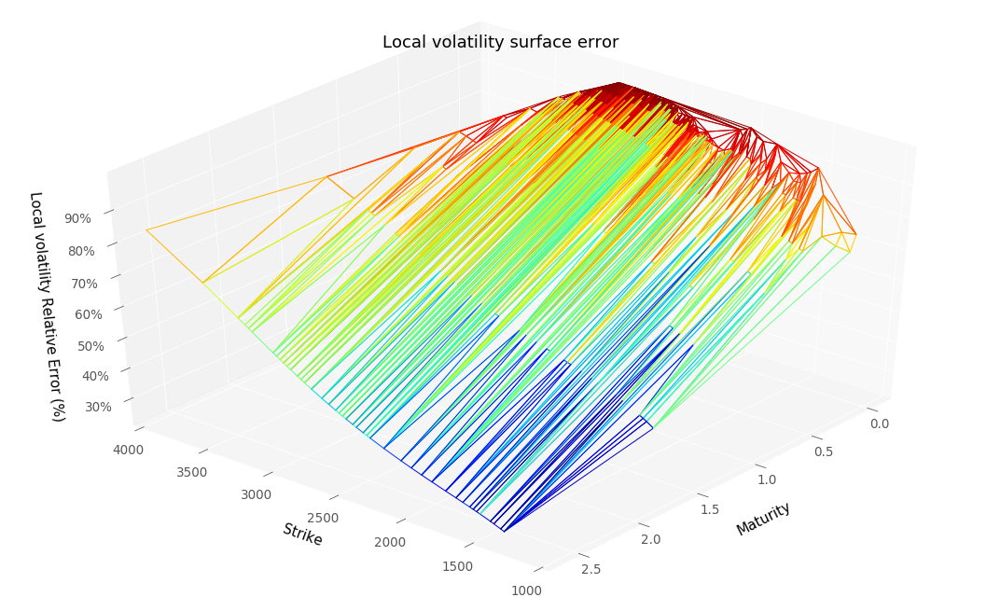

RMSE :  0.8991549079491465
RMSE Relative:  0.8991549079491465


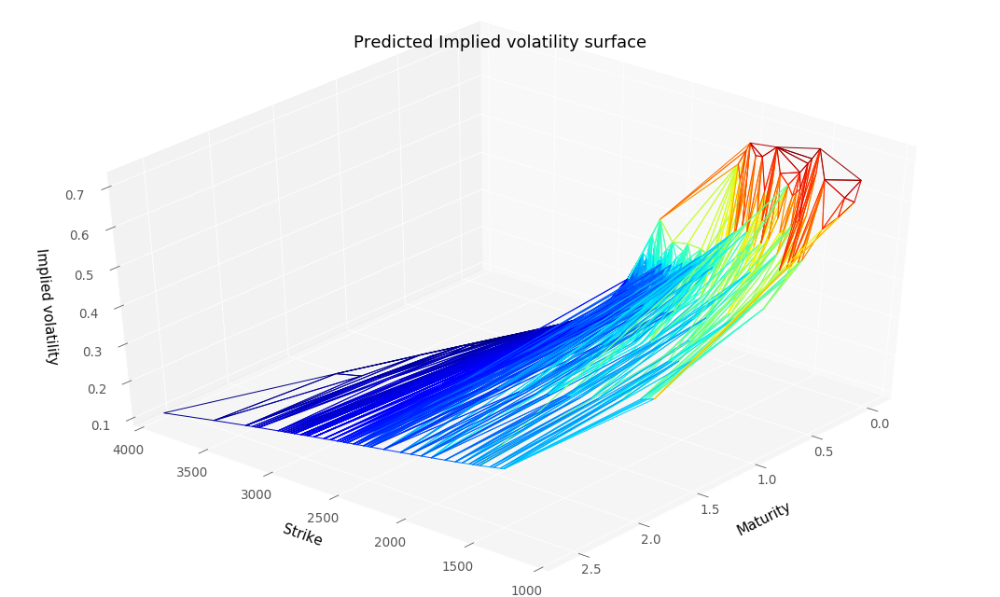

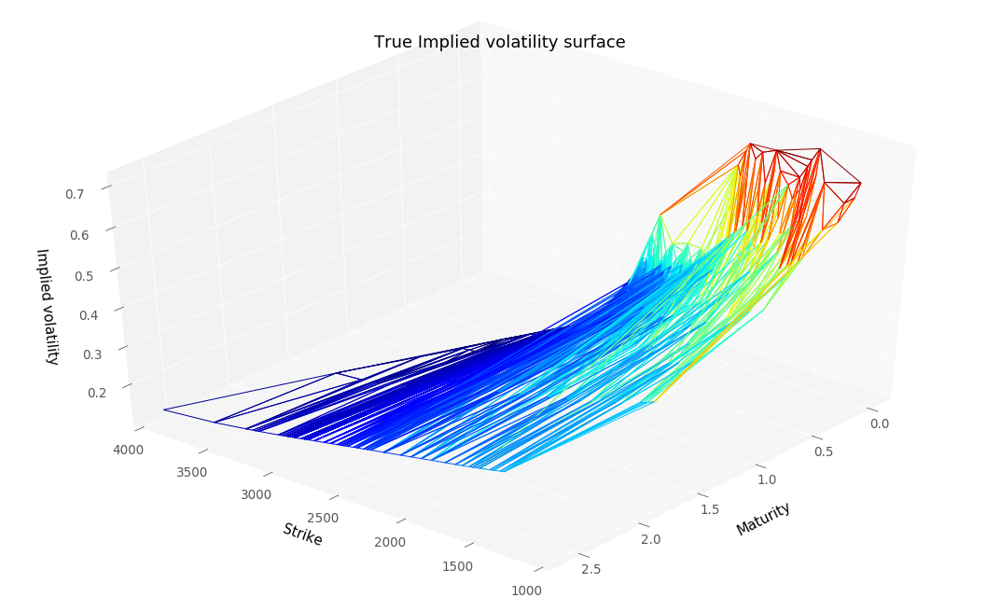

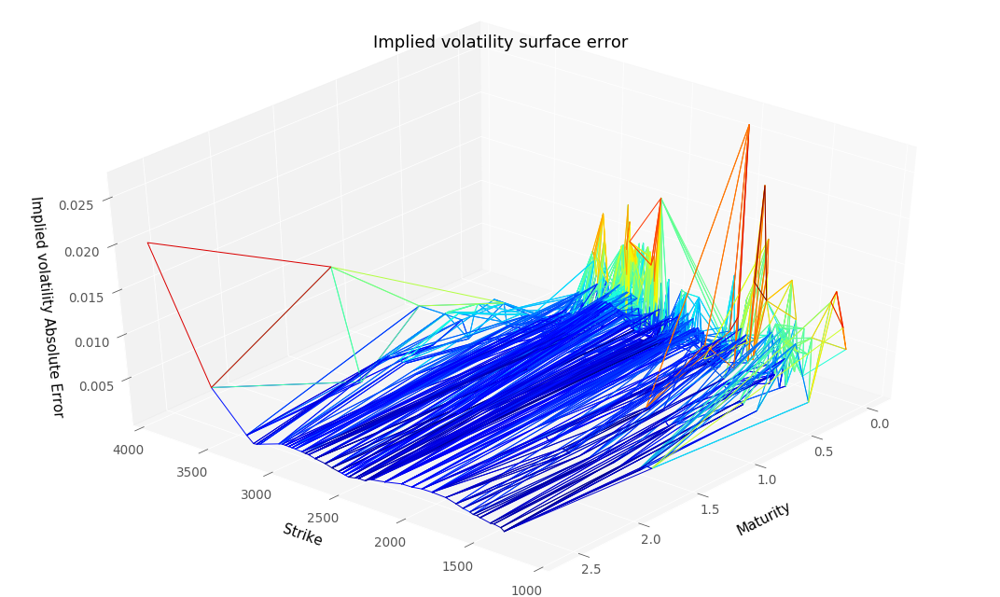

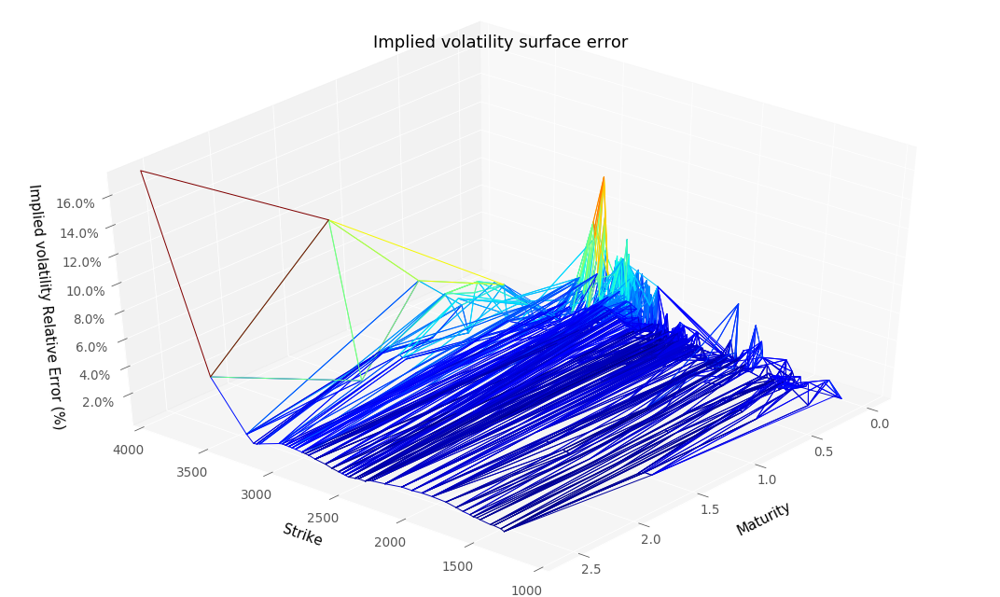

RMSE :  0.004621972748280553
RMSE Relative:  0.02247219681403689


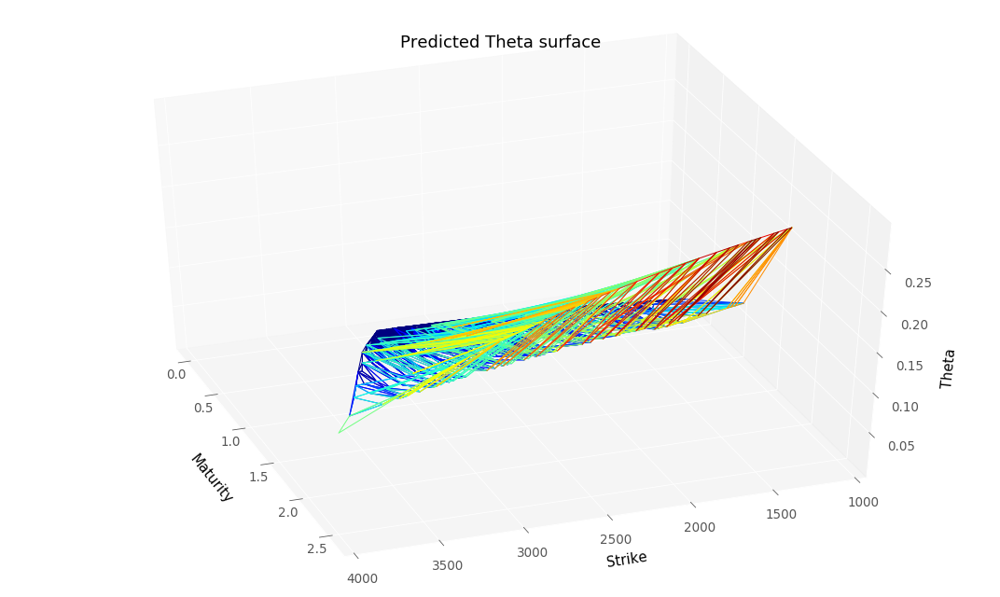

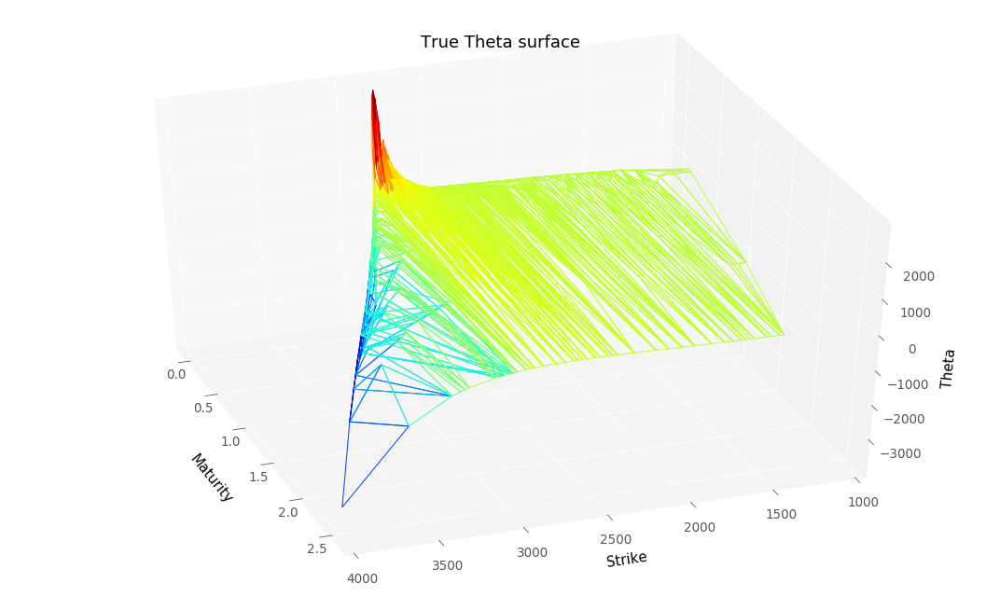

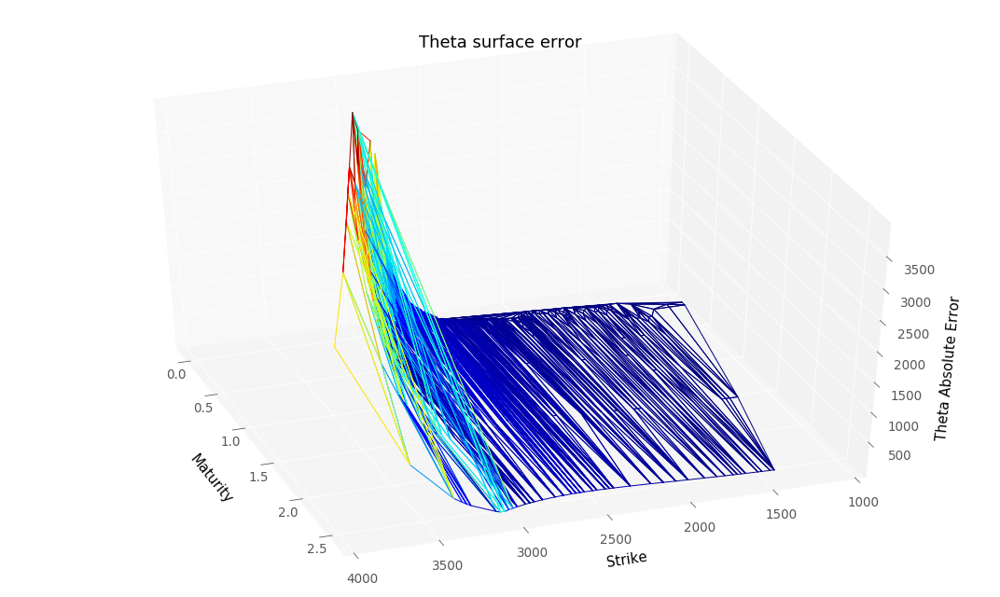

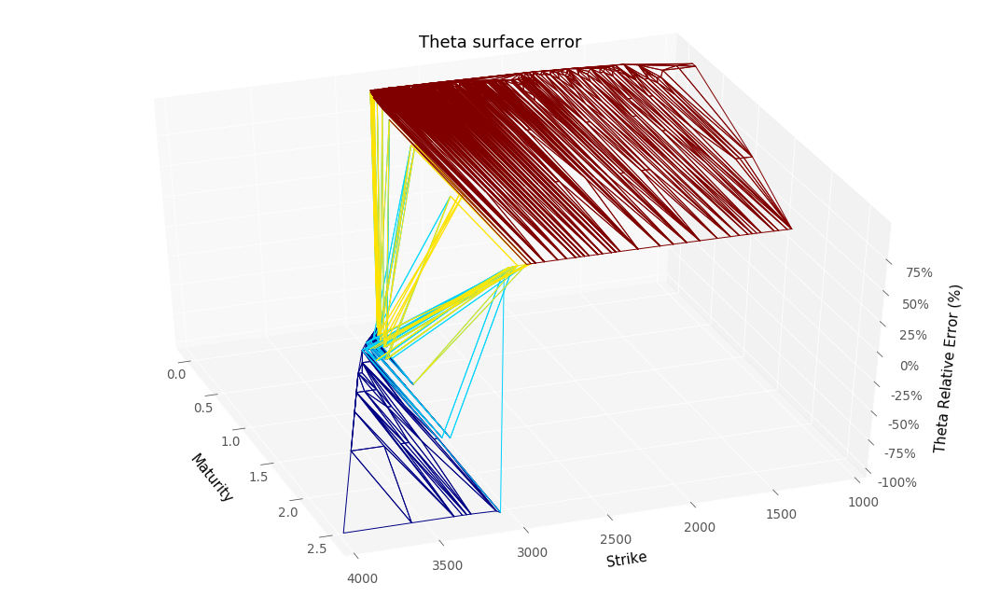

RMSE :  694.9380852101098
RMSE Relative:  0.9996253643369879


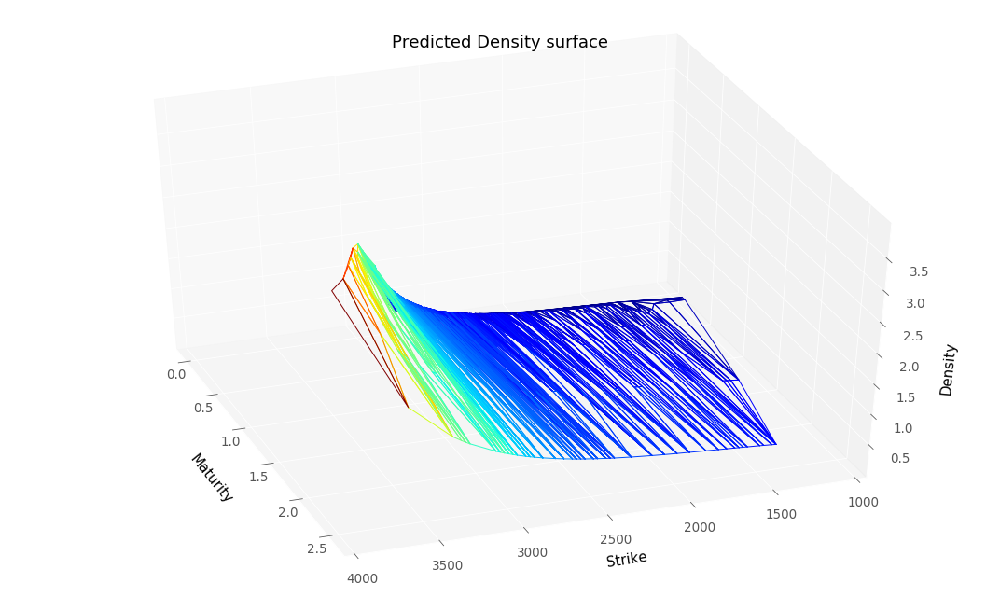

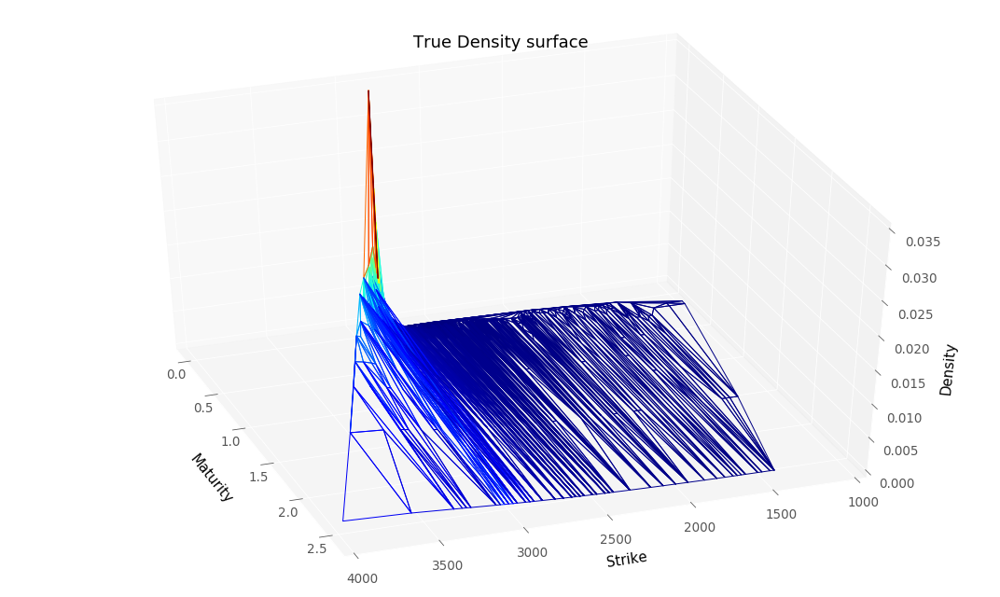

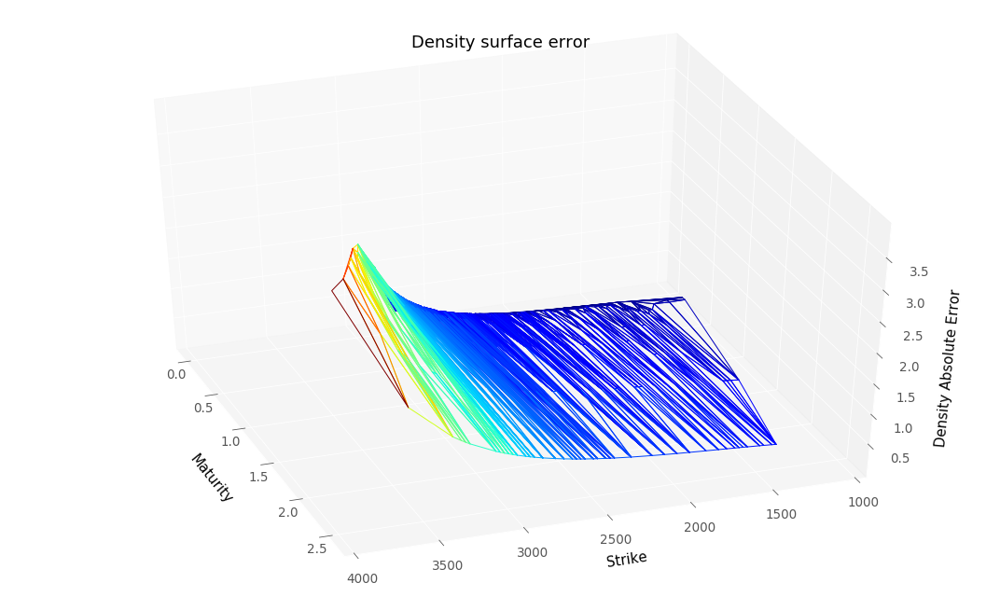

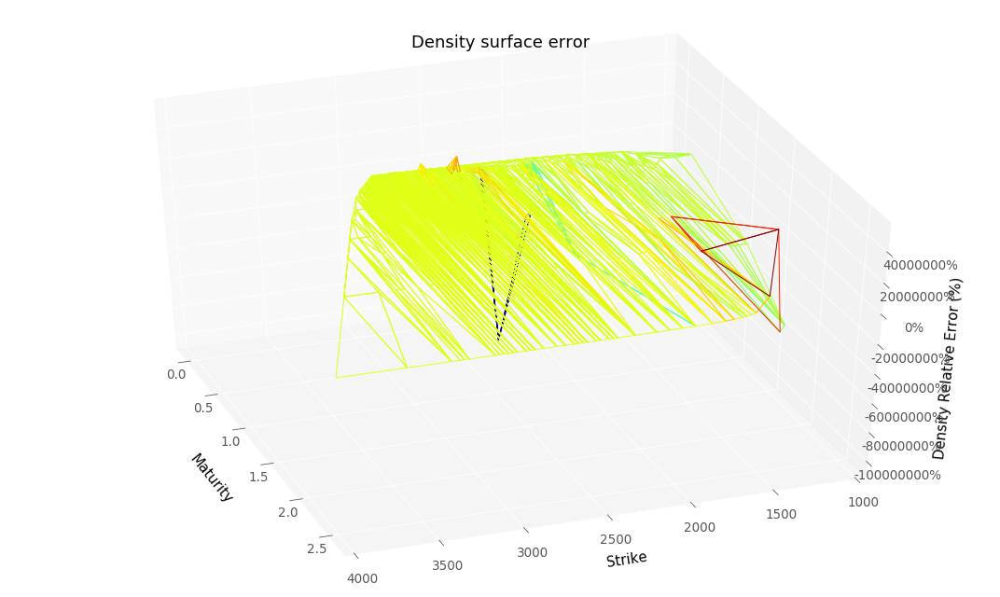

RMSE :  0.7288509235163116
RMSE Relative:  49829.07131909066


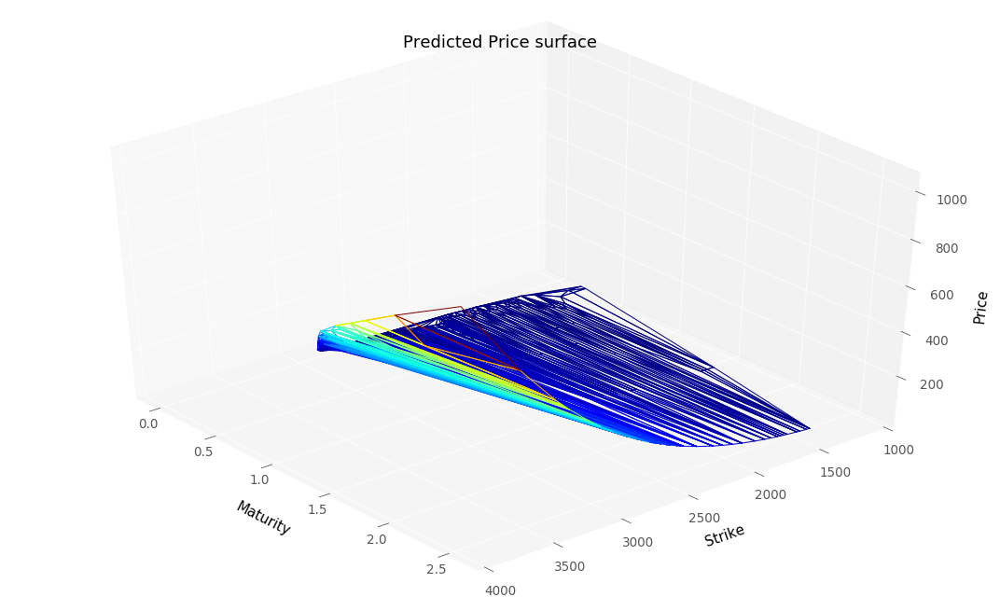

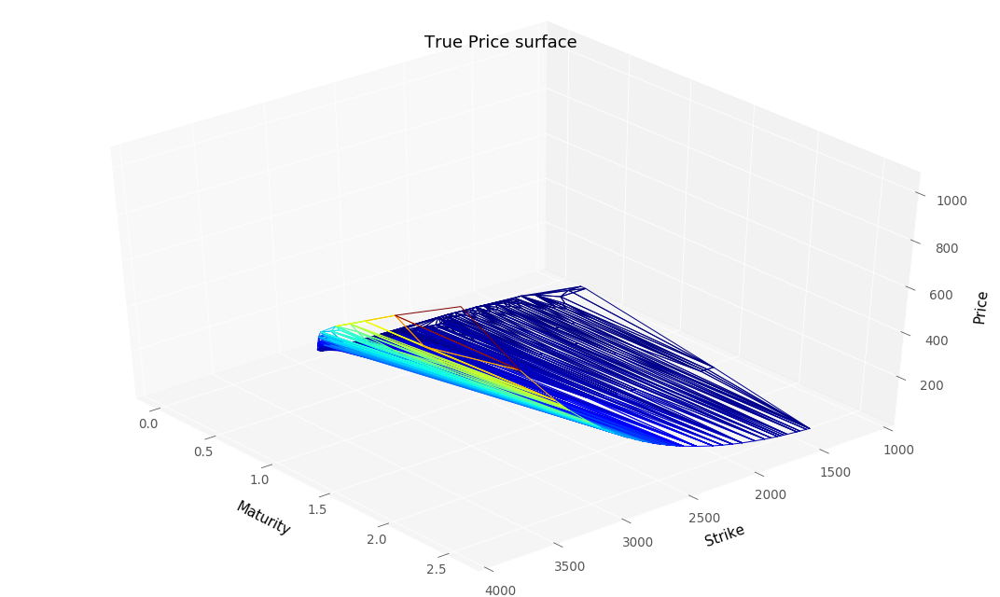

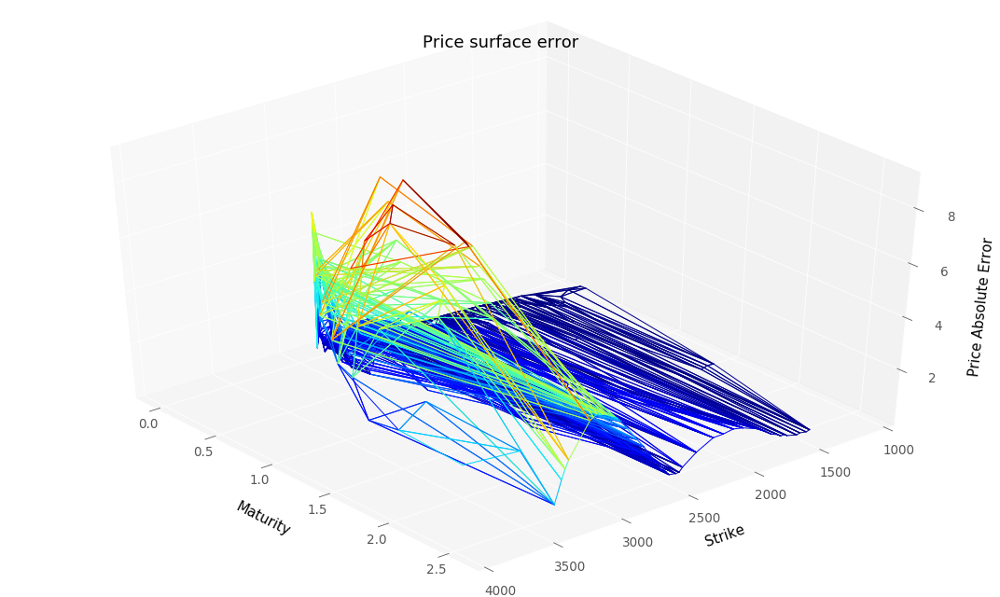

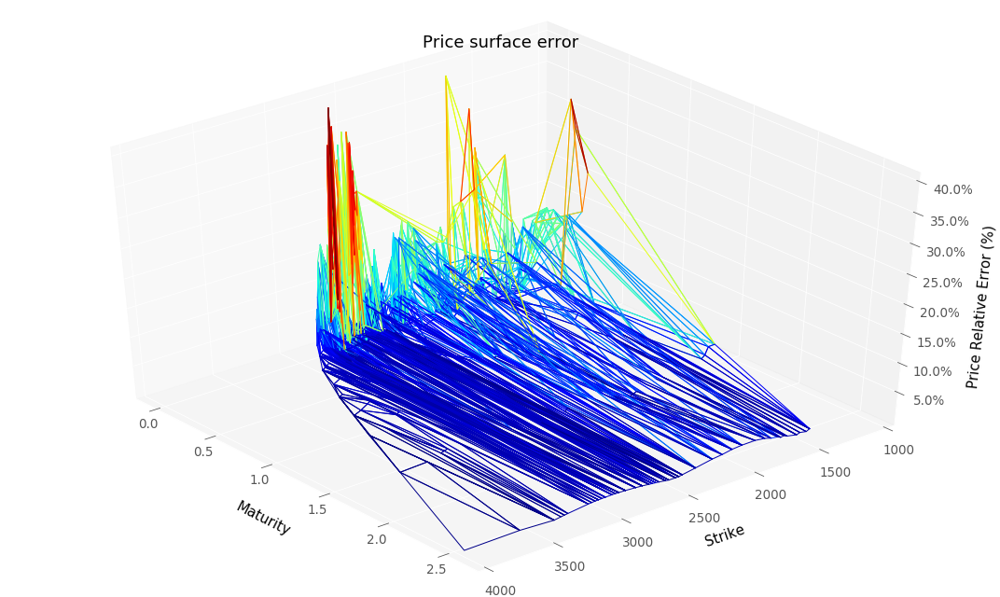

RMSE :  1.777200876397453
RMSE Relative:  0.09470968412932805


In [11]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               dataSetTest,
                                               False,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4TestG, volLocale4TestG, dNN_T4TestG, gNN_K4TestG, lossSerie4TestG = res

plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               yMin = KMin,
                               yMax = KMax,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTest")

Number of static arbitrage violations :  1
Arbitrable total variance :  Strike  Maturity
1875.0  0.036       0.017428
Name: Price, dtype: float32


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


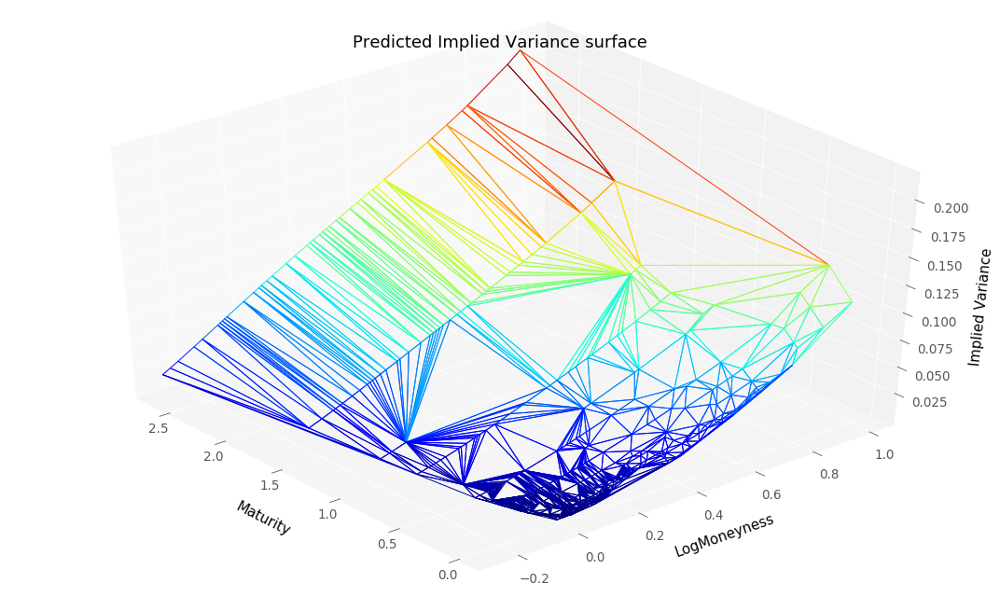

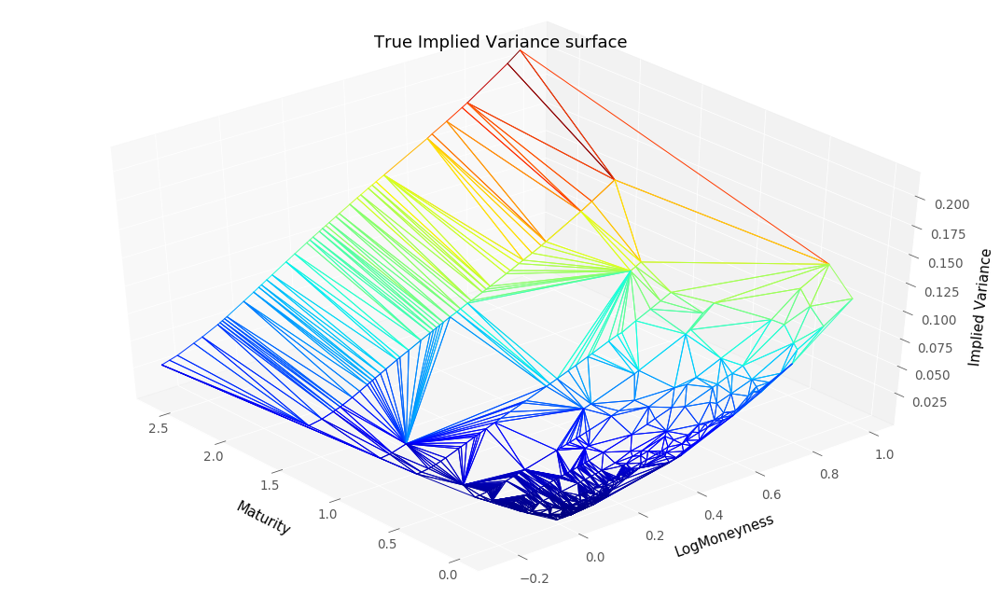

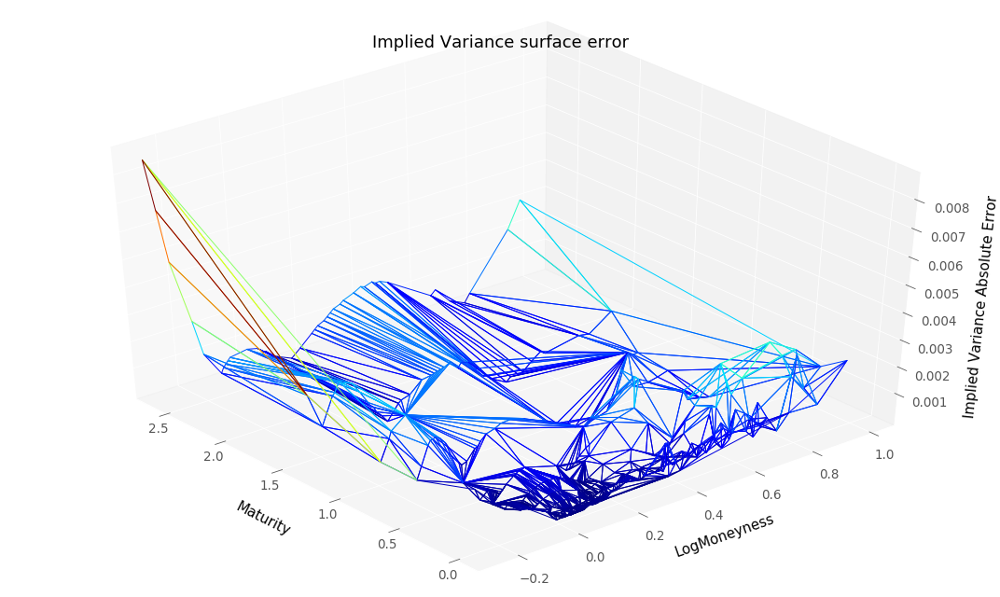

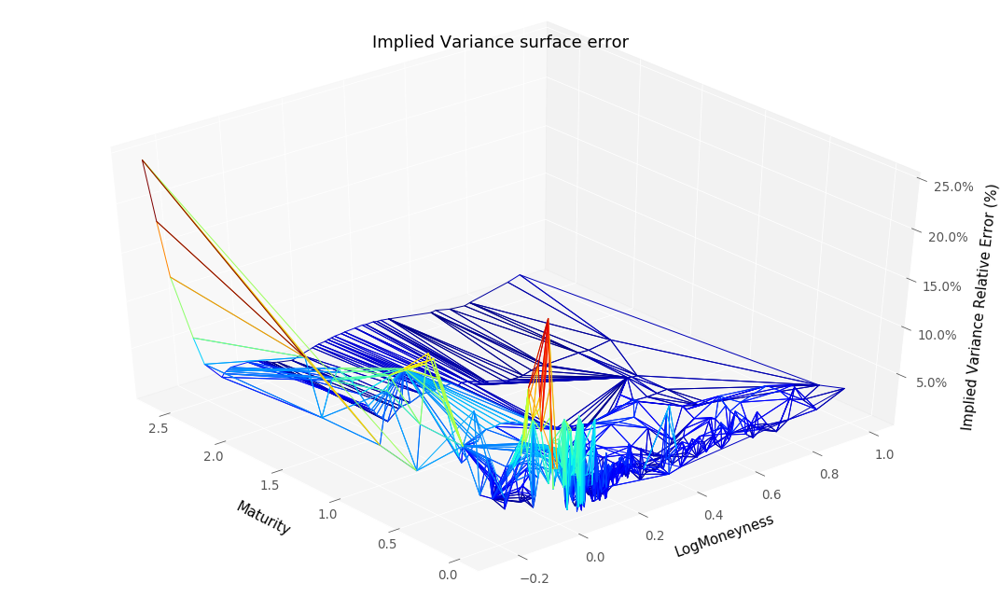

RMSE :  0.0008195914537520846
RMSE Relative:  0.04373054667759705


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


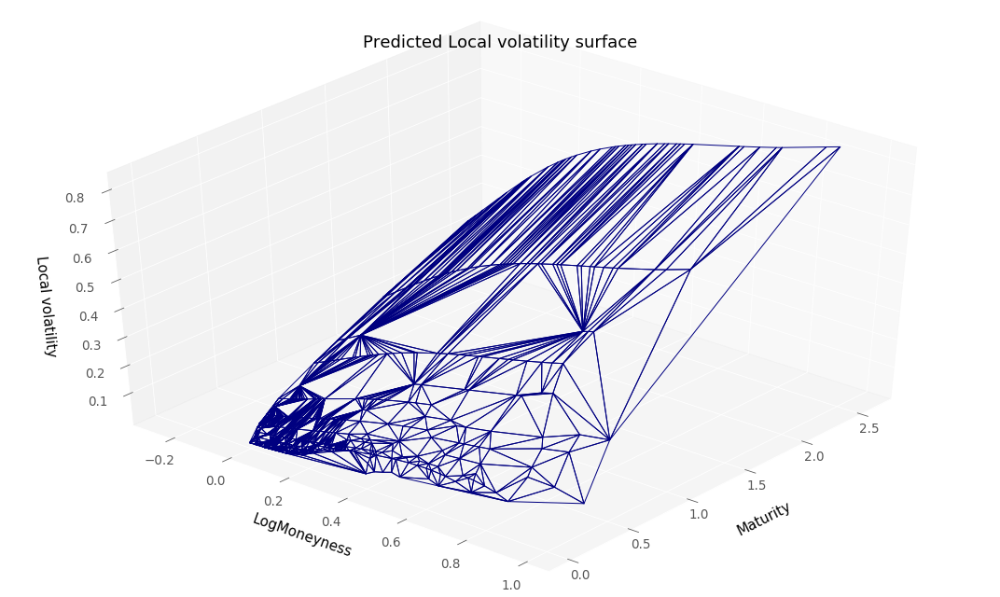

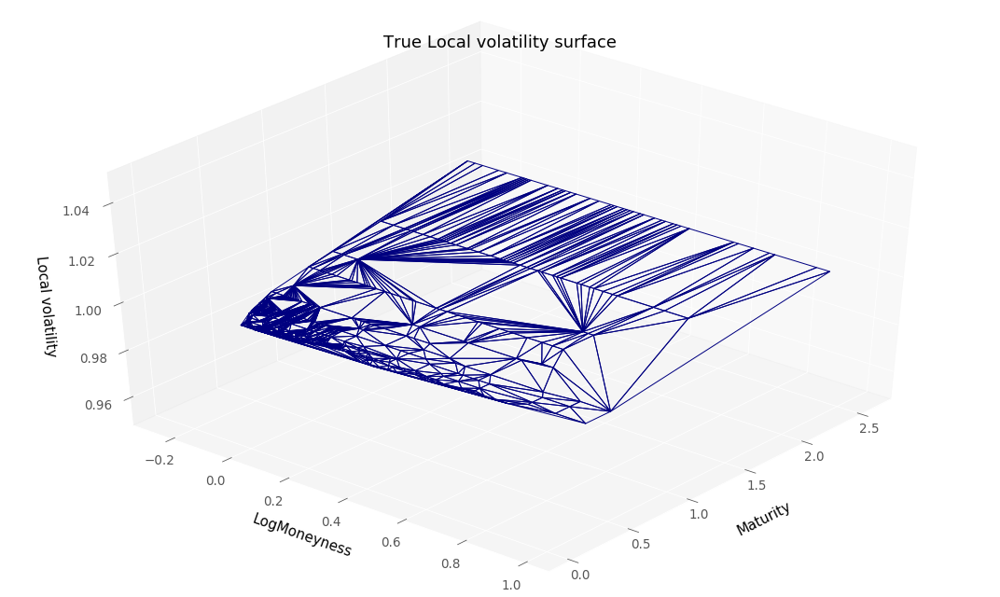

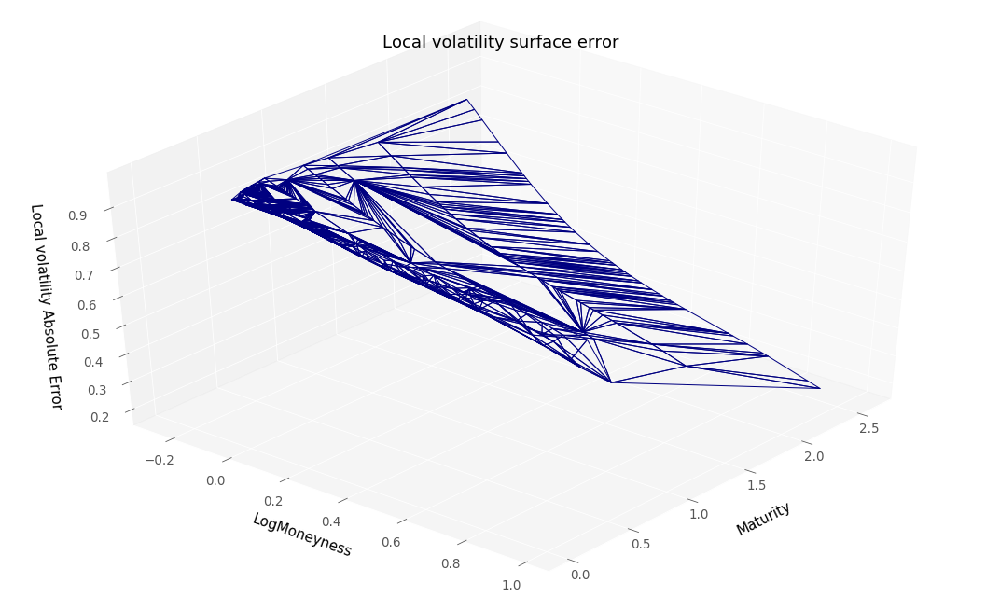

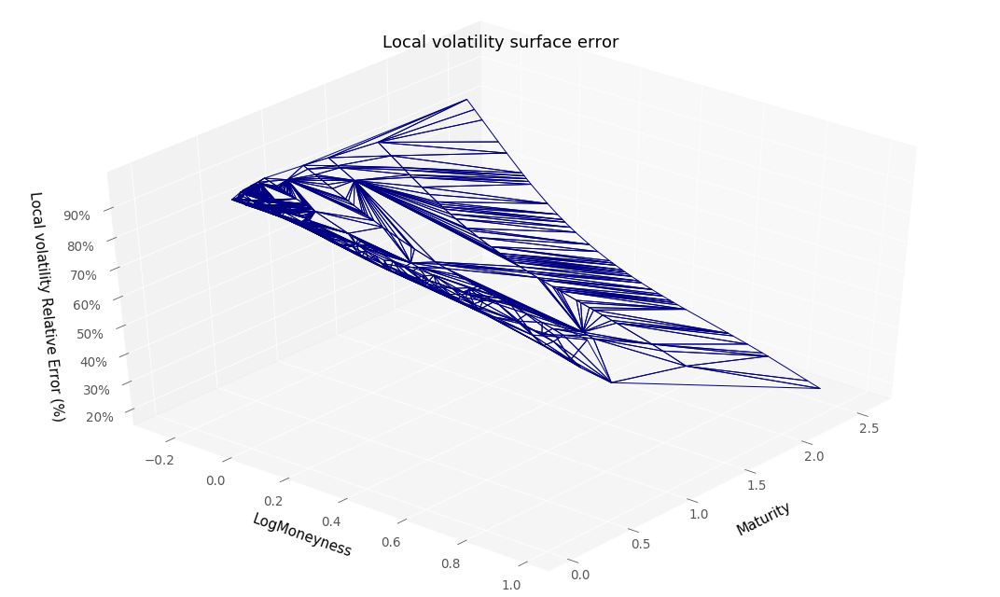

RMSE :  0.895748891880082
RMSE Relative:  0.895748891880082


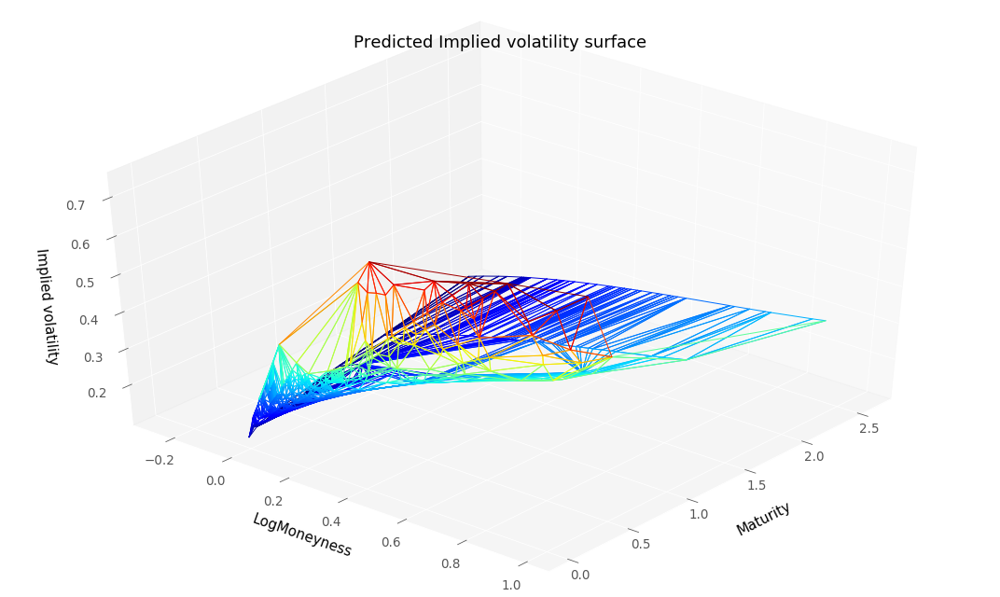

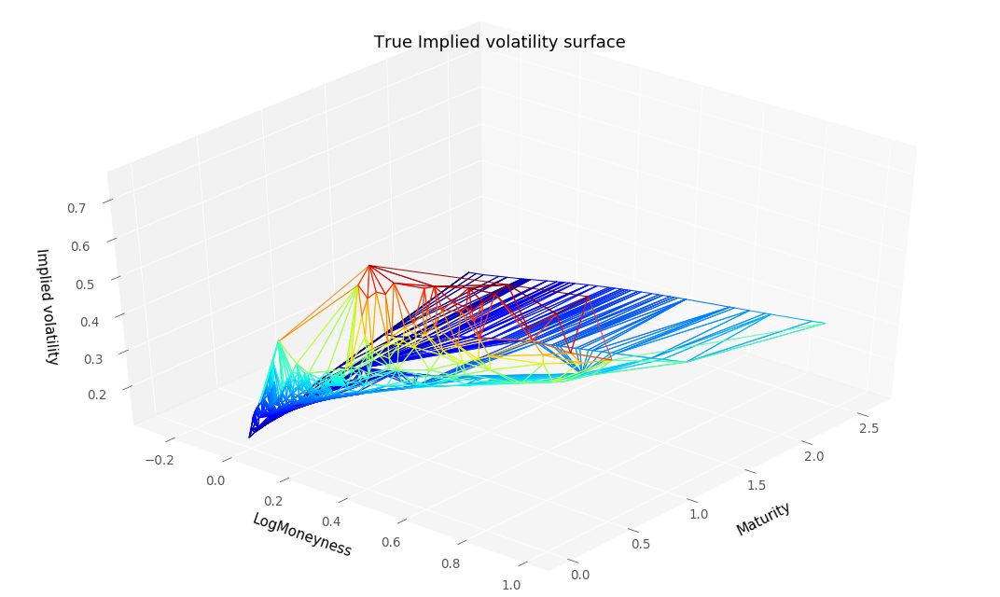

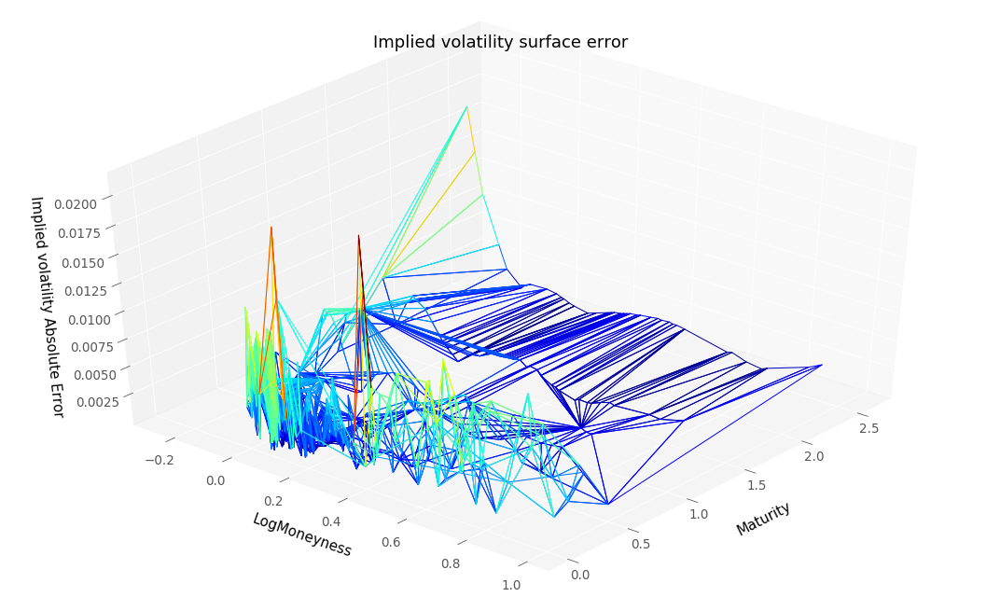

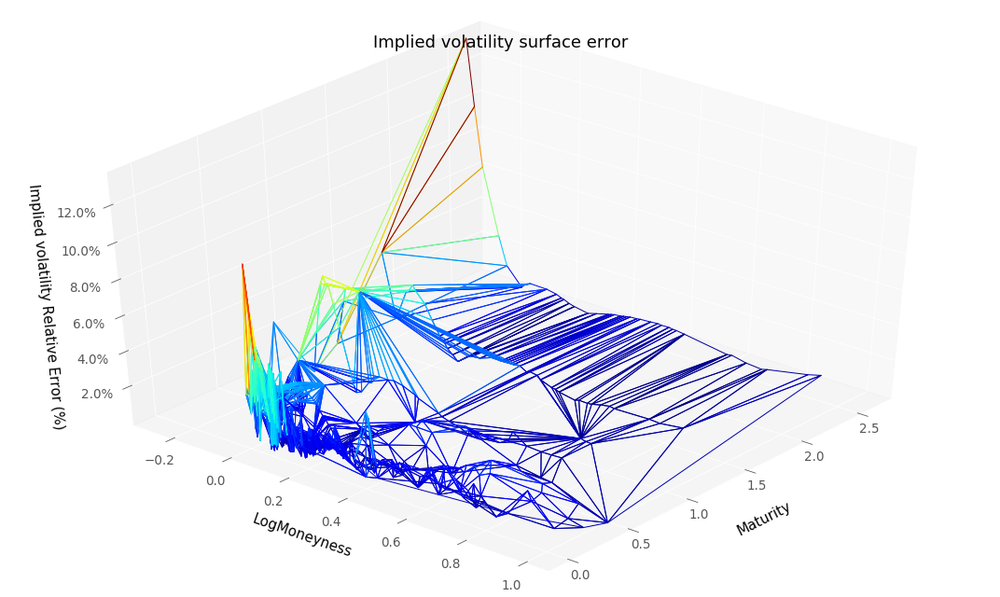

RMSE :  0.004501838644426452
RMSE Relative:  0.02188082413151984


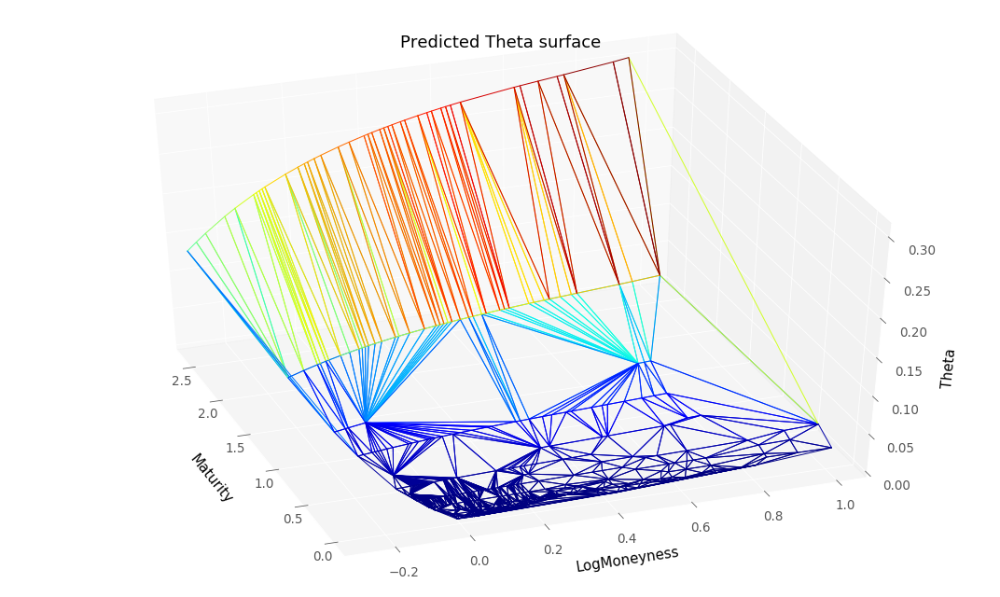

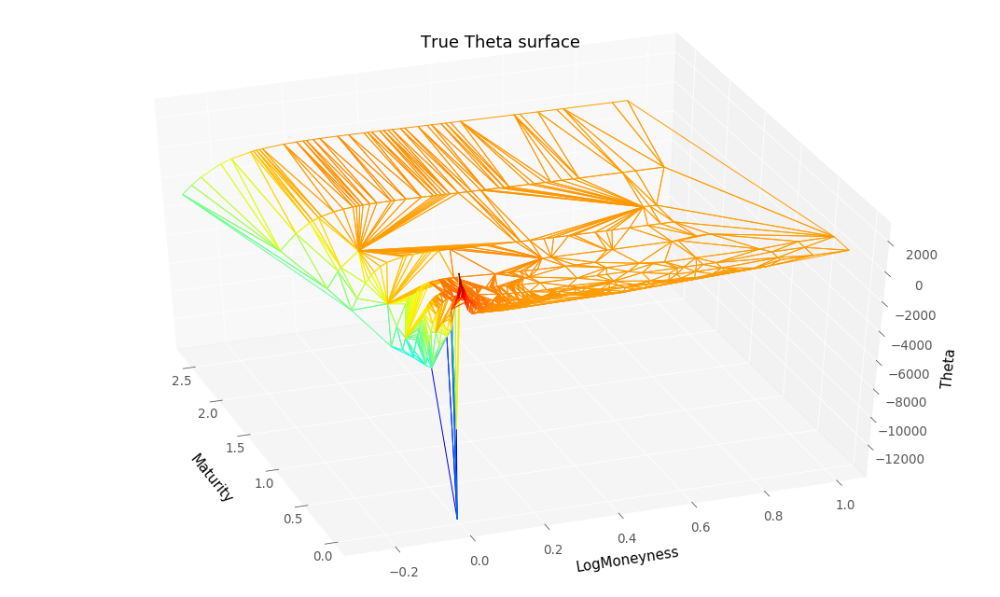

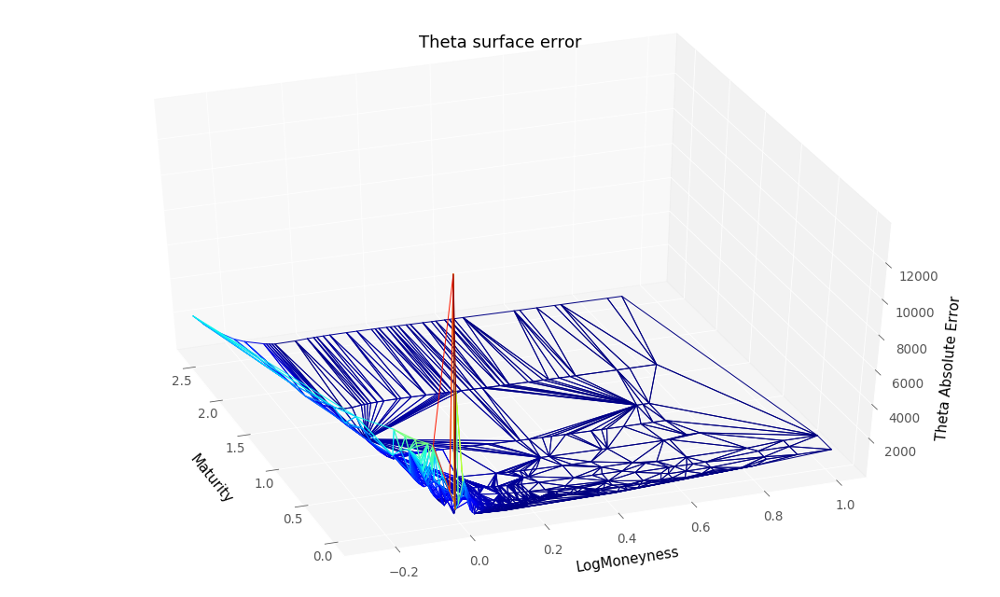

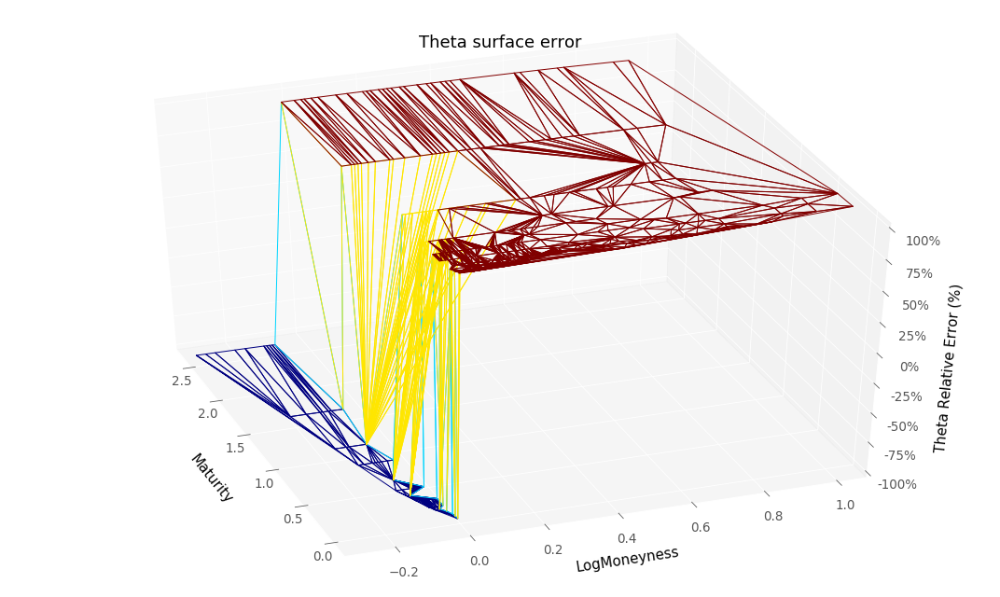

RMSE :  956.081722088642
RMSE Relative:  0.9995710679600706


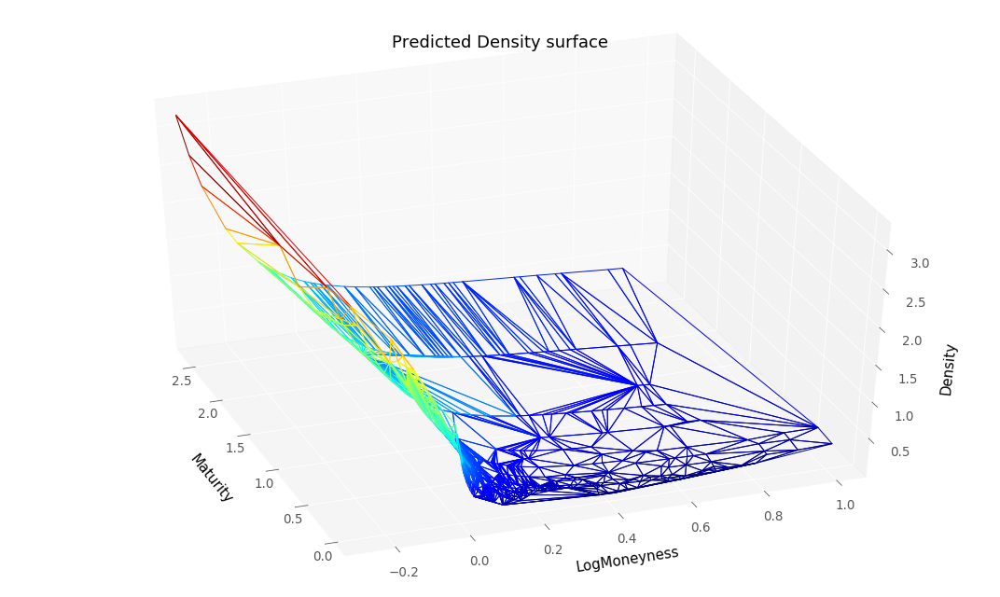

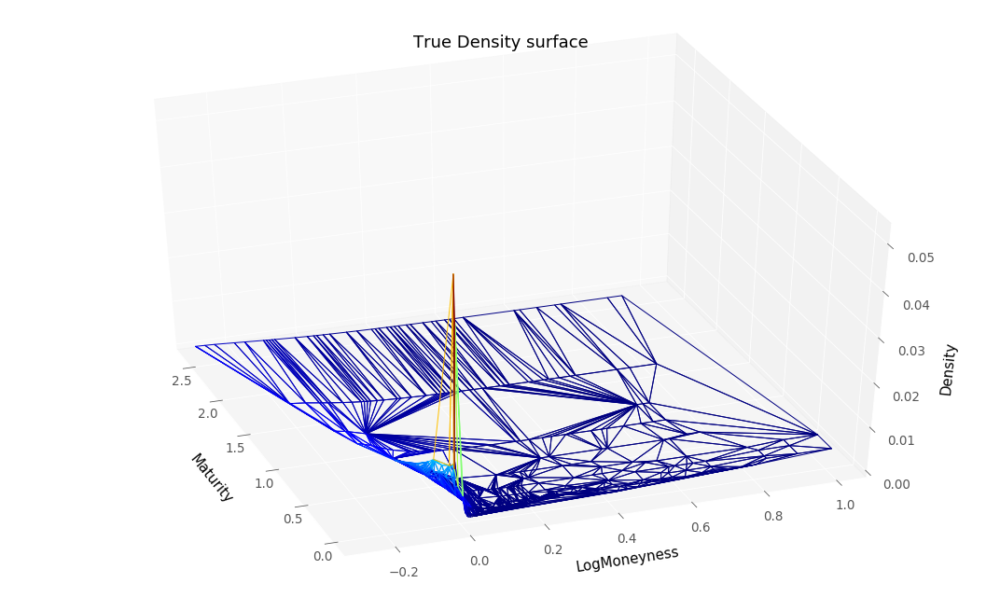

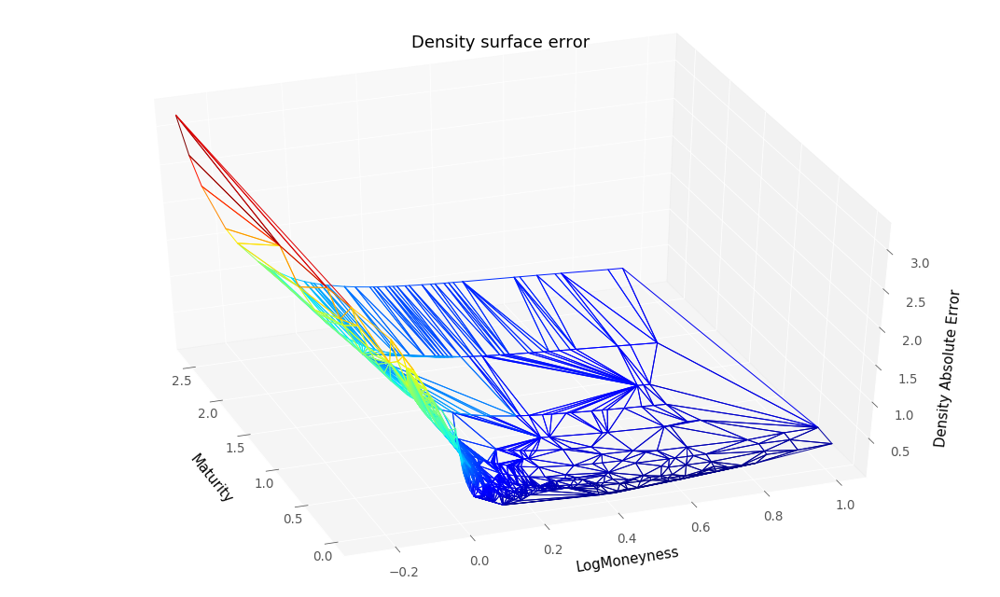

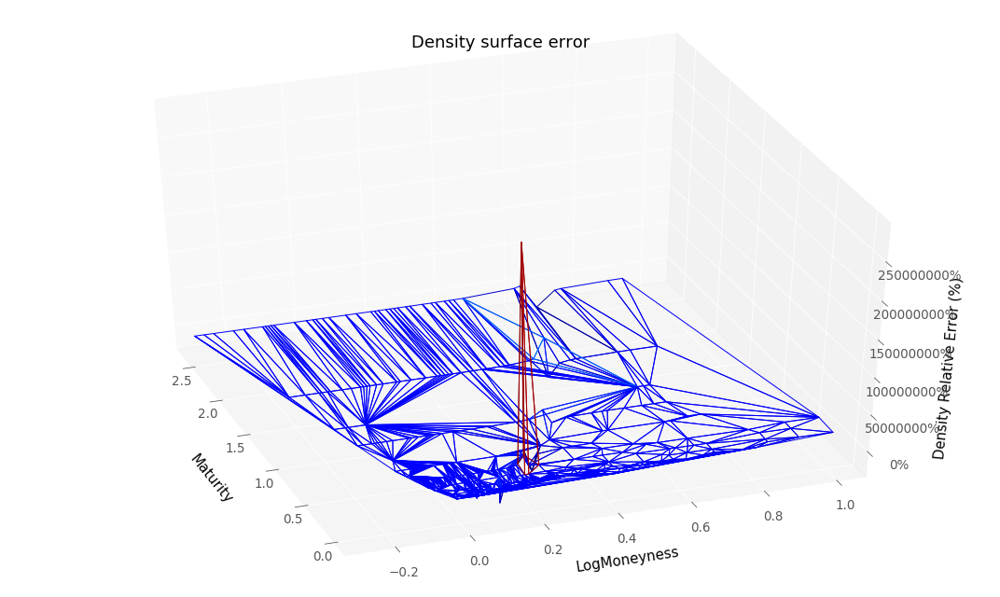

RMSE :  0.708884521855381
RMSE Relative:  118028.07942394428


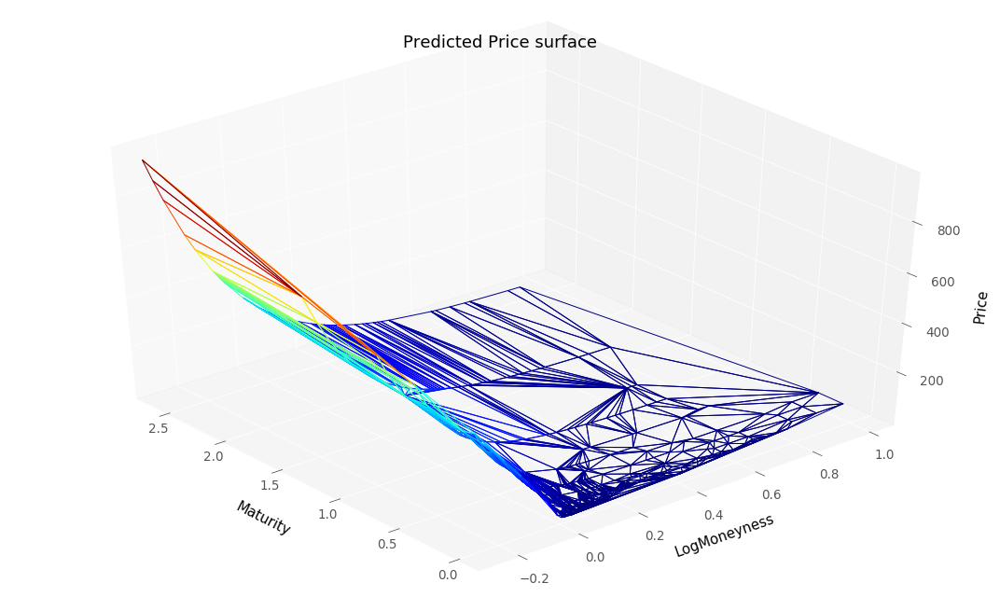

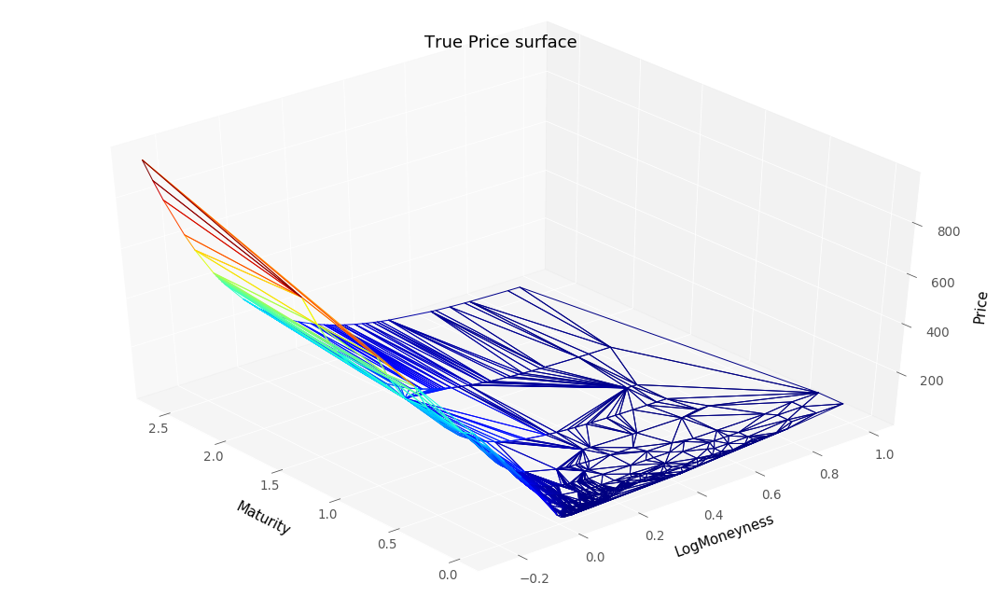

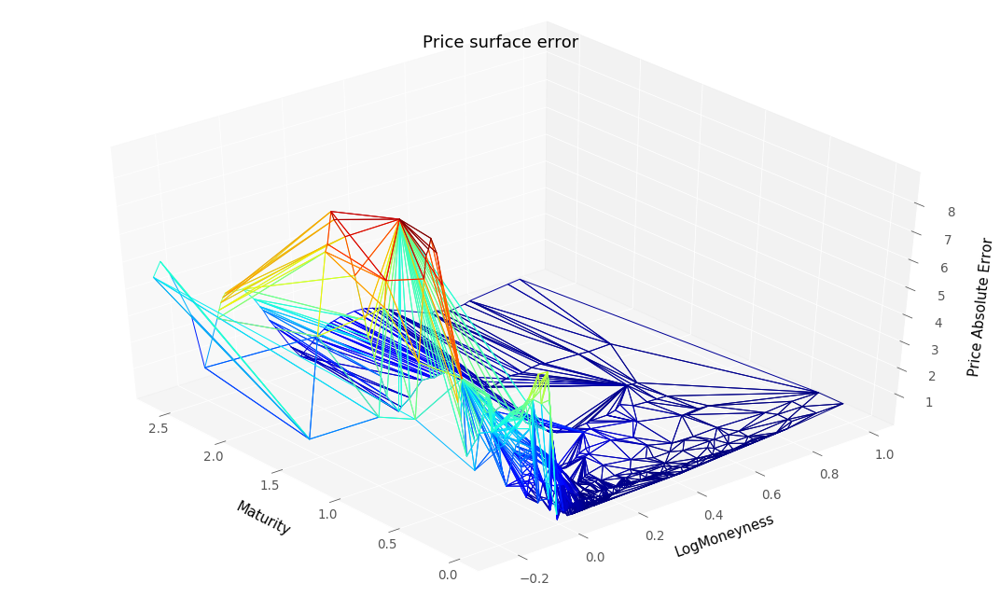

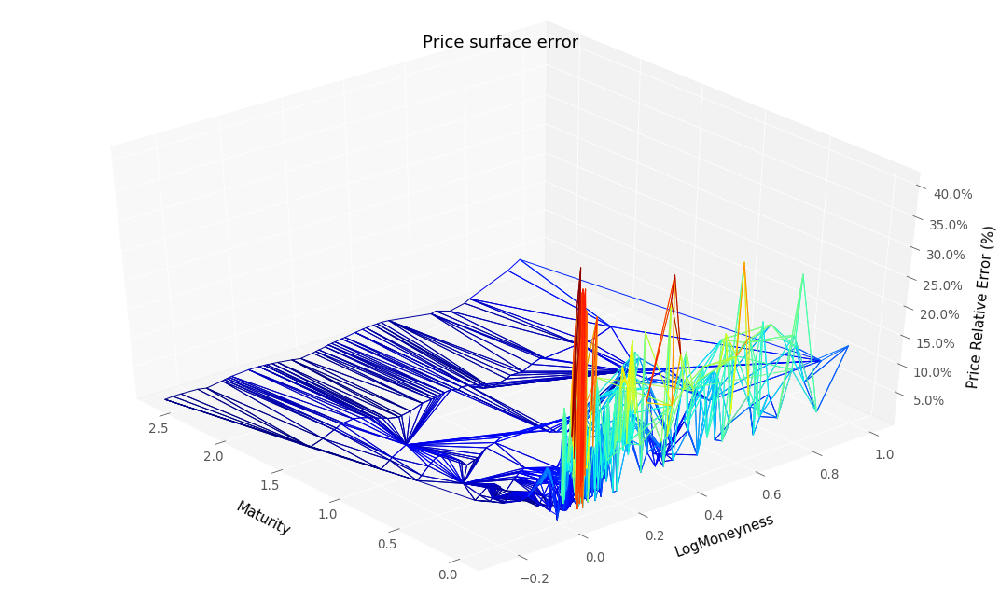

RMSE :  1.7560521899352273
RMSE Relative:  0.09298417162172049


In [12]:
#Diagnosis for training results with logMoneyness scale
plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


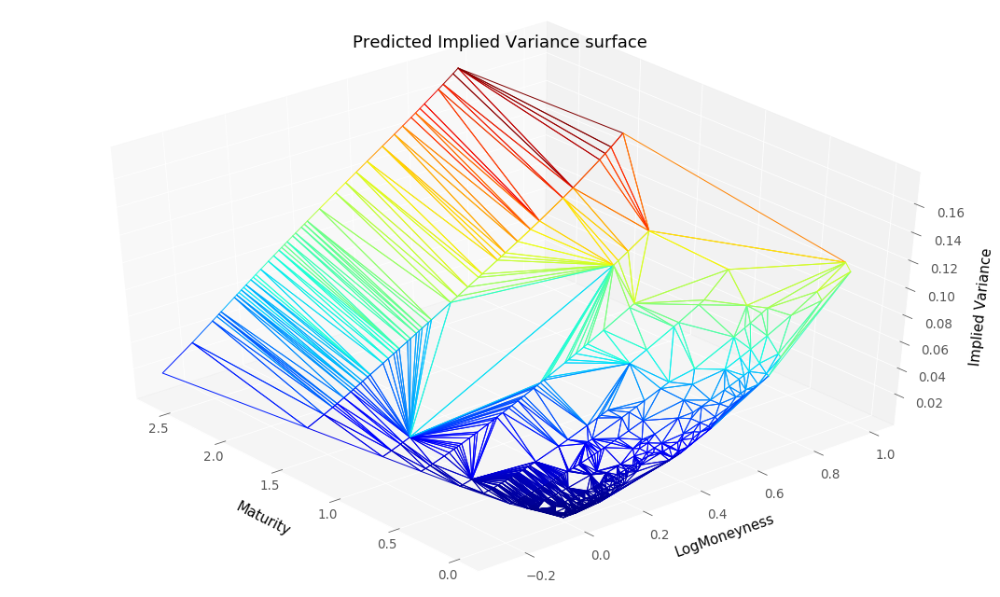

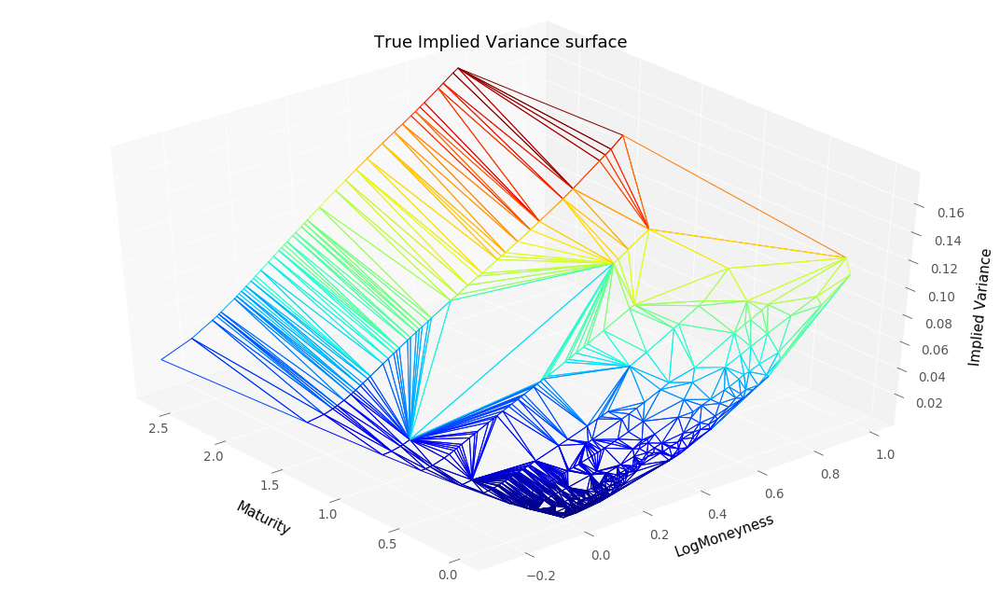

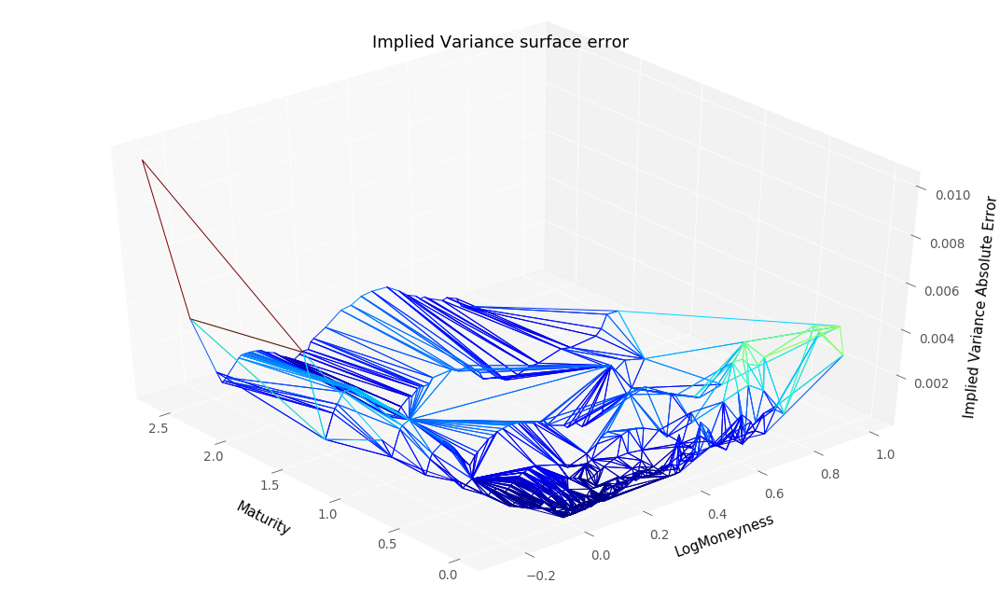

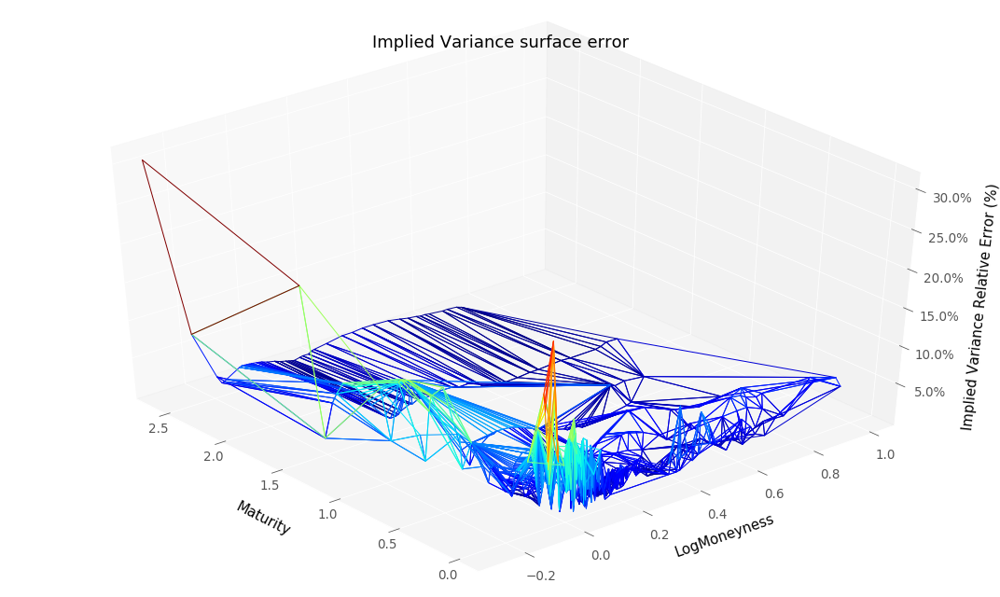

RMSE :  0.0008019517211258276
RMSE Relative:  0.04466581577779356


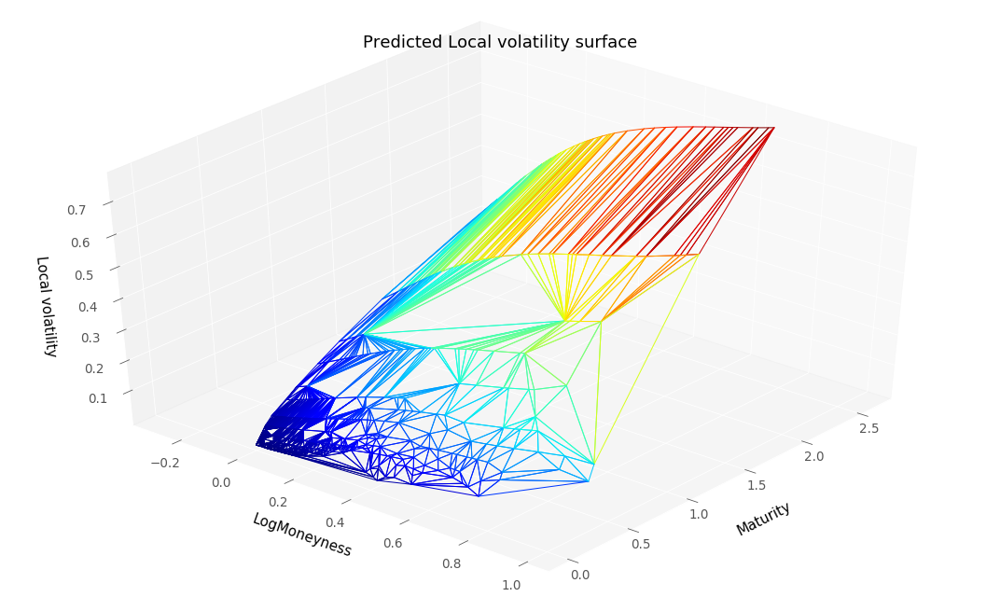

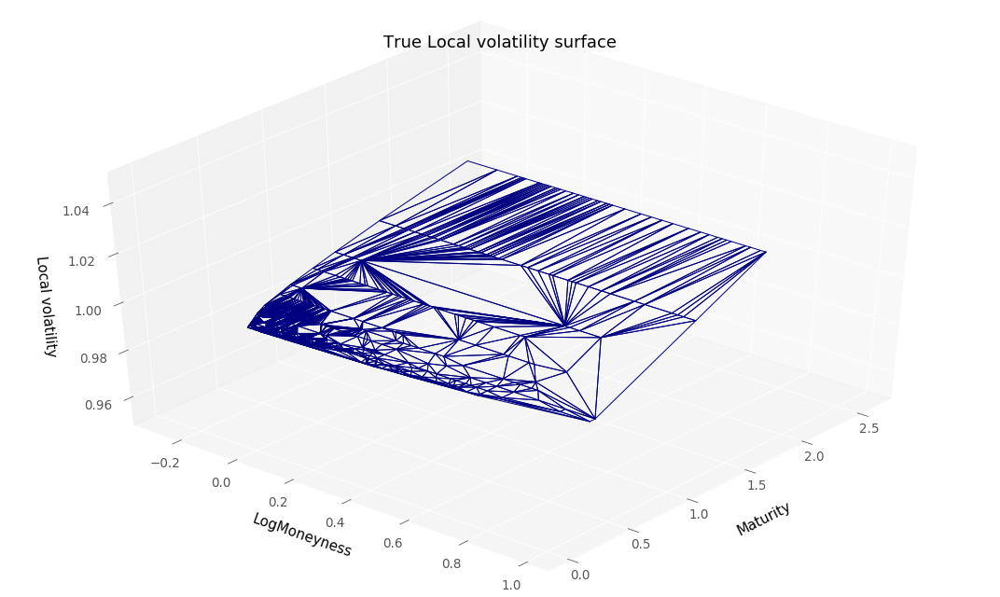

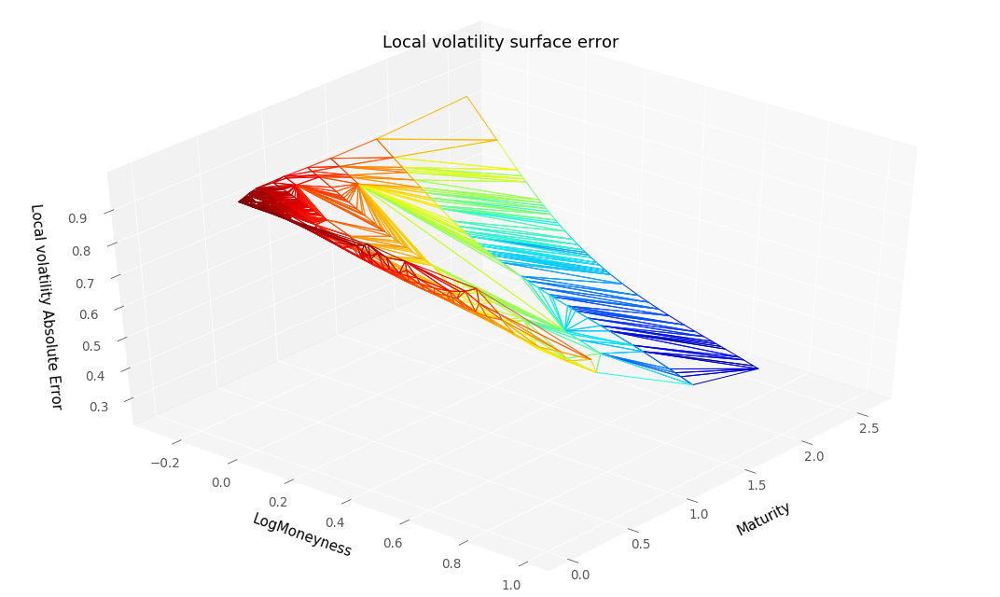

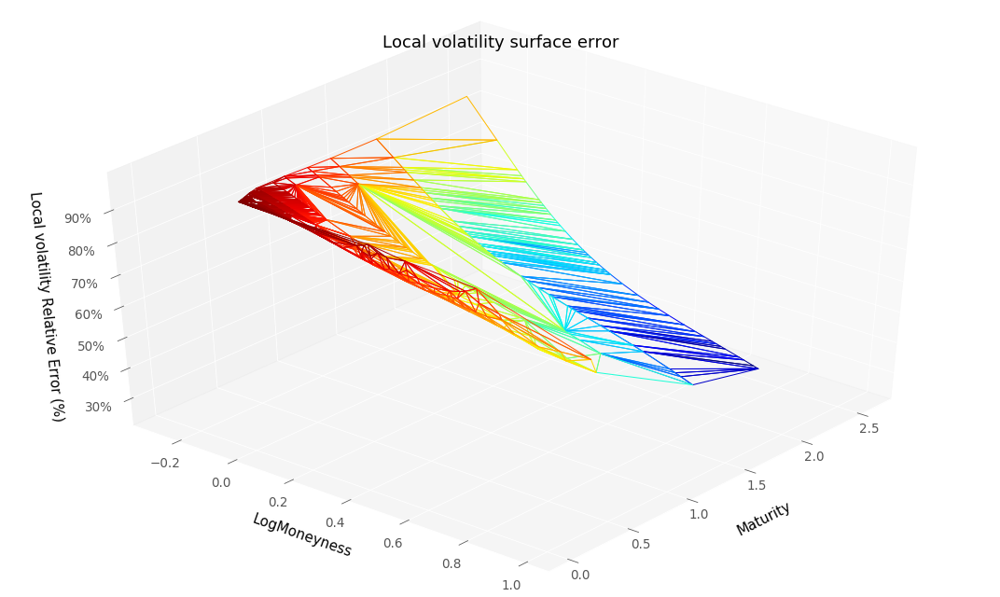

RMSE :  0.8991549079491465
RMSE Relative:  0.8991549079491465


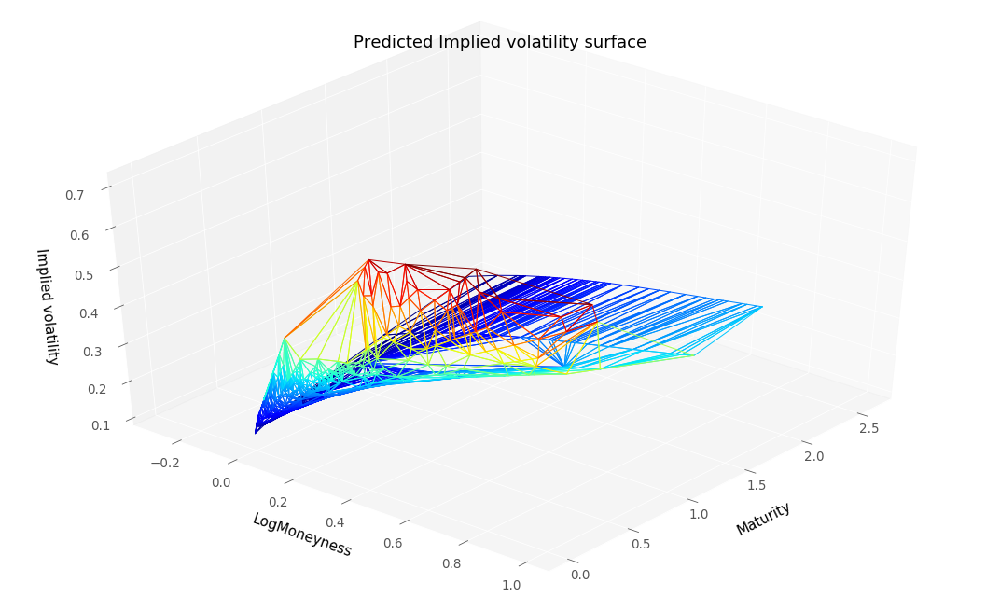

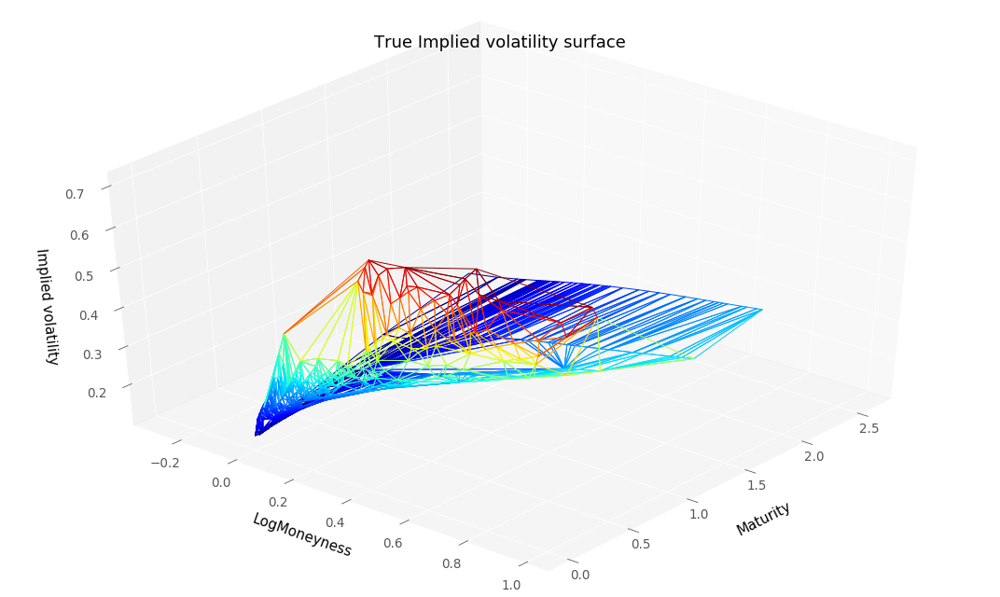

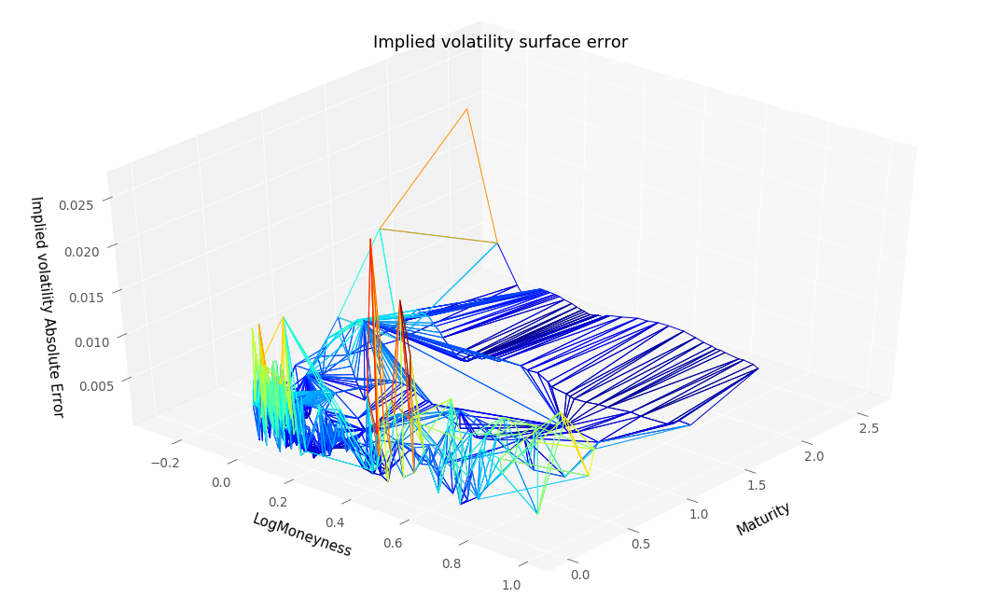

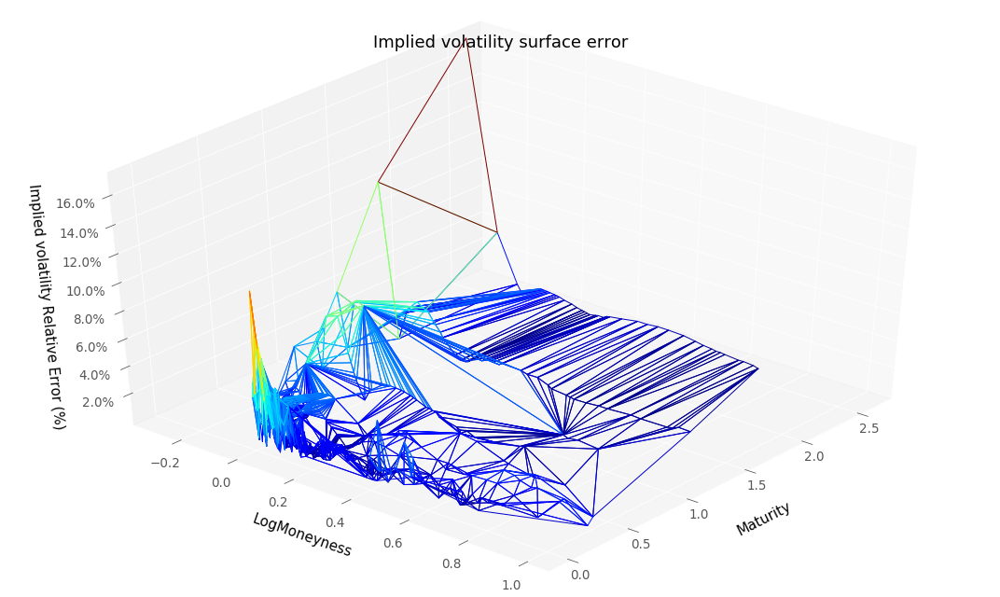

RMSE :  0.004621972748280553
RMSE Relative:  0.02247219681403689


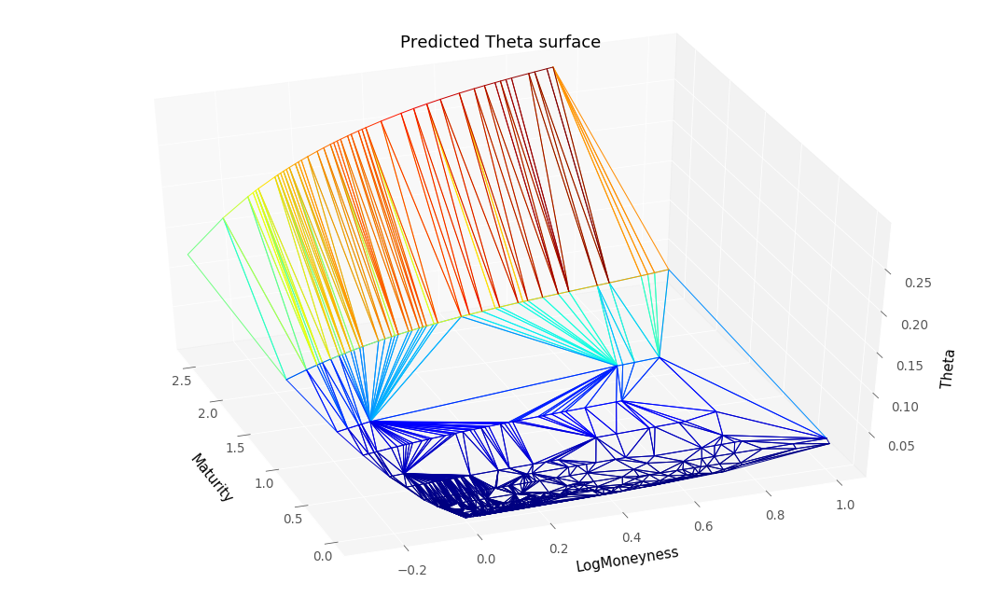

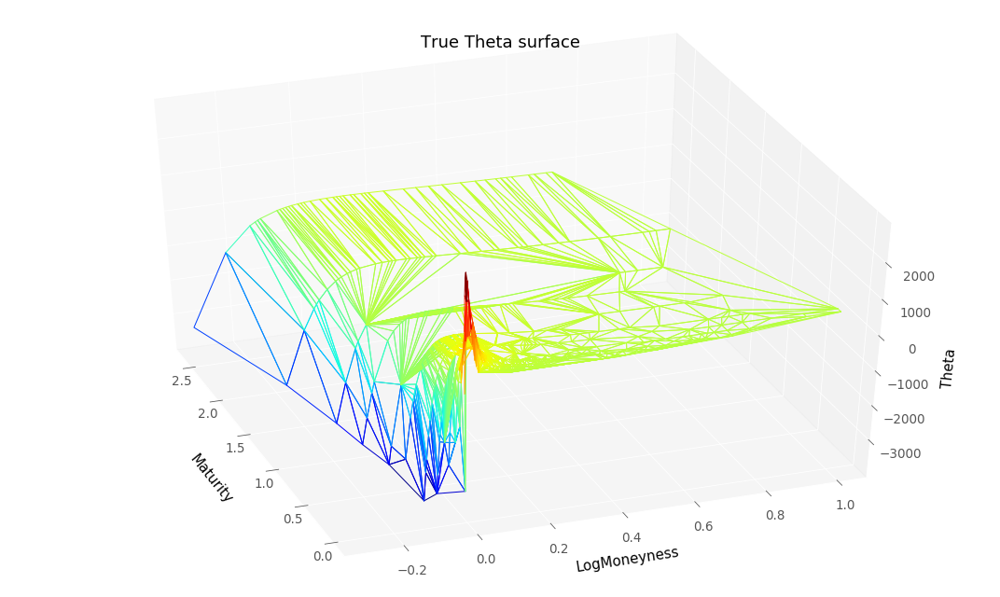

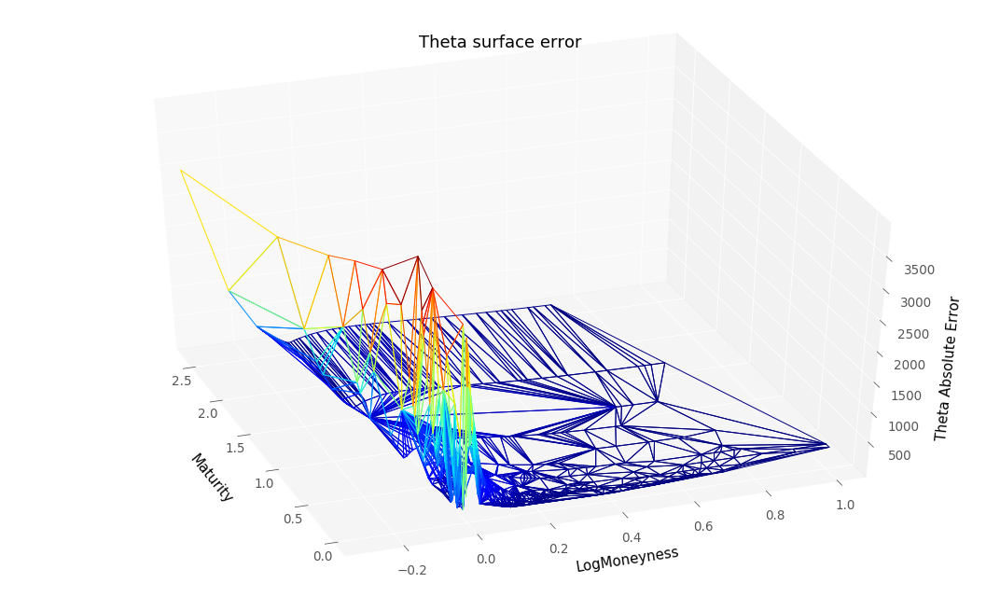

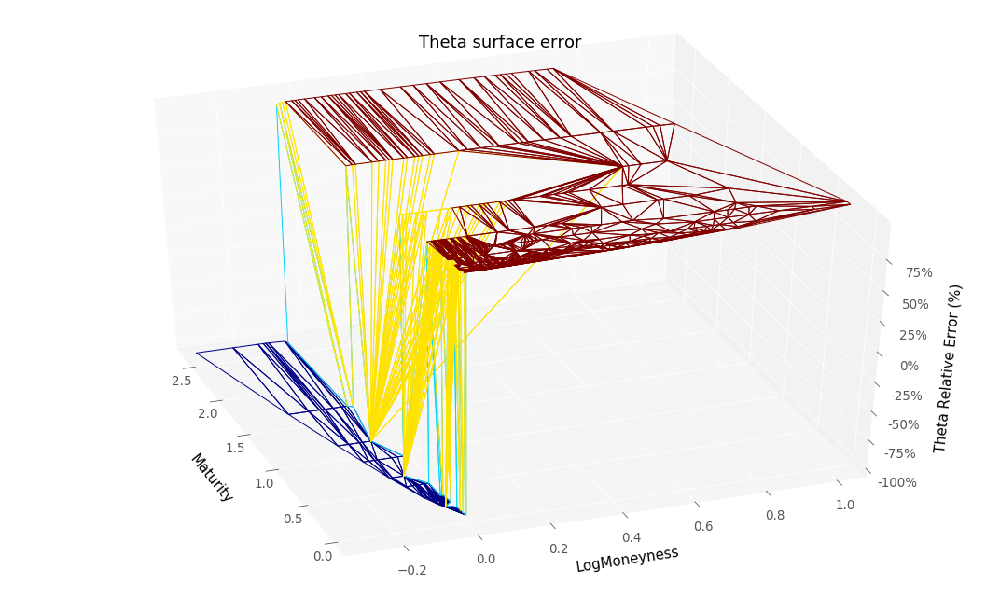

RMSE :  694.9380852101098
RMSE Relative:  0.9996253643369879


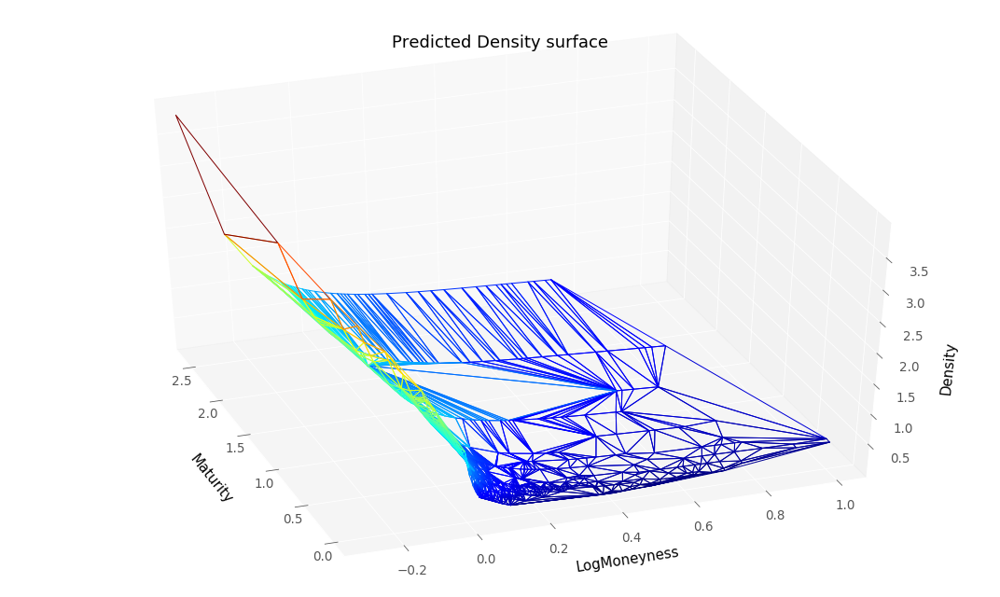

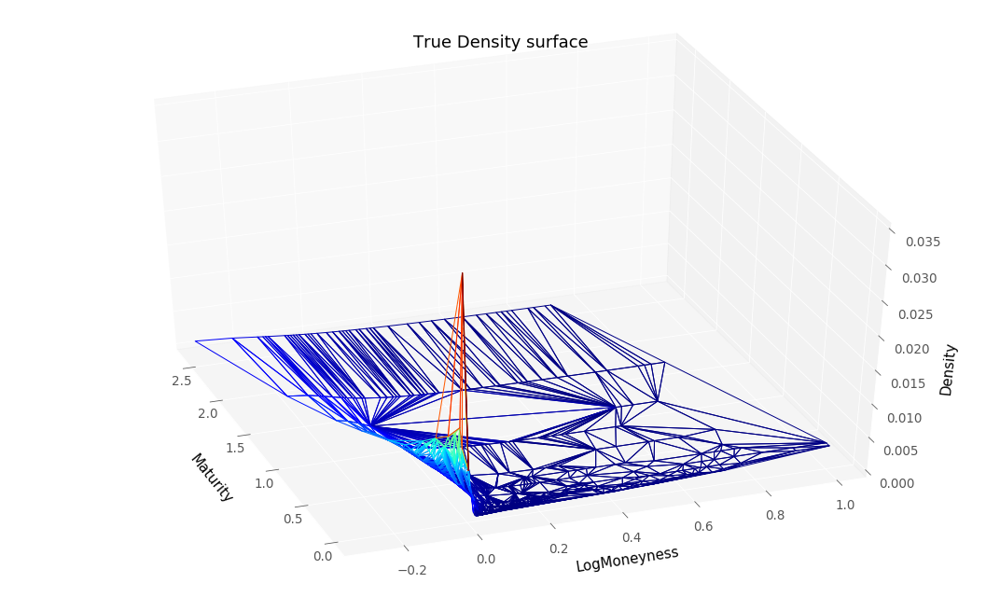

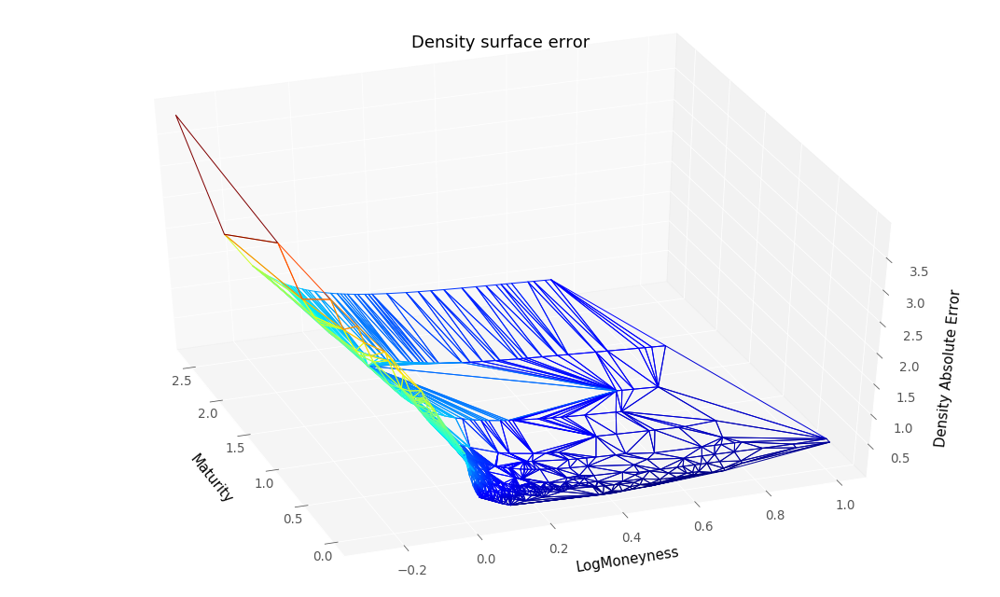

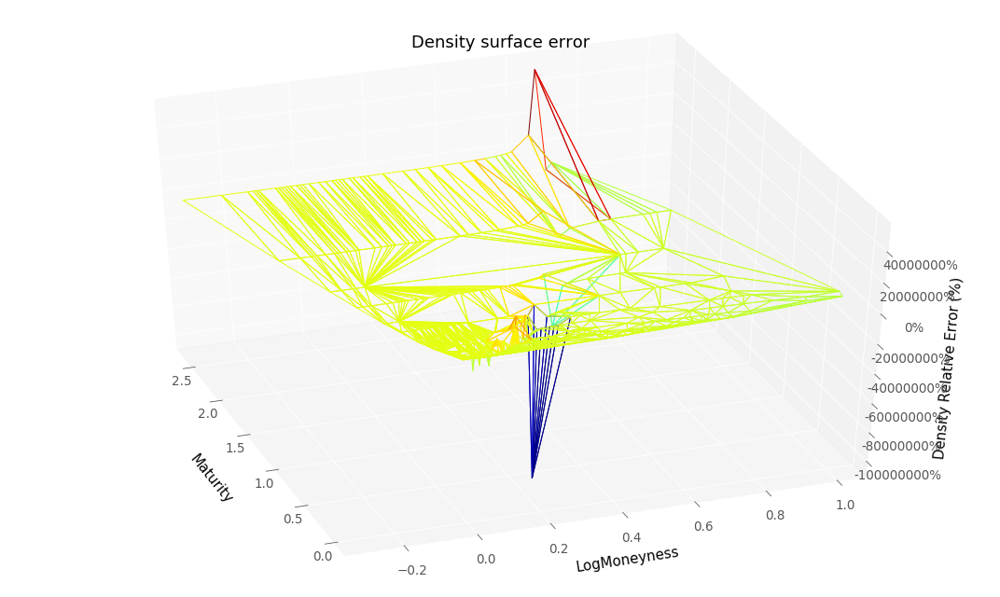

RMSE :  0.7288509235163116
RMSE Relative:  49829.07131909066


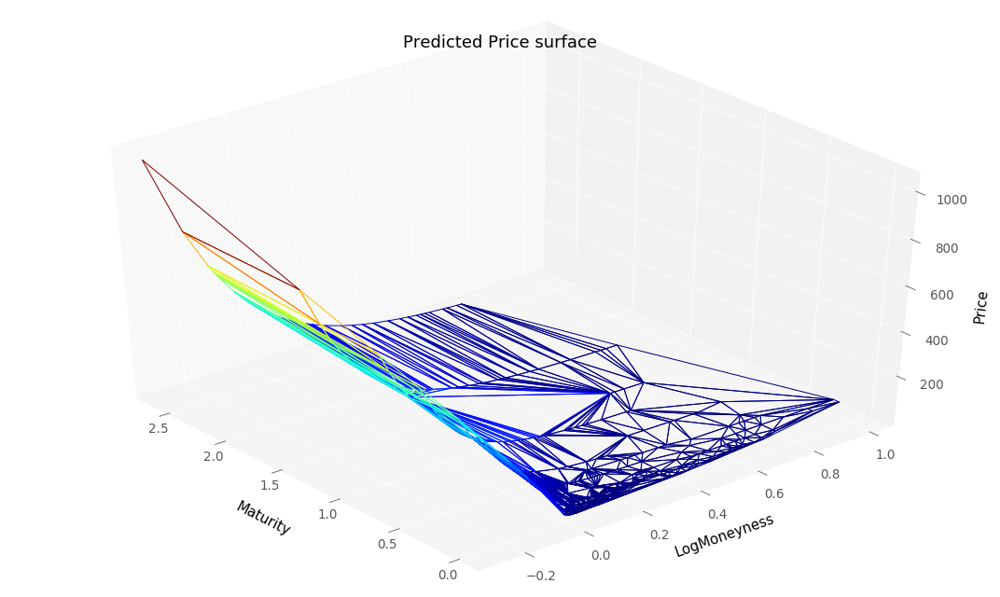

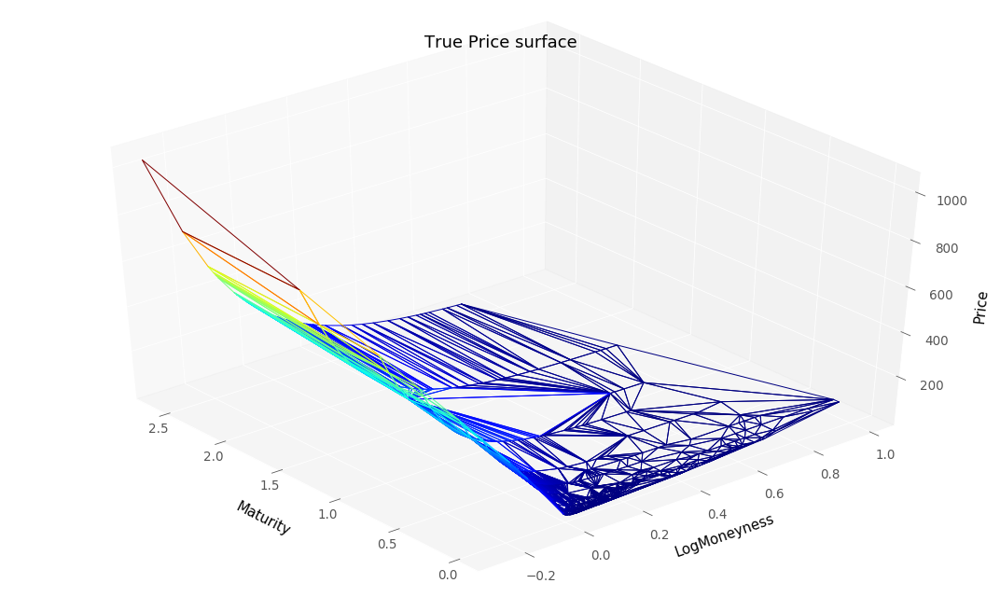

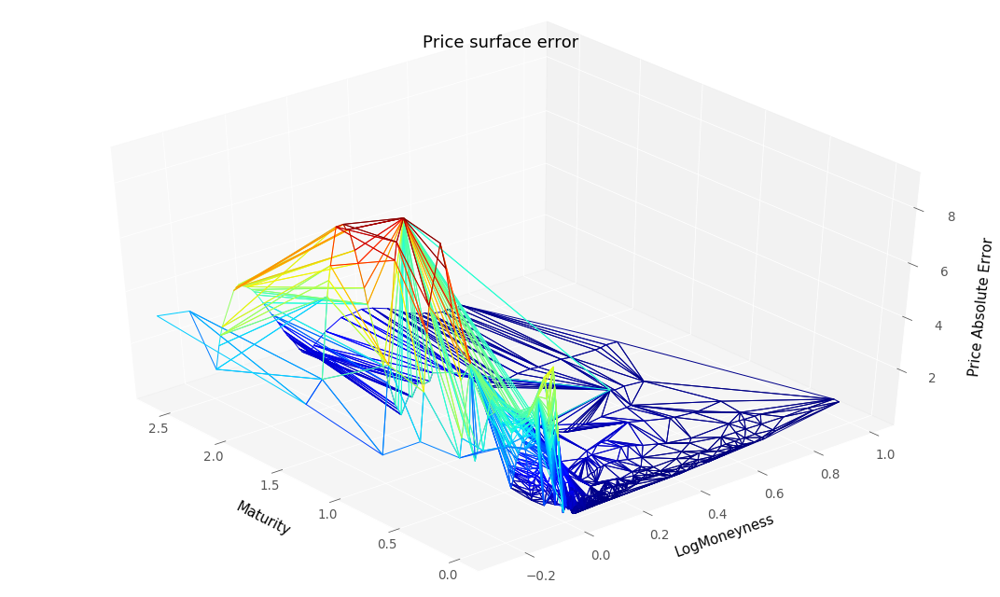

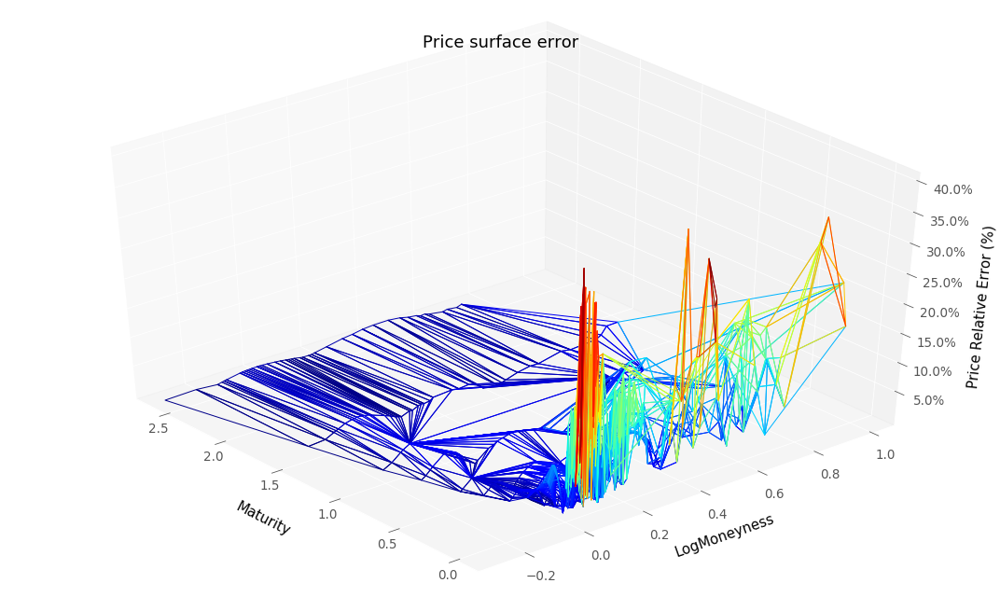

RMSE :  1.777200876397453
RMSE Relative:  0.09470968412932805


In [13]:
#Diagnosis for testing results with logMoneyness scale
plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [14]:
# Function which evaluates neural local volatility when neural network is fitted on implied volatilities
def neuralVolLocaleGatheral(s,t):
    vLoc = neuralNetwork.evalVolLocaleGatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               s, t,
                                               dataSet,
                                               hyperparameters,
                                               scaler,
                                               bootstrap,
                                               S0,
                                               modelName = "convexSoftGatheralVolModel")
    return vLoc.dropna()

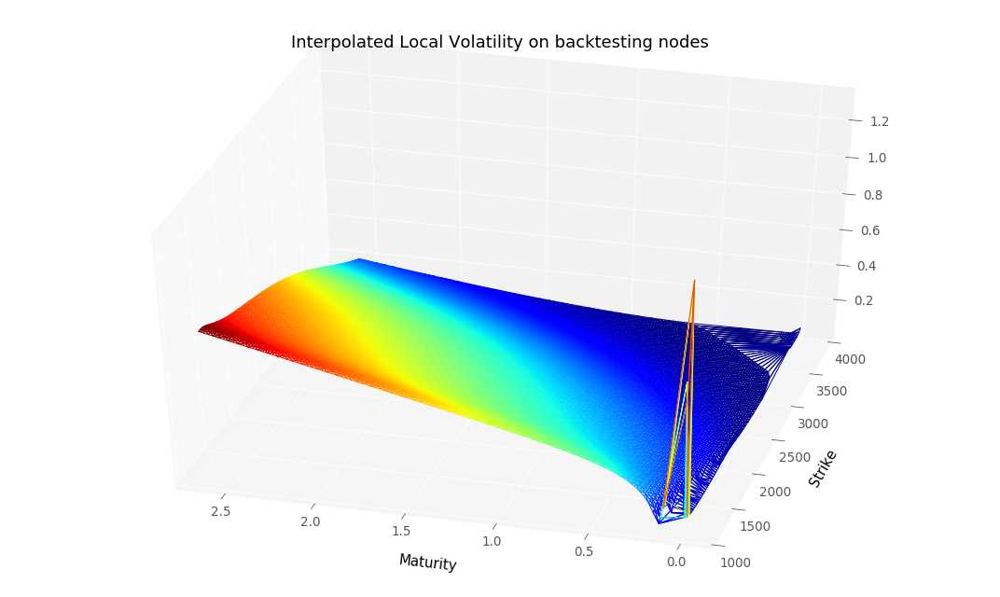

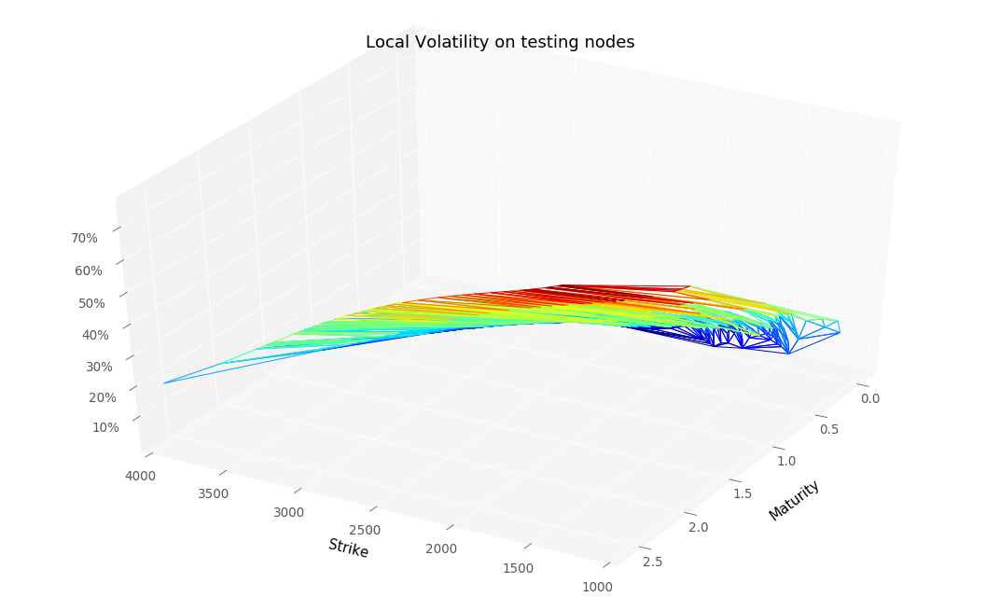

In [15]:
volLocalInterp7 = neuralVolLocaleGatheral(volLocaleGridDf["Strike"].values.flatten(),
                                          volLocaleGridDf["Maturity"].values.flatten())
volLocalInterp8 = neuralVolLocaleGatheral(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                          dataSetTest.index.get_level_values("Maturity").values.flatten())

#Local volatility function for backtests
nnVolLocale7 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp7, x, y)

#Local volatility function for backtests
nnVolLocale8 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp8, x, y)

plotTools.plotSerie(volLocalInterp7,
                    Title = 'Interpolated Local Volatility on backtesting nodes',
                    az=105,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=False)

plotTools.plotSerie(volLocalInterp8,
                    Title = 'Local Volatility on testing nodes',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocale7 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale7)

#Diagnose backtest results
plotTools.predictionDiagnosis(mcResVolLocale7["Price"], 
                              dataSetTest["Price"], 
                              " Monte Carlo Price ", 
                              yMin=KMin,
                              yMax = KMax)

mcResVolLocale7.to_csv("mcResVolLocale7.csv")


In [ ]:
#PDE backtest with a cranck nicholson scheme
pdeResVolLocale7 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale7, bootstrap)

#Backtest diagnosis
plotTools.predictionDiagnosis(pdeResVolLocale7, 
                              dataSetTest["Price"], 
                              " PDE Price ", 
                              yMin=KMin,
                              yMax=KMax)
pdeResVolLocale7.to_csv(workingFolder + "pdeResVolLocale7.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocale8 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale8)
plotTools.predictionDiagnosis(mcResVolLocale8["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)
mcResVolLocale8.to_csv("mcResVolLocale8.csv")



In [ ]:
pdeResVolLocale8 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale8, bootstrap)
plotTools.predictionDiagnosis(pdeResVolLocale8, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)
pdeResVolLocale8.to_csv(workingFolder + "pdeResVolLocale8.csv")

#### NN: Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [ ]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 10#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1000#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10000000#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

In [ ]:
#Execute this cell if you want to fit neural network with prices
res = neuralNetwork.create_train_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       scaledDataSet,
                                       True,
                                       hyperparameters,
                                       scaler,
                                       modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

plotTools.plotEpochLoss(lossSerie4)

In [ ]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSet,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

plotTools.modelSummary(y_pred4,
                       volLocale4, 
                       dNN_T4, 
                       gNN_K4, 
                       dataSet,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTrain")
print("ATM Local Vol :")
print(volLocale4.loc[(midS0,slice(None))])

In [ ]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSetTest,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4Test, volLocale4Test, dNN_T4Test, gNN_K4Test, lossSerie4TestG = res

plotTools.modelSummary(y_pred4Test,
                       volLocale4Test,
                       dNN_T4Test,
                       gNN_K4Test,
                       dataSetTest,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTest")

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

In [ ]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "convexSoftVolModel")
    return vLoc.dropna()

In [ ]:
volLocalInterp = neuralVolLocalePrix(volLocaleGrid[0].flatten(),
                                     volLocaleGrid[1].flatten())

volLocalInterp2 = neuralVolLocalePrix(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                      dataSetTest.index.get_level_values("Maturity").values.flatten())

#Local volatility function for backtests
nnVolLocale = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp, x, y)

#Local volatility function for backtests
nnVolLocale2 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp2, x, y)

plotTools.plotSerie(volLocalInterp,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

plotTools.plotSerie(volLocalInterp2,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocalePrix = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSetTest,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocale)
plotTools.predictionDiagnosis(mcResVolLocalePrix["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)
mcResVolLocalePrix.to_csv("mcResVolLocalePrix.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale, bootstrap)

plotTools.predictionDiagnosis(pdeResVolLocale, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResVolLocale.to_csv(workingFolder + "pdeResVolLocale.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocalePrix2 = backtest.MonteCarloPricerVectorized(S0,
                                                          dataSetTest,
                                                          bootstrap,
                                                          nbPaths,
                                                          nbTimeStep,
                                                          nnVolLocale2)
plotTools.predictionDiagnosis(mcResVolLocalePrix2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)
mcResVolLocalePrix2.to_csv("mcResVolLocalePrix2.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale2, bootstrap)
pdeResVolLocale2.head()
plotTools.predictionDiagnosis(pdeResVolLocale2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)
pdeResVolLocale2.to_csv(workingFolder + "pdeResVolLocale2.csv")

# Hyperparameter selection

In [ ]:
#Random selection of several hyperparameters 
neuralNetwork.selectHyperparametersRandom(hyperparameters,
                                          ["lambdaLocVol","lambdaSoft","lambdaGamma"],
                                          neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                          "hyperParameters",
                                          True, 
                                          100,
                                          scaledDataSet,
                                          scaler,
                                          trainedOnPrice = False,
                                          logGrid = True)

In [ ]:
#hyperparameters["lambdaLocVol"] = 100
#hyperparameters["lambdaSoft"] = 100 
#hyperparameters["lambdaGamma"] = 10000
hyperparameters["lambdaLocVol"] = 0.01#0.01 #100
hyperparameters["lambdaSoft"] = 0.01#10#10 #100 
hyperparameters["lambdaGamma"] = 100#10 #10000

In [ ]:
#marginal selection of hyperparameters
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "DupireVarCap", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["lambdaLocVol"] = 100

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200

## SSVI Backtesting

#### Run SSVI Model

Implementation is inspired from Matlab code of Philipp Rindler : 
- Philipp Rindler (2020). Gatherals and Jacquier's Arbitrage-Free SVI Volatility Surfaces (https://www.mathworks.com/matlabcentral/fileexchange/49962-gatherals-and-jacquier-s-arbitrage-free-svi-volatility-surfaces), MATLAB Central File Exchange. Retrieved November 20, 2020.

In [ ]:
#parameters, theta, maturities, pSSVI = SSVI.train_svi_surface(dataSet, S0)
np.seterr(all='warn')
SSVIModel = SSVI.SSVIModel(S0, bootstrap)
SSVIModel.fit(dataSet)

serie = SSVIModel.eval(dataSetTest)
serieTrain = SSVIModel.eval(dataSet)

In [ ]:
plotTools.predictionDiagnosis(serieTrain , 
                              dataSet["ImpliedVol"], 
                              " Training Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

impPriceTraining = plotTools.plotImpliedVolPrices(np.square(serieTrain)*serieTrain.index.get_level_values("Maturity"),
                                                  bootstrap, 
                                                  S0, 
                                                  dataSet,
                                                  yMin = KMin,
                                                  yMax = KMax, 
                                                  thresholdPrice = None)

ImpVolPutTrainingSSVI = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                                 dataSet["Maturity"], 
                                                                 dataSet["Strike"], 
                                                                 dataSet["OptionType"], 
                                                                 impPriceTraining,
                                                                 removeNaN = False)
ImpVolPutTrainingSSVI = pd.Series(ImpVolPutTrainingSSVI, index = dataSet.index).sort_index()

plotTools.predictionDiagnosis(ImpVolPutTrainingSSVI, 
                              dataSet["ImpliedVol"], 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

plotTools.predictionDiagnosis(ImpVolPutTrainingSSVI, 
                              serieTrain, 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)



In [ ]:
plotTools.predictionDiagnosis(SSVI.impliedVariance(serie), 
                              SSVI.impliedVariance(dataSetTest["ImpliedVol"]), 
                              " Implied total variance ", 
                              yMin=KMin, 
                              yMax=KMax)

plotTools.predictionDiagnosis(serie, 
                              dataSetTest["ImpliedVol"], 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)
threshold = None
impPriceTesting = plotTools.plotImpliedVolPrices(np.square(serie)*serie.index.get_level_values("Maturity"), 
                                                 bootstrap, 
                                                 S0, 
                                                 dataSetTest,
                                                 yMin = KMin,
                                                 yMax = KMax, 
                                                 thresholdPrice = threshold)

ImpVolPutTestingSSVI = BS.vectorizedImpliedVolatilityCalibration(S0, bootstrap, 
                                                                 dataSetTest["Maturity"], 
                                                                 dataSetTest["Strike"], 
                                                                 dataSetTest["OptionType"], 
                                                                 impPriceTesting,
                                                                 removeNaN = False)
ImpVolPutTestingSSVI = pd.Series(ImpVolPutTestingSSVI, index = dataSetTest.index).sort_index()

plotTools.predictionDiagnosis(ImpVolPutTestingSSVI, 
                              dataSetTest["ImpliedVol"], 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

#### Estimate Local Volaitlity from SSVI

In [ ]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dTTrain, hkTrain, dKTrain, locVolSSVITrain, densityTrain = SSVI.finiteDifferenceSVI(dataSet, SSVIModel.eval)

In [ ]:
plotTools.diagnoseLocalVol(dTTrain,
                           locVolSSVITrain,
                           densityTrain,
                           SSVIModel.eval(dataSet),
                           dataSet,
                           az=320,
                           yMin=KMin,
                           yMax=KMax)

In [ ]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(dataSetTest, SSVIModel.eval)

In [ ]:
plotTools.diagnoseLocalVol(dT,
                           locVolSSVI,
                           density,
                           SSVIModel.eval(dataSetTest),
                           dataSetTest,
                           az=320,
                           yMin=KMin,
                           yMax=KMax)

In [ ]:
plotTools.saveDataModel(plotTools.removeDuplicateIndex(impPriceTraining), 
                        plotTools.removeDuplicateIndex(locVolSSVITrain), 
                        plotTools.removeDuplicateIndex(serieTrain) , 
                        "./Results/SSVITraining") 
plotTools.saveDataModel(plotTools.removeDuplicateIndex(impPriceTesting), 
                        plotTools.removeDuplicateIndex(locVolSSVI), 
                        plotTools.removeDuplicateIndex(serie) , 
                        "./Results/SSVITesting") 

In [ ]:
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(volLocaleGridDf, SSVIModel.eval)

plotTools.plotSerie(locVolSSVI.dropna(),
                    yMin=KMin,
                    yMax=KMax, 
                    az=105,
                    Title = 'SSVI Local volatility')

plotTools.plotSerie(locVolSSVI.dropna()[locVolSSVI.dropna() <= 1.0],
                    yMin=KMin,
                    yMax=KMax, 
                    az=105,
                    Title = 'Filtered SSVI Local volatility')

In [ ]:
plotTools.plot2dSmiles(SSVIResults,
                       GPResults,
                       NeuralResults,
                       concatDf,
                       plotMarketData = False,
                       nbObservationThreshold = 5)

#### Backtest Local volatility SSVI 

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [ ]:
nbTimeStep = 100
nbPaths = 100

In [ ]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT, hk, dK, locVolSSVI, density = SSVI.finiteDifferenceSVI(dataSetTest, SSVIModel.eval)
nnSSVI = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolSSVI, x, y)

#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT2, hk2, dK2, locVolSSVI2, density2 = SSVI.finiteDifferenceSVI(volLocaleGridDf, SSVIModel.eval)
cleanValue = ~(dT2.isna() | density2.isna() | (dT2 < 0) | (density2 < 0) )
dT2 = dT2[cleanValue.values]
density2 = density2[cleanValue.values]
hk2 = hk2[cleanValue.values]
locVolSSVI2 = locVolSSVI2[cleanValue.values]
dK2 = dK2[cleanValue.values]

nnSSVI2 = lambda x,y : backtest.interpolatedMCLocalVolatility(locVolSSVI2, x, y)

In [ ]:
mcResSSVITest = backtest.MonteCarloPricerVectorized(S0,
                                                    dataSetTest,
                                                    bootstrap,
                                                    nbPaths,
                                                    nbTimeStep,
                                                    nnSSVI)
mcResSSVITest.to_csv(workingFolder + "mcResSSVITest.csv")

plotTools.predictionDiagnosis(mcResSSVITest["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResSigmaSSVITest = backtest.PDEPricerVectorized(dataSetTest, S0, nnSSVI, bootstrap)

plotTools.predictionDiagnosis(pdeResSigmaSSVITest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResSigmaSSVITest.to_csv(workingFolder + "pdeResSigmaSSVITest.csv")

In [ ]:
mcResSSVITest2 = backtest.MonteCarloPricerVectorized(S0,
                                                     dataSetTest,
                                                     bootstrap,
                                                     nbPaths,
                                                     nbTimeStep,
                                                     nnSSVI2)

plotTools.predictionDiagnosis(mcResSSVITest2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

mcResSSVITest2.to_csv(workingFolder + "mcResSSVITest2.csv")

In [ ]:
pdeResSigmaSSVITest2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnSSVI2, bootstrap)

plotTools.predictionDiagnosis(pdeResSigmaSSVITest2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResSigmaSSVITest2.to_csv(workingFolder + "pdeResSigmaSSVITest2.csv")

## Trinomial Tree (Tikhonov)

### MC backtest 

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

For the tikhonov case we only use one grid which contains the node of the trinomial tree used for the calibration algorithm. See CREPEY, Stéphane. Calibration of the local volatility in a trinomial tree using Tikhonov regularization. Inverse Problems, 2002, vol. 19, no 1, p. 91.

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

#### Tikhonov calibration

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
nnVolLocaleTykhonov = lambda x,y : backtest.interpolatedMCLocalVolatility(localVolatility["LocalVolatility"], x, y)

s = testingDataSetAresky.index.get_level_values("Strike").values
t = testingDataSetAresky.index.get_level_values("Maturity").values
tikhonovLocVol = nnVolLocaleTykhonov(s, t)

plotTools.plotSerie(tikhonovLocVol[tikhonovLocVol.index.get_level_values("Maturity") > 0.01],
                    Title = 'Tikhonov Local Volatility Surface',
                    az=30,
                    yMin=0.0*S0,
                    yMax=2.0*S0, 
                    zAsPercent=True)

mcResTikhonovTest = backtest.MonteCarloPricerVectorized(S0,
                                                        dataSetTest,
                                                        bootstrap,
                                                        nbPaths,
                                                        nbTimeStep,
                                                        nnVolLocaleTykhonov)

plotTools.predictionDiagnosis(mcResTikhonovTest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

mcResTikhonovTest.to_csv(workingFolder + "mcResTikhonovTest.csv")

In [ ]:
mcResTikhonovTrain = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSet,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocaleTykhonov)

plotTools.predictionDiagnosis(mcResTikhonovTrain, 
                              dataSet["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

mcResTikhonovTrain.to_csv(workingFolder + "mcResTikhonovTrain.csv")

In [ ]:
pdeResSigmaTikhonovTrain = backtest.PDEPricerVectorized(dataSet, S0, nnVolLocaleTykhonov, bootstrap)
pdeResSigmaTikhonovTrain.head()

plotTools.predictionDiagnosis(pdeResSigmaTikhonovTrain, 
                              dataSet["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResSigmaTikhonovTrain.to_csv(workingFolder + "pdeResSigmaTikhonovTrain.csv")

In [ ]:
pdeResSigmaTikhonovTest = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocaleTykhonov, bootstrap)
pdeResSigmaTikhonovTest.head()

plotTools.predictionDiagnosis(pdeResSigmaTikhonovTest, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

pdeResSigmaTikhonovTest.to_csv(workingFolder + "pdeResSigmaTikhonovTest.csv")

# Backtest Result Comparisons

In [ ]:
importlib.reload(backtest)

In [ ]:
mcResGPTest = backtest.loadMCPrices("./Results/mcResGPTest.csv", 
                                    parseHeader=0)
mcResGPTest.head()

In [ ]:
mcResSSVITest = backtest.loadMCPrices("./Results/mcResSSVITest.csv", 
                                      parseHeader=0)
mcResSSVITest.head()

In [ ]:
backtest.rmse(mcResGPTest["Price"], mcResSSVITest["Price"])

In [ ]:
pdeResSigmaGPTest = backtest.loadMCPrices("./Results/pdeResSigmaGPTest.csv")
pdeResSigmaGPTest.head()

# Compare Implied Volatility and ignore miscalibrated implied volatilities

This section removes nodes where implied volatility estimation is impossible for some models (GP, NN Price).
This allow a fair comparison of implied volatility for model.

In [ ]:
#Detecting options which lead to implied volatilities miscalibration
gpImpVolTraining = pd.Series(pd.read_csv("./Results" + "/GPTraining.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                             index = plotTools.removeDuplicateIndex(dataSet).index)
gpImpVolTesting = pd.Series(pd.read_csv("./Results" + "/GPTesting.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                            index = plotTools.removeDuplicateIndex(dataSetTest).index)
nnImpVolTraining = pd.Series(pd.read_csv("./Results" + "/NeuralPriceTrain.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                             index = plotTools.removeDuplicateIndex(dataSet).index)
nnImpVolTesting = pd.Series(pd.read_csv("./Results" + "/NeuralPriceTest.csv").set_index(["Strike","Maturity"])["ImpliedVol"],
                            index = plotTools.removeDuplicateIndex(dataSetTest).index)

In [ ]:
gpImpVolTrainingError = gpImpVolTraining[gpImpVolTraining <= 1e-9].append(gpImpVolTraining[gpImpVolTraining >= 2])
nnImpVolTrainingError = nnImpVolTraining[nnImpVolTraining <= 1e-9].append(nnImpVolTraining[nnImpVolTraining >= 2])
trainingFilterImpVol = gpImpVolTrainingError.append(nnImpVolTrainingError).index.unique()

gpImpVolTestingError = gpImpVolTesting[gpImpVolTesting <= 1e-9].append(gpImpVolTesting[gpImpVolTesting >= 2])
nnImpVolTestingError = nnImpVolTesting[nnImpVolTesting <= 1e-9].append(nnImpVolTesting[nnImpVolTesting >= 2])
testingFilterImpVol = gpImpVolTestingError.append(nnImpVolTestingError).index.unique()

In [ ]:
#Load results from another model
dfModelTraining = pd.read_csv("./Results" + "/NeuralImpliedVolTrain.csv").set_index(["Strike","Maturity"])
dfModelTraining = pd.DataFrame(dfModelTraining.values, 
                               index = plotTools.removeDuplicateIndex(dataSet).index,
                               columns = dfModelTraining.columns)

keptVols = dataSet["ImpliedVol"].drop(trainingFilterImpVol).index
plotTools.predictionDiagnosis(plotTools.selectIndex(dfModelTraining["ImpliedVol"], keptVols) , 
                              plotTools.selectIndex(dataSet["ImpliedVol"], keptVols) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
dfModelTesting = pd.read_csv("./Results" + "/NeuralImpliedVolTest.csv").set_index(["Strike","Maturity"])
dfModelTesting = pd.DataFrame(dfModelTesting.values, 
                              index = plotTools.removeDuplicateIndex(dataSetTest).index,
                              columns = dfModelTesting.columns)

keptVols = dataSetTest["ImpliedVol"].drop(testingFilterImpVol).index
plotTools.predictionDiagnosis(plotTools.selectIndex(dfModelTesting["ImpliedVol"], keptVols) , 
                              plotTools.selectIndex(dataSetTest["ImpliedVol"], keptVols) , 
                              " Implied vol ", 
                              yMin=KMin,
                              yMax=KMax)